In [1]:
!conda install -c conda-forge gdcm -y

Solving environment: \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - \ | / - done

## Package Plan ##

  environment location: /opt/conda

  added / updated specs:
    - gdcm


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    conda-4.8.5                |   py37hc8dfbb8_1         3.0 MB  conda-forge
    gdcm-2.8.9                 |   py37h71b2a6d_0         3.4 MB  conda-forge
    libjpeg-turbo-2.0.3        |       h516909a_1        1022 KB  conda-forge
    openssl-1.1.1g             |       h516909a_1         2.1 MB  conda-forge
    ------------------------------------------------------------
                                           Total:         9.6 MB

The following NEW pa

In [2]:
import warnings
warnings.filterwarnings('ignore')
import tqdm
import os
import gc

import numpy as np
import pandas as pd
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

from scipy.stats import probplot, mode, linregress

import matplotlib.pyplot as plt
import matplotlib.animation as animation
import seaborn as sns
from IPython.display import HTML

import gdcm
import pydicom
import cv2

In [3]:
df_train = pd.read_csv('../input/osic-pulmonary-fibrosis-progression/train.csv')
df_test = pd.read_csv('../input/osic-pulmonary-fibrosis-progression/test.csv')

print(f'Training Set Shape = {df_train.shape} - Patients = {df_train["Patient"].nunique()}')
print(f'Training Set Memory Usage = {df_train.memory_usage().sum() / 1024 ** 2:.2f} MB')
print(f'Test Set Shape = {df_test.shape} - Patients = {df_test["Patient"].nunique()}')
print(f'Test Set Memory Usage = {df_test.memory_usage().sum() / 1024 ** 2:.2f} MB')

Training Set Shape = (1549, 7) - Patients = 176
Training Set Memory Usage = 0.08 MB
Test Set Shape = (5, 7) - Patients = 5
Test Set Memory Usage = 0.00 MB


## **1. Introduction**

### **1.1. Training Set**

There are **1549** samples in `train.csv` and they belong to **176** different patients. All of the patients have their images acquired at Week 0, but all of the patients don't have FVC measured at Week 0 and their number of FVC measurements change from patient to patient.

Most of the patients have FVC measurements at 9 different timesteps but this number can change between 6 and 10. Thus, number of FVC measurements are not consistent for different patients.

In [4]:
training_sample_counts = df_train.rename(columns={'Weeks': 'Samples'}).groupby('Patient').agg('count')['Samples'].value_counts()
print(f'Training Set FVC Measurements Per Patient \n{("-") * 41}\n{training_sample_counts}')

Training Set FVC Measurements Per Patient 
-----------------------------------------
9     132
8      25
10     10
7       7
6       2
Name: Samples, dtype: int64


### **1.2. Test Set**

There are **5** samples in `test.csv` and they belong to **5** different patients. Those samples and patients also exist in `train.csv`. They are the last 5 patients of training set and the samples are first measurements of those patients. This is because `test.csv` is a placeholder and the real test set is hidden. The purpose of placeholder test set is showing the structure of real test set and testing submissions. When the notebook is submitted, it runs with the real test set.

The real test set will have more than 5 patients. However, it will only have a baseline CT scan and only the initial FVC measurement. You are asked to predict the final three FVC measurements for each patient, as well as a confidence value in your prediction. In order to avoid potential leakage, you are asked to predict every patient's FVC measurement for every possible week. Weeks prior to final three weeks are ignored in scoring.

In [5]:
df_test

,Patient,Weeks,FVC,Percent,Age,Sex,SmokingStatus
0,ID00419637202311204720264,6,3020,70.186855,73,Male,Ex-smoker
1,ID00421637202311550012437,15,2739,82.045291,68,Male,Ex-smoker
2,ID00422637202311677017371,6,1930,76.672493,73,Male,Ex-smoker
3,ID00423637202312137826377,17,3294,79.258903,72,Male,Ex-smoker
4,ID00426637202313170790466,0,2925,71.824968,73,Male,Never smoked


### **1.3. Sample Submission**

The simplest way of creating submissions is predicting `FVC` and `Confidence` for all test samples, then creating `Patient_Week` on test set and merging it to `sample_submission.csv`. This way submission file will have all of the predictions from test set regardless of their count. 

In [6]:
df_submission = pd.read_csv( '../input/osic-pulmonary-fibrosis-progression/sample_submission.csv' )
df_submission

,Patient_Week,FVC,Confidence
0,ID00419637202311204720264_-12,2000,100
1,ID00421637202311550012437_-12,2000,100
2,ID00422637202311677017371_-12,2000,100
3,ID00423637202312137826377_-12,2000,100
4,ID00426637202313170790466_-12,2000,100
...,...,...,...
725,ID00419637202311204720264_133,2000,100
726,ID00421637202311550012437_133,2000,100
727,ID00422637202311677017371_133,2000,100
728,ID00423637202312137826377_133,2000,100


## **2. Laplace Log Likelihood**

Predictions are evaluated with a modified version of the Laplace Log Likelihood. For each sample in test set, an `FVC` and a `Confidence` measure (standard deviation σ) has to be predicted.

`Confidence` values smaller than 70 are clipped.

$\large \sigma_{clipped} = max(\sigma, 70),$

Errors greater than 1000 are also clipped in order to avoid large errors.

$\large \Delta = min ( |FVC_{true} - FVC_{predicted}|, 1000 ),$

The metric is defined as:

$\Large metric = -   \frac{\sqrt{2} \Delta}{\sigma_{clipped}} - \ln ( \sqrt{2} \sigma_{clipped} ).$

The metric is implemented below and theoretical minimum score is calculated. If everything is predicted perfectly (`Delta = 0`) with the highest confidence (`Sigma = 70`), the score will be `-4.595068832329223`.

In [7]:
def laplace_log_likelihood(y_true, y_pred, sigma):
    sigma_clipped = np.maximum(sigma, 70)
    delta_clipped = np.minimum(np.abs(y_true - y_pred), 1000)
    score = - np.sqrt(2) * delta_clipped / sigma_clipped - np.log(np.sqrt(2) * sigma_clipped)
    return np.mean(score)

laplace_log_likelihood(df_train['FVC'], df_train['FVC'], 70)

-4.595068832329223

## **3. FVC (Forced Vital Capacity)**

`FVC` measurement shows the amount of air a person can forcefully and quickly exhale after taking a deep breath. It is defined as `the recorded lung capacity in ml` under the Data tab. The change in `FVC` over the course of weeks is used for predicting the patients' lung function decline.

Even though the `FVC` predictions smaller than 1000 are clipped, the minimum value in training set is **827**. The maximum `FVC` value in training set is **6399**. The distribution is heavily tailed on the right end because some patients have extremely high `FVC` measurements. However, most of the patients are close to mean `FVC`.

FVC Statistical Summary
-----------------------
Mean: 2690.48  -  Median: 2641.0  -  Std: 832.771
Min: 827  -  25%: 2109.0  -  50%: 2641.0  -  75%: 3171.0  -  Max: 6399
Skew: 0.584271  -  Kurtosis: 0.571985
Missing Values: 0/1549 (0.0%)


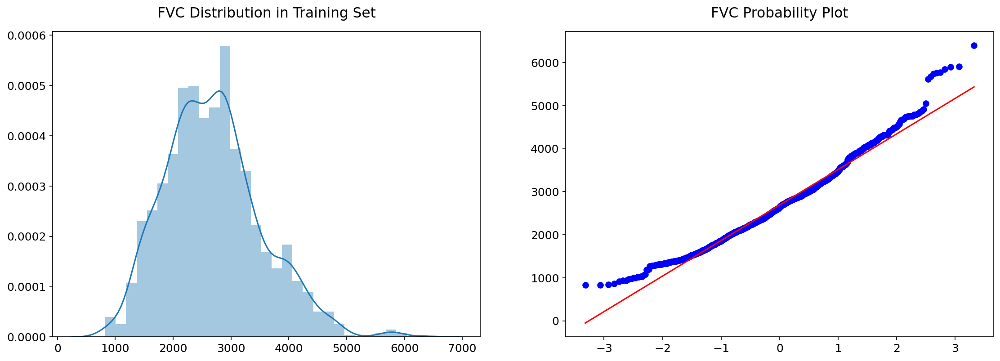

In [8]:
print(f'FVC Statistical Summary\n{"-" * 23}')

print(f'Mean: {df_train["FVC"].mean():.6}  -  Median: {df_train["FVC"].median():.6}  -  Std: {df_train["FVC"].std():.6}')
print(f'Min: {df_train["FVC"].min()}  -  25%: {df_train["FVC"].quantile(0.25)}  -  50%: {df_train["FVC"].quantile(0.5)}  -  75%: {df_train["FVC"].quantile(0.75)}  -  Max: {df_train["FVC"].max()}')
print(f'Skew: {df_train["FVC"].skew():.6}  -  Kurtosis: {df_train["FVC"].kurtosis():.6}')
missing_values_count = df_train[df_train["FVC"].isnull()].shape[0]
training_samples_count = df_train.shape[0]
print(f'Missing Values: {missing_values_count}/{training_samples_count} ({missing_values_count * 100 / training_samples_count:.4}%)')

fig, axes = plt.subplots(ncols=2, figsize=(18, 6), dpi=150)

sns.distplot(df_train['FVC'], label='FVC', ax=axes[0])
probplot(df_train['FVC'], plot=axes[1])

for i in range(2):
    axes[i].tick_params(axis='x', labelsize=12)
    axes[i].tick_params(axis='y', labelsize=12)
    axes[i].set_xlabel('')
    axes[i].set_ylabel('')
    
axes[0].set_title(f'FVC Distribution in Training Set', size=15, pad=15)
axes[1].set_title(f'FVC Probability Plot', size=15, pad=15)

plt.show()

Every patients' `FVC` should be plotted individually as a function of time because the competition objective is predicting `FVC` values of different patients over multiple timesteps.

Majority of the patients' conditions got worse over the course of weeks except 1-2%. Increase of `FVC` in that small group may be random because `FVC` fluctuates too much over time in some patients. Those patients may not be responding to treatment very well or they are not getting better for some reason. However, some patients are clearly getting better because their `FVC` are increasing linearly with very few fluctuations. Those patients are very rare.

Fluctuations don't appear to be predictable and that's why the score is calculated on the last three weeks of every patient and averaged. To avoid potential leakage, every patient's FVC measurement for every possible week must be predicted. That's why `submission.csv` has `Weeks` from **-12** to **133**. Those weeks which are not in the final three visits are ignored in scoring. Since the fluctuations don't appear to be predictable, this can be simplified into a slope prediction problem.

Patient: ID00007637202177411956430 FVC Statistical Summary
----------------------------------------------------------
Mean: 2113.89  -  Median: 2069.0  -  Std: 96.8561
Min: 2000 -  Max: 2315
Skew: 1.26267  -  Kurtosis: 1.31481
----------------------------------------------------------
Change Mean: 77.0  - Change Median: 79.0  - Change Std: 44.8203
Change Min: 7.0 -  Change Max: 153.0
Change Skew: 0.0645445 -  Change Kurtosis: 0.38165
----------------------------------------------------------
Slope (Calculated with All Data Points): -3.16713
Slope (Calculated with 2 Data Points): -4.22951


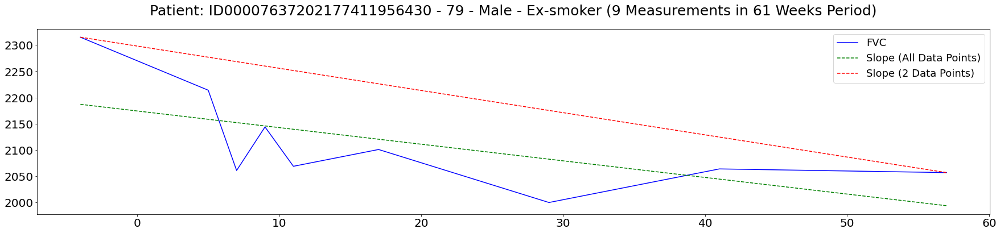

Patient: ID00009637202177434476278 FVC Statistical Summary
----------------------------------------------------------
Mean: 3596.67  -  Median: 3625.0  -  Std: 197.368
Min: 3214 -  Max: 3895
Skew: -0.704114  -  Kurtosis: 1.06018
----------------------------------------------------------
Change Mean: 138.75  - Change Median: 128.0  - Change Std: 88.4304
Change Min: 47.0 -  Change Max: 285.0
Change Skew: 0.584905 -  Change Kurtosis: -0.892268
----------------------------------------------------------
Slope (Calculated with All Data Points): -9.37996
Slope (Calculated with 2 Data Points): -8.57692


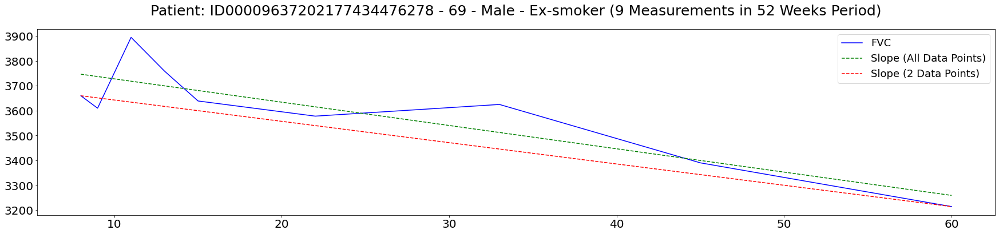

Patient: ID00010637202177584971671 FVC Statistical Summary
----------------------------------------------------------
Mean: 3037.11  -  Median: 3030.0  -  Std: 358.434
Min: 2474 -  Max: 3523
Skew: -0.493364  -  Kurtosis: -0.53517
----------------------------------------------------------
Change Mean: 164.125  - Change Median: 91.5  - Change Std: 173.523
Change Min: 37.0 -  Change Max: 519.0
Change Skew: 1.57635 -  Change Kurtosis: 1.69317
----------------------------------------------------------
Slope (Calculated with All Data Points): -17.0428
Slope (Calculated with 2 Data Points): -18.6111


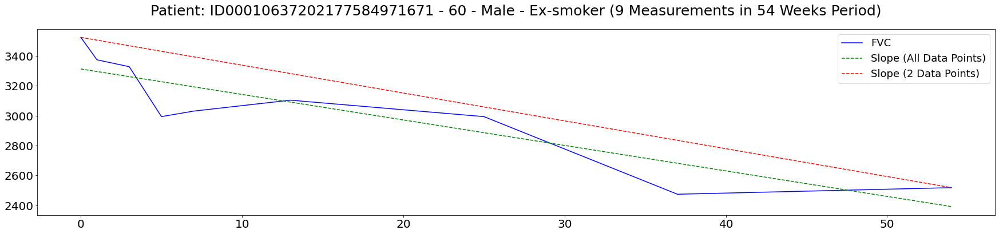

Patient: ID00011637202177653955184 FVC Statistical Summary
----------------------------------------------------------
Mean: 3387.0  -  Median: 3410.0  -  Std: 113.774
Min: 3193 -  Max: 3541
Skew: -0.359377  -  Kurtosis: -0.684807
----------------------------------------------------------
Change Mean: 106.375  - Change Median: 92.5  - Change Std: 53.5642
Change Min: 39.0 -  Change Max: 208.0
Change Skew: 0.938386 -  Change Kurtosis: 0.734179
----------------------------------------------------------
Slope (Calculated with All Data Points): -4.54893
Slope (Calculated with 2 Data Points): -2.55769


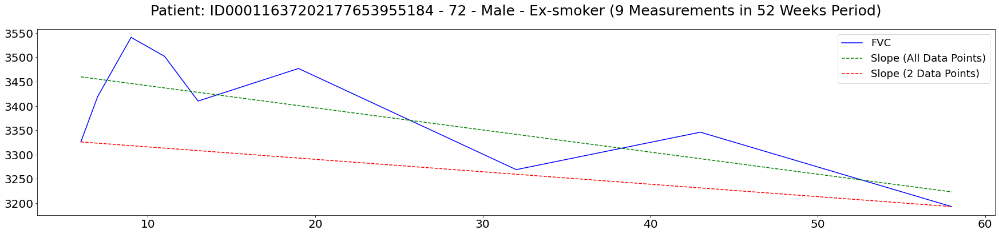

Patient: ID00012637202177665765362 FVC Statistical Summary
----------------------------------------------------------
Mean: 3348.78  -  Median: 3324.0  -  Std: 212.432
Min: 2971 -  Max: 3759
Skew: 0.246968  -  Kurtosis: 1.89361
----------------------------------------------------------
Change Mean: 228.125  - Change Median: 178.0  - Change Std: 128.947
Change Min: 93.0 -  Change Max: 483.0
Change Skew: 1.24204 -  Change Kurtosis: 1.12295
----------------------------------------------------------
Slope (Calculated with All Data Points): -8.54308
Slope (Calculated with 2 Data Points): -8.27778


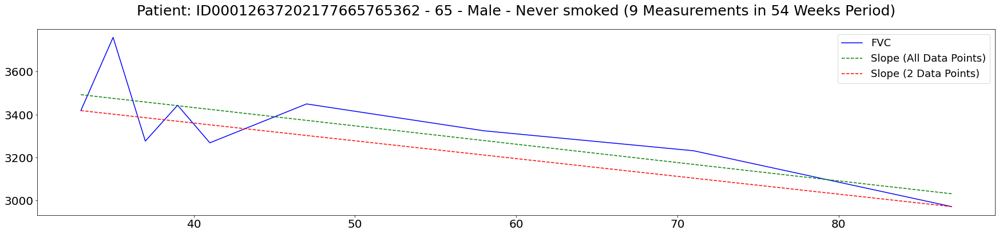

Patient: ID00014637202177757139317 FVC Statistical Summary
----------------------------------------------------------
Mean: 3531.78  -  Median: 3615.0  -  Std: 311.701
Min: 3027 -  Max: 3897
Skew: -0.4614  -  Kurtosis: -1.39173
----------------------------------------------------------
Change Mean: 217.25  - Change Median: 194.5  - Change Std: 179.708
Change Min: 17.0 -  Change Max: 518.0
Change Skew: 0.594234 -  Change Kurtosis: -0.711456
----------------------------------------------------------
Slope (Calculated with All Data Points): -14.0334
Slope (Calculated with 2 Data Points): -14.4444


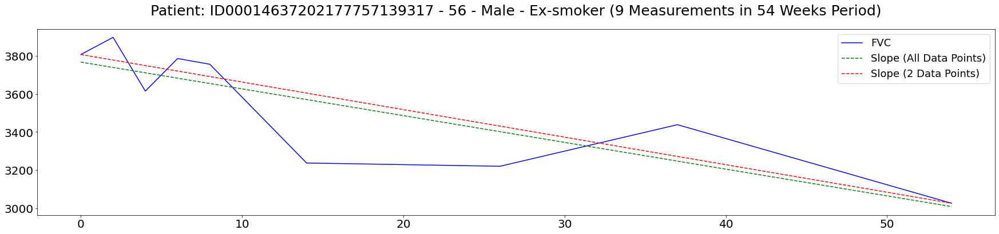

Patient: ID00015637202177877247924 FVC Statistical Summary
----------------------------------------------------------
Mean: 2831.38  -  Median: 2793.5  -  Std: 199.234
Min: 2585 -  Max: 3120
Skew: 0.264544  -  Kurtosis: -1.74341
----------------------------------------------------------
Change Mean: 173.571  - Change Median: 223.0  - Change Std: 109.163
Change Min: 15.0 -  Change Max: 301.0
Change Skew: -0.361374 -  Change Kurtosis: -1.71954
----------------------------------------------------------
Slope (Calculated with All Data Points): -7.57896
Slope (Calculated with 2 Data Points): -8.01754


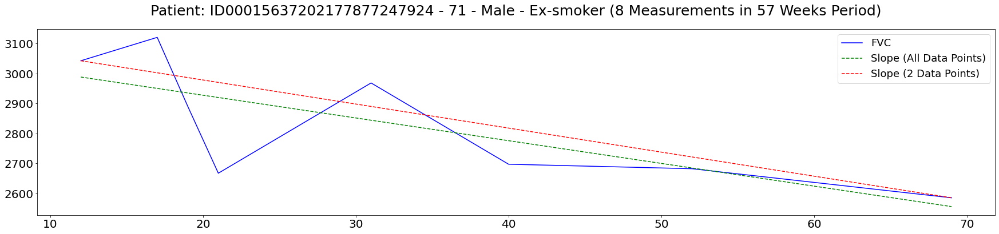

Patient: ID00019637202178323708467 FVC Statistical Summary
----------------------------------------------------------
Mean: 1983.56  -  Median: 2002.0  -  Std: 120.008
Min: 1778 -  Max: 2116
Skew: -0.895475  -  Kurtosis: -0.3489
----------------------------------------------------------
Change Mean: 82.0  - Change Median: 53.0  - Change Std: 51.3893
Change Min: 30.0 -  Change Max: 170.0
Change Skew: 0.879756 -  Change Kurtosis: -0.86541
----------------------------------------------------------
Slope (Calculated with All Data Points): -5.72996
Slope (Calculated with 2 Data Points): -6.07547


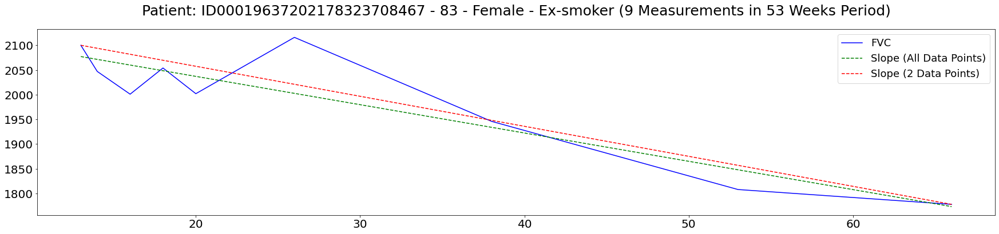

Patient: ID00020637202178344345685 FVC Statistical Summary
----------------------------------------------------------
Mean: 2111.89  -  Median: 2115.0  -  Std: 144.833
Min: 1861 -  Max: 2297
Skew: -0.510957  -  Kurtosis: -0.494864
----------------------------------------------------------
Change Mean: 85.5  - Change Median: 89.5  - Change Std: 56.2367
Change Min: 5.0 -  Change Max: 154.0
Change Skew: -0.19951 -  Change Kurtosis: -1.30256
----------------------------------------------------------
Slope (Calculated with All Data Points): -7.37069
Slope (Calculated with 2 Data Points): -8.38462


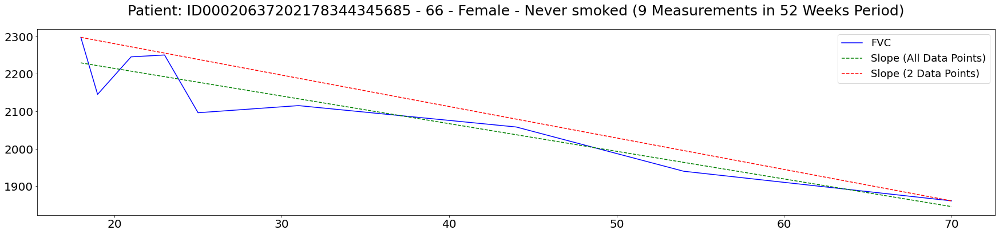

Patient: ID00023637202179104603099 FVC Statistical Summary
----------------------------------------------------------
Mean: 1435.44  -  Median: 1406.0  -  Std: 117.187
Min: 1304 -  Max: 1681
Skew: 1.18797  -  Kurtosis: 1.37093
----------------------------------------------------------
Change Mean: 121.75  - Change Median: 114.0  - Change Std: 77.8547
Change Min: 7.0 -  Change Max: 220.0
Change Skew: -0.136724 -  Change Kurtosis: -1.05203
----------------------------------------------------------
Slope (Calculated with All Data Points): -2.54915
Slope (Calculated with 2 Data Points): -2.24138


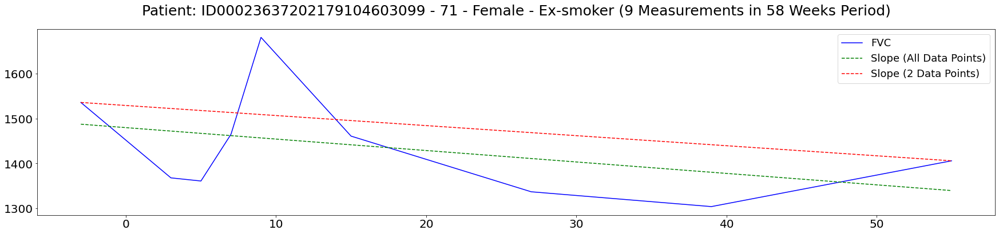

Patient: ID00025637202179541264076 FVC Statistical Summary
----------------------------------------------------------
Mean: 2996.44  -  Median: 3042.0  -  Std: 241.196
Min: 2533 -  Max: 3277
Skew: -0.67619  -  Kurtosis: 0.235146
----------------------------------------------------------
Change Mean: 198.5  - Change Median: 220.5  - Change Std: 71.3683
Change Min: 69.0 -  Change Max: 278.0
Change Skew: -0.997464 -  Change Kurtosis: 0.0911752
----------------------------------------------------------
Slope (Calculated with All Data Points): -10.8182
Slope (Calculated with 2 Data Points): -6.98113


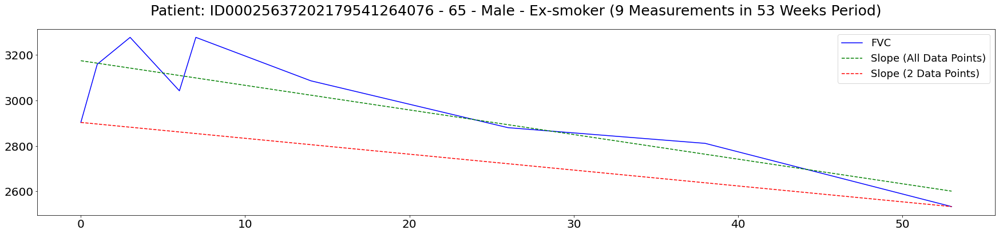

Patient: ID00026637202179561894768 FVC Statistical Summary
----------------------------------------------------------
Mean: 2879.78  -  Median: 2884.0  -  Std: 109.378
Min: 2700 -  Max: 3007
Skew: -0.364128  -  Kurtosis: -1.08872
----------------------------------------------------------
Change Mean: 116.75  - Change Median: 103.0  - Change Std: 74.0285
Change Min: 26.0 -  Change Max: 241.0
Change Skew: 0.750945 -  Change Kurtosis: -0.322338
----------------------------------------------------------
Slope (Calculated with All Data Points): -2.96786
Slope (Calculated with 2 Data Points): -3.22807


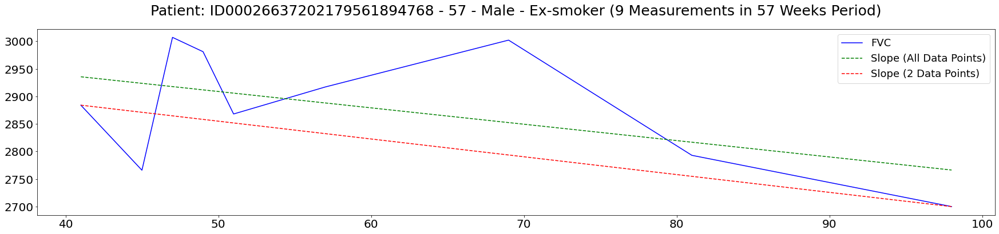

Patient: ID00027637202179689871102 FVC Statistical Summary
----------------------------------------------------------
Mean: 2625.44  -  Median: 2564.0  -  Std: 165.82
Min: 2378 -  Max: 2887
Skew: 0.174214  -  Kurtosis: -0.963079
----------------------------------------------------------
Change Mean: 144.25  - Change Median: 107.0  - Change Std: 131.602
Change Min: 17.0 -  Change Max: 340.0
Change Skew: 0.653421 -  Change Kurtosis: -1.32864
----------------------------------------------------------
Slope (Calculated with All Data Points): -5.49437
Slope (Calculated with 2 Data Points): -1.74074


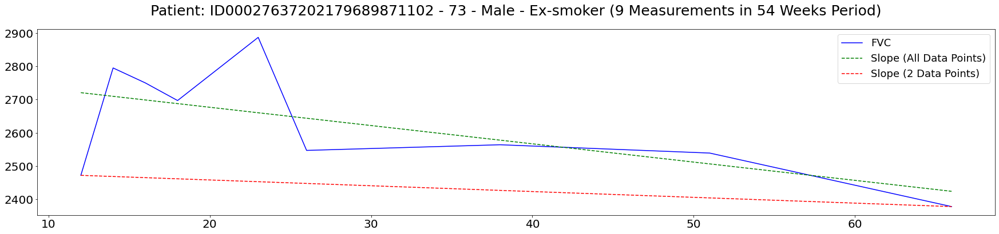

Patient: ID00030637202181211009029 FVC Statistical Summary
----------------------------------------------------------
Mean: 2500.25  -  Median: 2529.0  -  Std: 125.433
Min: 2328 -  Max: 2694
Skew: 0.0130048  -  Kurtosis: -1.05921
----------------------------------------------------------
Change Mean: 135.714  - Change Median: 99.0  - Change Std: 101.643
Change Min: 43.0 -  Change Max: 306.0
Change Skew: 0.81676 -  Change Kurtosis: -0.697016
----------------------------------------------------------
Slope (Calculated with All Data Points): -4.68777
Slope (Calculated with 2 Data Points): -2.78261


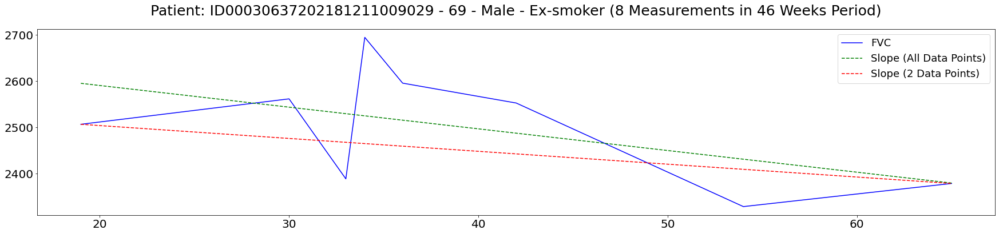

Patient: ID00032637202181710233084 FVC Statistical Summary
----------------------------------------------------------
Mean: 4657.67  -  Median: 4743.0  -  Std: 341.047
Min: 3846 -  Max: 5045
Skew: -1.88392  -  Kurtosis: 4.54743
----------------------------------------------------------
Change Mean: 248.625  - Change Median: 201.5  - Change Std: 273.881
Change Min: 51.0 -  Change Max: 897.0
Change Skew: 2.35649 -  Change Kurtosis: 6.07397
----------------------------------------------------------
Slope (Calculated with All Data Points): -14.3629
Slope (Calculated with 2 Data Points): -21.0351


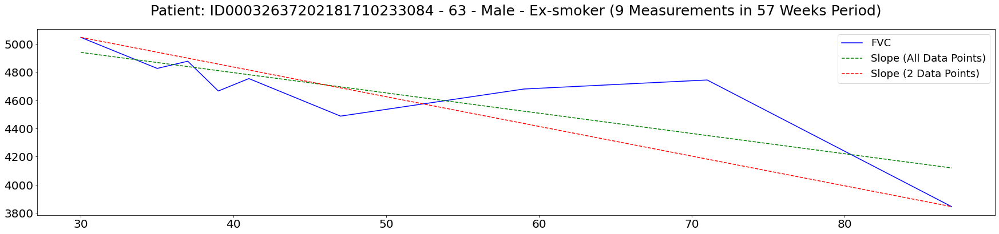

Patient: ID00035637202182204917484 FVC Statistical Summary
----------------------------------------------------------
Mean: 2551.33  -  Median: 2634.0  -  Std: 211.593
Min: 2195 -  Max: 2787
Skew: -0.813192  -  Kurtosis: -0.89946
----------------------------------------------------------
Change Mean: 122.25  - Change Median: 90.0  - Change Std: 125.475
Change Min: 16.0 -  Change Max: 396.0
Change Skew: 1.75191 -  Change Kurtosis: 3.27088
----------------------------------------------------------
Slope (Calculated with All Data Points): -9.67316
Slope (Calculated with 2 Data Points): -8.44444


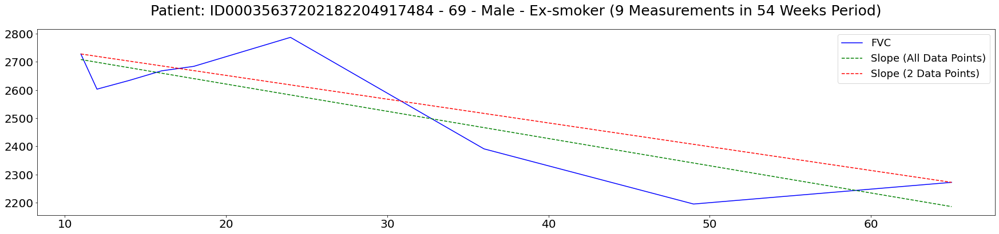

Patient: ID00038637202182690843176 FVC Statistical Summary
----------------------------------------------------------
Mean: 3897.44  -  Median: 3896.0  -  Std: 71.39
Min: 3787 -  Max: 4000
Skew: 0.0671798  -  Kurtosis: -0.870804
----------------------------------------------------------
Change Mean: 75.75  - Change Median: 36.5  - Change Std: 75.9506
Change Min: 12.0 -  Change Max: 201.0
Change Skew: 0.89106 -  Change Kurtosis: -1.07449
----------------------------------------------------------
Slope (Calculated with All Data Points): -0.800797
Slope (Calculated with 2 Data Points): -0.877193


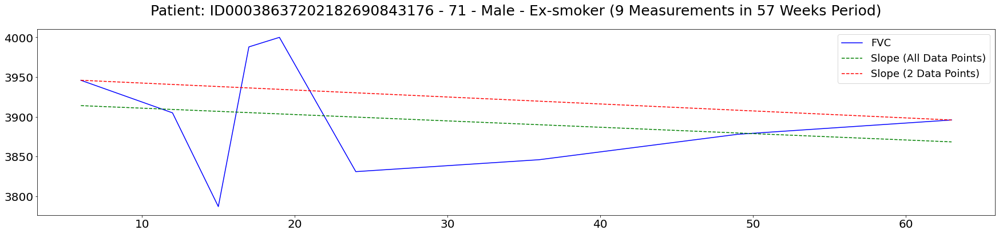

Patient: ID00042637202184406822975 FVC Statistical Summary
----------------------------------------------------------
Mean: 3613.67  -  Median: 3555.0  -  Std: 173.005
Min: 3431 -  Max: 3961
Skew: 1.09275  -  Kurtosis: 0.68498
----------------------------------------------------------
Change Mean: 200.25  - Change Median: 169.5  - Change Std: 156.21
Change Min: 41.0 -  Change Max: 530.0
Change Skew: 1.45157 -  Change Kurtosis: 2.547
----------------------------------------------------------
Slope (Calculated with All Data Points): 0.598134
Slope (Calculated with 2 Data Points): -6.10169


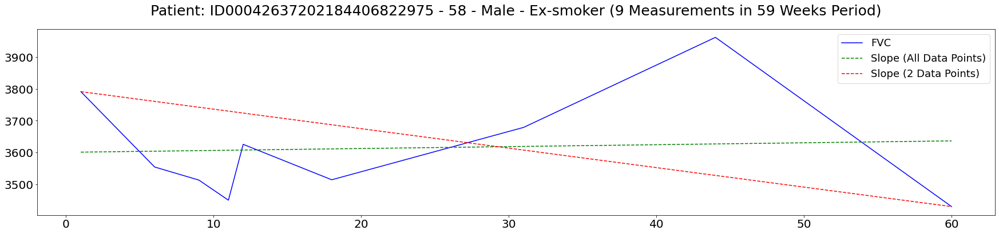

Patient: ID00047637202184938901501 FVC Statistical Summary
----------------------------------------------------------
Mean: 3215.83  -  Median: 3235.5  -  Std: 128.896
Min: 3012 -  Max: 3370
Skew: -0.634159  -  Kurtosis: -0.0688272
----------------------------------------------------------
Change Mean: 157.0  - Change Median: 135.0  - Change Std: 72.059
Change Min: 78.0 -  Change Max: 241.0
Change Skew: 0.294855 -  Change Kurtosis: -2.65116
----------------------------------------------------------
Slope (Calculated with All Data Points): -10.8315
Slope (Calculated with 2 Data Points): -11.1481


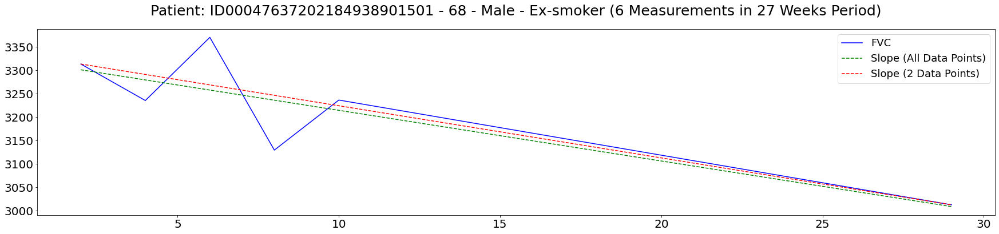

Patient: ID00048637202185016727717 FVC Statistical Summary
----------------------------------------------------------
Mean: 1419.56  -  Median: 1414.0  -  Std: 39.7244
Min: 1370 -  Max: 1477
Skew: 0.171177  -  Kurtosis: -1.60311
----------------------------------------------------------
Change Mean: 42.875  - Change Median: 27.0  - Change Std: 31.211
Change Min: 17.0 -  Change Max: 102.0
Change Skew: 1.28753 -  Change Kurtosis: 0.427754
----------------------------------------------------------
Slope (Calculated with All Data Points): -1.19041
Slope (Calculated with 2 Data Points): -0.0961538


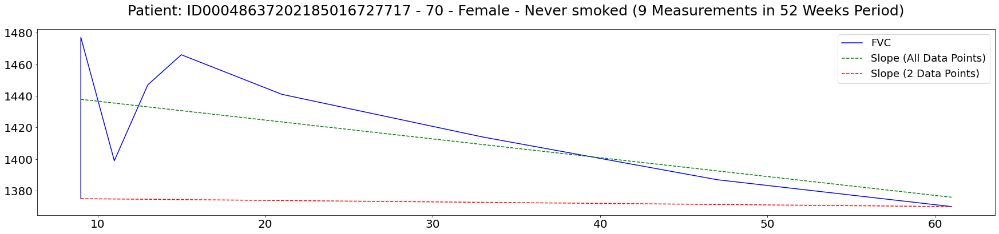

Patient: ID00051637202185848464638 FVC Statistical Summary
----------------------------------------------------------
Mean: 1637.11  -  Median: 1624.0  -  Std: 87.6462
Min: 1520 -  Max: 1776
Skew: 0.0999137  -  Kurtosis: -1.10463
----------------------------------------------------------
Change Mean: 75.375  - Change Median: 58.0  - Change Std: 66.7938
Change Min: 8.0 -  Change Max: 207.0
Change Skew: 1.15248 -  Change Kurtosis: 1.08297
----------------------------------------------------------
Slope (Calculated with All Data Points): -3.37359
Slope (Calculated with 2 Data Points): -3.0


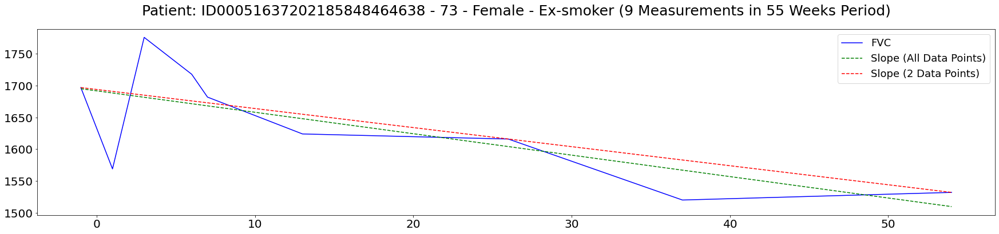

Patient: ID00052637202186188008618 FVC Statistical Summary
----------------------------------------------------------
Mean: 2336.43  -  Median: 2436.0  -  Std: 240.856
Min: 1848 -  Max: 2522
Skew: -1.67688  -  Kurtosis: 2.90046
----------------------------------------------------------
Change Mean: 179.5  - Change Median: 113.0  - Change Std: 219.12
Change Min: 5.0 -  Change Max: 588.0
Change Skew: 1.62956 -  Change Kurtosis: 2.73995
----------------------------------------------------------
Slope (Calculated with All Data Points): -23.2875
Slope (Calculated with 2 Data Points): -23.7407


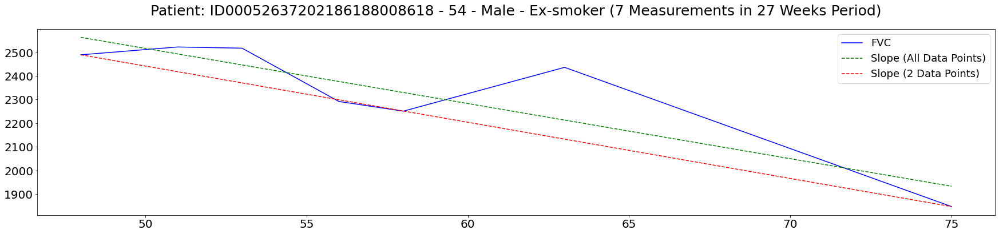

Patient: ID00060637202187965290703 FVC Statistical Summary
----------------------------------------------------------
Mean: 3195.33  -  Median: 3255.0  -  Std: 171.79
Min: 2890 -  Max: 3418
Skew: -0.502095  -  Kurtosis: -0.573541
----------------------------------------------------------
Change Mean: 146.875  - Change Median: 145.5  - Change Std: 65.2434
Change Min: 48.0 -  Change Max: 234.0
Change Skew: -0.0149456 -  Change Kurtosis: -0.87382
----------------------------------------------------------
Slope (Calculated with All Data Points): -6.74182
Slope (Calculated with 2 Data Points): -6.63636


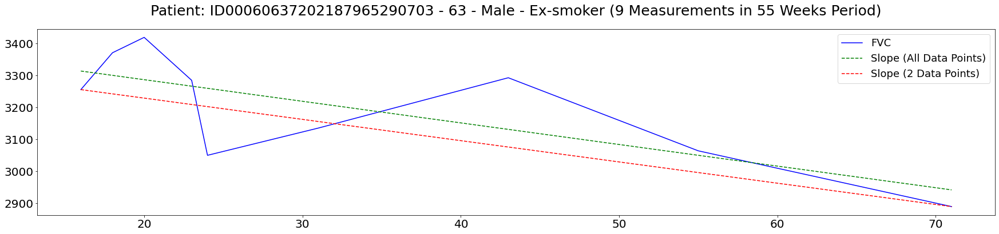

Patient: ID00061637202188184085559 FVC Statistical Summary
----------------------------------------------------------
Mean: 3872.0  -  Median: 4043.0  -  Std: 515.657
Min: 2511 -  Max: 4134
Skew: -2.88473  -  Kurtosis: 8.47876
----------------------------------------------------------
Change Mean: 463.5  - Change Median: 148.5  - Change Std: 670.412
Change Min: 5.0 -  Change Max: 1623.0
Change Skew: 1.40535 -  Change Kurtosis: 0.0478326
----------------------------------------------------------
Slope (Calculated with All Data Points): 8.24164
Slope (Calculated with 2 Data Points): 2.26415


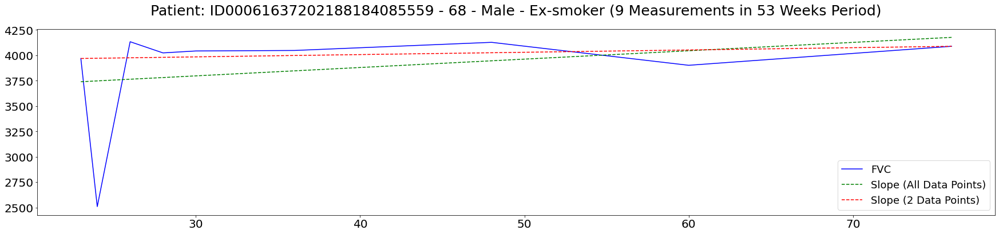

Patient: ID00062637202188654068490 FVC Statistical Summary
----------------------------------------------------------
Mean: 2232.22  -  Median: 2239.0  -  Std: 89.2241
Min: 2071 -  Max: 2341
Skew: -0.469323  -  Kurtosis: -0.352358
----------------------------------------------------------
Change Mean: 71.0  - Change Median: 57.5  - Change Std: 56.7425
Change Min: 5.0 -  Change Max: 183.0
Change Skew: 1.07403 -  Change Kurtosis: 1.17783
----------------------------------------------------------
Slope (Calculated with All Data Points): -3.79844
Slope (Calculated with 2 Data Points): -4.25926


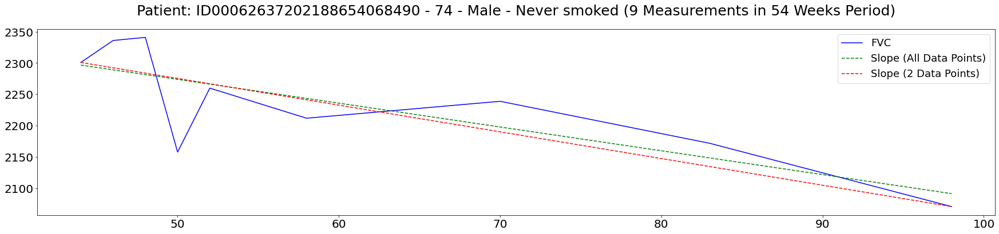

Patient: ID00067637202189903532242 FVC Statistical Summary
----------------------------------------------------------
Mean: 3379.75  -  Median: 3386.5  -  Std: 122.853
Min: 3230 -  Max: 3608
Skew: 0.673985  -  Kurtosis: 0.428985
----------------------------------------------------------
Change Mean: 135.143  - Change Median: 154.0  - Change Std: 77.1048
Change Min: 26.0 -  Change Max: 245.0
Change Skew: -0.248643 -  Change Kurtosis: -0.695664
----------------------------------------------------------
Slope (Calculated with All Data Points): -5.95318
Slope (Calculated with 2 Data Points): -6.10811


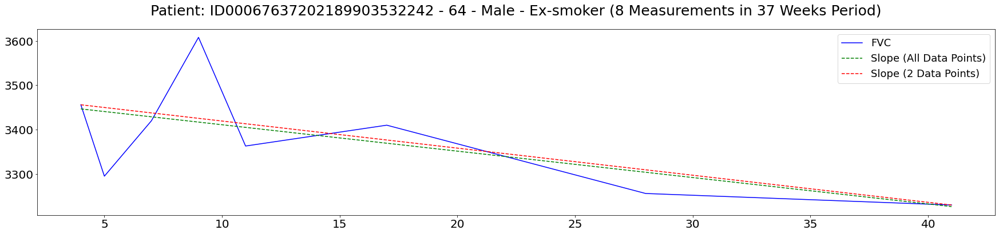

Patient: ID00068637202190879923934 FVC Statistical Summary
----------------------------------------------------------
Mean: 2679.67  -  Median: 2740.0  -  Std: 145.541
Min: 2459 -  Max: 2827
Skew: -0.587436  -  Kurtosis: -1.40161
----------------------------------------------------------
Change Mean: 109.5  - Change Median: 106.0  - Change Std: 70.5084
Change Min: 33.0 -  Change Max: 227.0
Change Skew: 0.456776 -  Change Kurtosis: -1.04881
----------------------------------------------------------
Slope (Calculated with All Data Points): -6.60296
Slope (Calculated with 2 Data Points): -6.23529


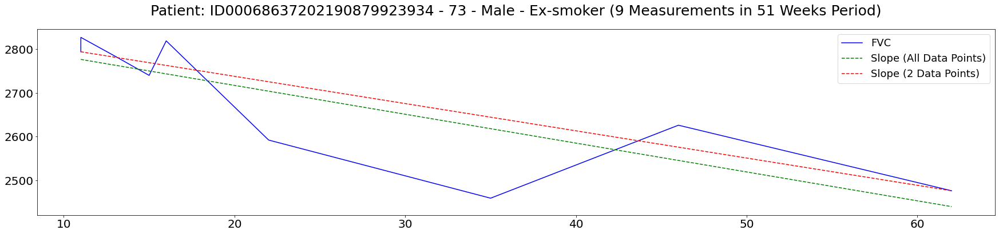

Patient: ID00072637202198161894406 FVC Statistical Summary
----------------------------------------------------------
Mean: 2333.56  -  Median: 2356.0  -  Std: 59.7602
Min: 2233 -  Max: 2414
Skew: -0.781601  -  Kurtosis: -0.265866
----------------------------------------------------------
Change Mean: 65.0  - Change Median: 68.5  - Change Std: 46.0683
Change Min: 2.0 -  Change Max: 123.0
Change Skew: -0.128804 -  Change Kurtosis: -1.78233
----------------------------------------------------------
Slope (Calculated with All Data Points): -2.03481
Slope (Calculated with 2 Data Points): -2.03636


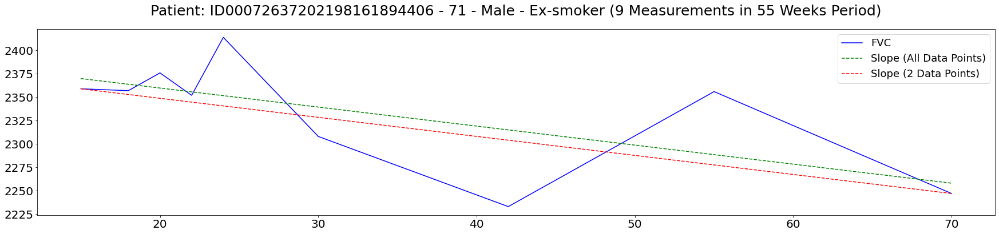

Patient: ID00073637202198167792918 FVC Statistical Summary
----------------------------------------------------------
Mean: 2284.12  -  Median: 2357.5  -  Std: 259.285
Min: 1709 -  Max: 2547
Skew: -1.86489  -  Kurtosis: 3.84822
----------------------------------------------------------
Change Mean: 135.714  - Change Median: 57.0  - Change Std: 144.812
Change Min: 7.0 -  Change Max: 421.0
Change Skew: 1.54303 -  Change Kurtosis: 2.12847
----------------------------------------------------------
Slope (Calculated with All Data Points): -18.3818
Slope (Calculated with 2 Data Points): -21.4872


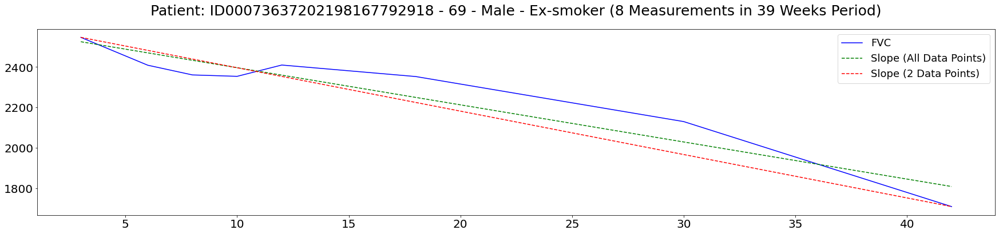

Patient: ID00075637202198610425520 FVC Statistical Summary
----------------------------------------------------------
Mean: 1501.33  -  Median: 1541.0  -  Std: 160.2
Min: 1185 -  Max: 1641
Skew: -1.28511  -  Kurtosis: 0.600416
----------------------------------------------------------
Change Mean: 80.5  - Change Median: 92.0  - Change Std: 66.9669
Change Min: 2.0 -  Change Max: 173.0
Change Skew: 0.0241744 -  Change Kurtosis: -1.64346
----------------------------------------------------------
Slope (Calculated with All Data Points): -8.13925
Slope (Calculated with 2 Data Points): -8.44444


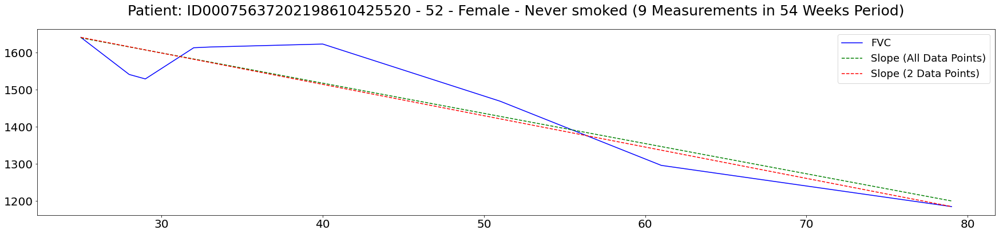

Patient: ID00076637202199015035026 FVC Statistical Summary
----------------------------------------------------------
Mean: 2525.56  -  Median: 2480.0  -  Std: 251.122
Min: 2182 -  Max: 2914
Skew: 0.386445  -  Kurtosis: -1.0276
----------------------------------------------------------
Change Mean: 184.125  - Change Median: 197.5  - Change Std: 124.542
Change Min: 4.0 -  Change Max: 394.0
Change Skew: 0.203515 -  Change Kurtosis: -0.146536
----------------------------------------------------------
Slope (Calculated with All Data Points): 11.2259
Slope (Calculated with 2 Data Points): 9.40678


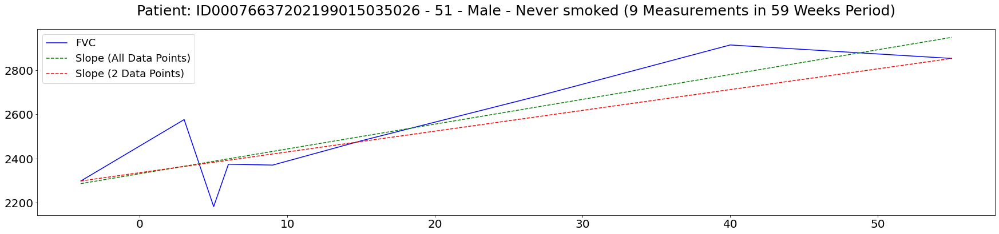

Patient: ID00077637202199102000916 FVC Statistical Summary
----------------------------------------------------------
Mean: 3312.56  -  Median: 3378.0  -  Std: 125.568
Min: 3121 -  Max: 3504
Skew: -0.183914  -  Kurtosis: -1.0237
----------------------------------------------------------
Change Mean: 102.625  - Change Median: 119.0  - Change Std: 48.0087
Change Min: 13.0 -  Change Max: 157.0
Change Skew: -1.12079 -  Change Kurtosis: 0.478534
----------------------------------------------------------
Slope (Calculated with All Data Points): 4.18007
Slope (Calculated with 2 Data Points): 4.09259


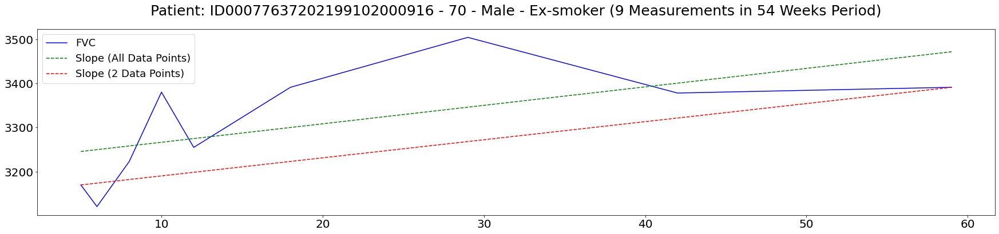

Patient: ID00078637202199415319443 FVC Statistical Summary
----------------------------------------------------------
Mean: 1753.56  -  Median: 1780.0  -  Std: 149.099
Min: 1385 -  Max: 1901
Skew: -2.19394  -  Kurtosis: 5.77073
----------------------------------------------------------
Change Mean: 76.375  - Change Median: 43.0  - Change Std: 105.373
Change Min: 17.0 -  Change Max: 333.0
Change Skew: 2.65753 -  Change Kurtosis: 7.24279
----------------------------------------------------------
Slope (Calculated with All Data Points): -7.02978
Slope (Calculated with 2 Data Points): -8.18966


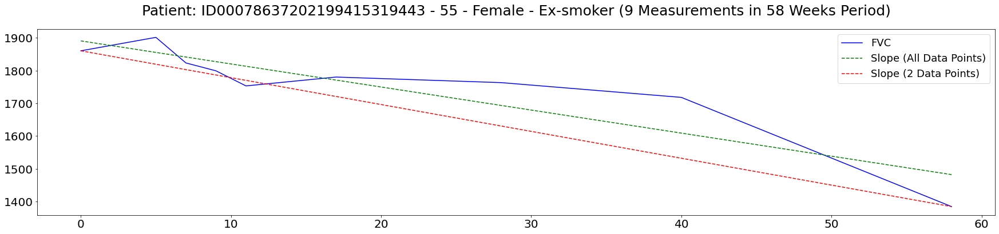

Patient: ID00082637202201836229724 FVC Statistical Summary
----------------------------------------------------------
Mean: 2915.33  -  Median: 2918.0  -  Std: 49.5278
Min: 2837 -  Max: 2975
Skew: -0.257369  -  Kurtosis: -1.5585
----------------------------------------------------------
Change Mean: 71.625  - Change Median: 80.0  - Change Std: 37.0942
Change Min: 18.0 -  Change Max: 138.0
Change Skew: 0.344139 -  Change Kurtosis: 0.454143
----------------------------------------------------------
Slope (Calculated with All Data Points): -0.067118
Slope (Calculated with 2 Data Points): -0.716667


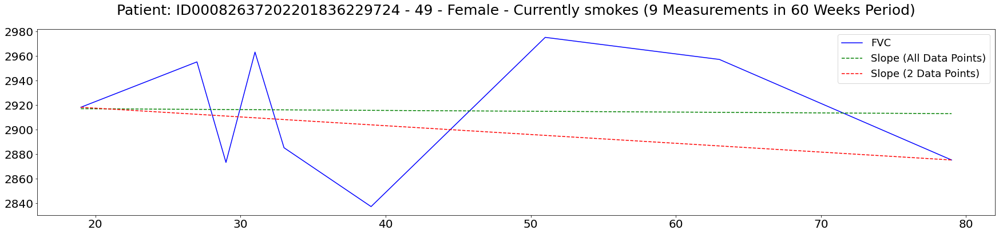

Patient: ID00086637202203494931510 FVC Statistical Summary
----------------------------------------------------------
Mean: 3359.67  -  Median: 3367.0  -  Std: 123.501
Min: 3076 -  Max: 3486
Skew: -1.63484  -  Kurtosis: 3.3842
----------------------------------------------------------
Change Mean: 147.0  - Change Median: 115.5  - Change Std: 131.966
Change Min: 18.0 -  Change Max: 410.0
Change Skew: 1.35981 -  Change Kurtosis: 1.30863
----------------------------------------------------------
Slope (Calculated with All Data Points): -0.191625
Slope (Calculated with 2 Data Points): -0.634921


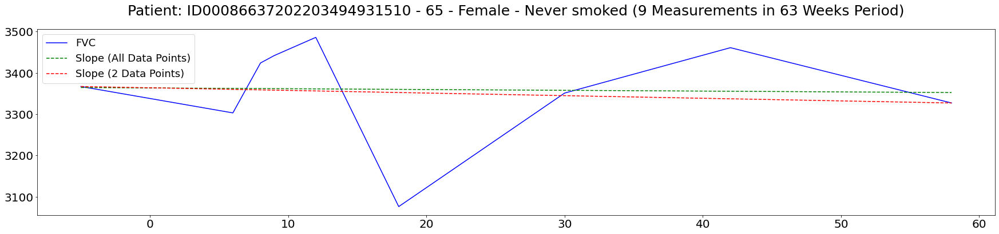

Patient: ID00089637202204675567570 FVC Statistical Summary
----------------------------------------------------------
Mean: 2295.78  -  Median: 2297.0  -  Std: 244.581
Min: 1918 -  Max: 2571
Skew: -0.351537  -  Kurtosis: -1.56901
----------------------------------------------------------
Change Mean: 93.25  - Change Median: 60.5  - Change Std: 65.1718
Change Min: 32.0 -  Change Max: 214.0
Change Skew: 1.15162 -  Change Kurtosis: 0.0978518
----------------------------------------------------------
Slope (Calculated with All Data Points): -12.2186
Slope (Calculated with 2 Data Points): -10.566


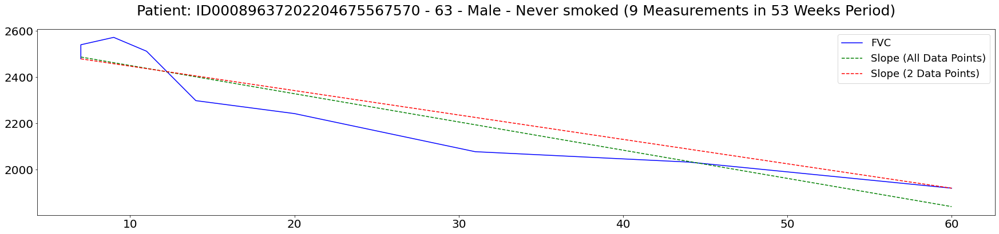

Patient: ID00090637202204766623410 FVC Statistical Summary
----------------------------------------------------------
Mean: 3028.38  -  Median: 2963.5  -  Std: 220.23
Min: 2877 -  Max: 3562
Skew: 2.59495  -  Kurtosis: 7.03844
----------------------------------------------------------
Change Mean: 120.714  - Change Median: 66.0  - Change Std: 187.009
Change Min: 11.0 -  Change Max: 538.0
Change Skew: 2.4722 -  Change Kurtosis: 6.29678
----------------------------------------------------------
Slope (Calculated with All Data Points): -5.73332
Slope (Calculated with 2 Data Points): -11.6964


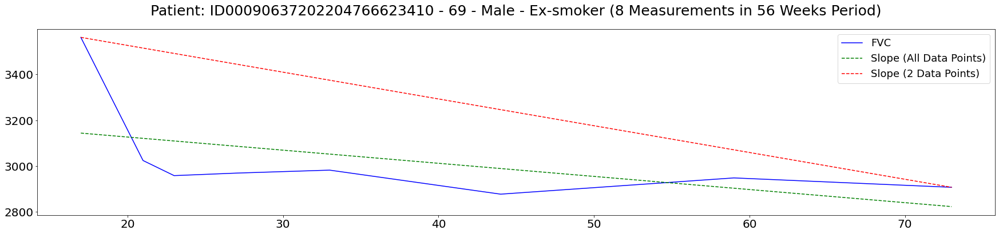

Patient: ID00093637202205278167493 FVC Statistical Summary
----------------------------------------------------------
Mean: 3577.44  -  Median: 3668.0  -  Std: 342.147
Min: 2728 -  Max: 3841
Skew: -2.2722  -  Kurtosis: 5.83411
----------------------------------------------------------
Change Mean: 347.625  - Change Median: 233.0  - Change Std: 299.85
Change Min: 40.0 -  Change Max: 864.0
Change Skew: 1.0757 -  Change Kurtosis: -0.26091
----------------------------------------------------------
Slope (Calculated with All Data Points): 0.71657
Slope (Calculated with 2 Data Points): -0.490909


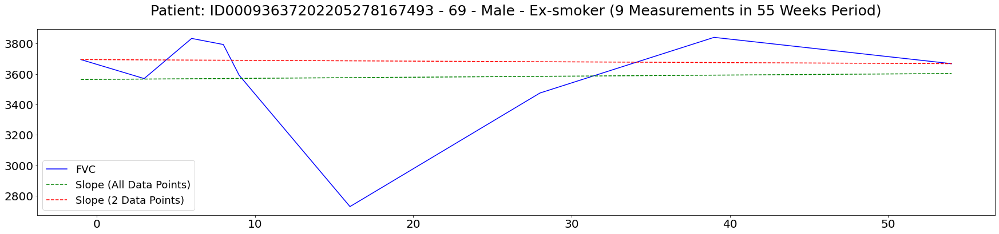

Patient: ID00094637202205333947361 FVC Statistical Summary
----------------------------------------------------------
Mean: 4759.56  -  Median: 4753.0  -  Std: 96.7627
Min: 4574 -  Max: 4916
Skew: -0.34068  -  Kurtosis: 1.21703
----------------------------------------------------------
Change Mean: 110.5  - Change Median: 117.5  - Change Std: 63.671
Change Min: 3.0 -  Change Max: 179.0
Change Skew: -0.502778 -  Change Kurtosis: -0.827833
----------------------------------------------------------
Slope (Calculated with All Data Points): -2.83714
Slope (Calculated with 2 Data Points): -2.82759


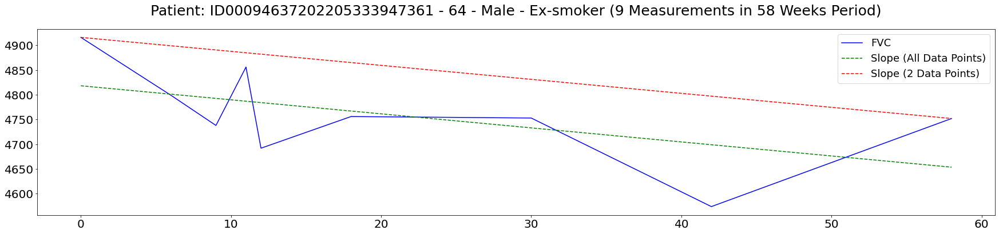

Patient: ID00099637202206203080121 FVC Statistical Summary
----------------------------------------------------------
Mean: 2913.2  -  Median: 2900.0  -  Std: 126.798
Min: 2708 -  Max: 3089
Skew: -0.136489  -  Kurtosis: -1.0672
----------------------------------------------------------
Change Mean: 95.0  - Change Median: 68.0  - Change Std: 81.2019
Change Min: 4.0 -  Change Max: 232.0
Change Skew: 0.733086 -  Change Kurtosis: -0.898212
----------------------------------------------------------
Slope (Calculated with All Data Points): -3.62202
Slope (Calculated with 2 Data Points): -1.74138


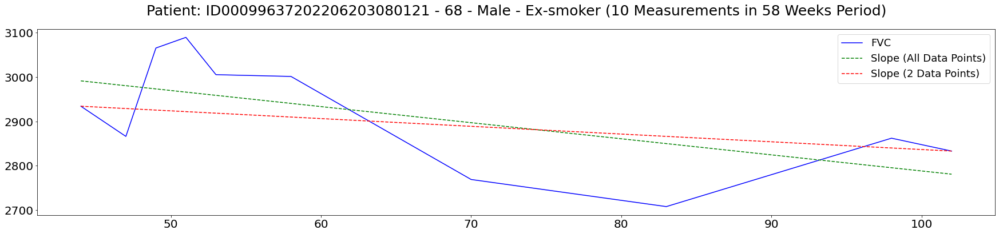

Patient: ID00102637202206574119190 FVC Statistical Summary
----------------------------------------------------------
Mean: 2275.22  -  Median: 2336.0  -  Std: 270.333
Min: 1651 -  Max: 2553
Skew: -1.69144  -  Kurtosis: 3.54364
----------------------------------------------------------
Change Mean: 233.375  - Change Median: 178.0  - Change Std: 188.563
Change Min: 43.0 -  Change Max: 545.0
Change Skew: 0.890941 -  Change Kurtosis: -0.654787
----------------------------------------------------------
Slope (Calculated with All Data Points): -0.437413
Slope (Calculated with 2 Data Points): -2.70909


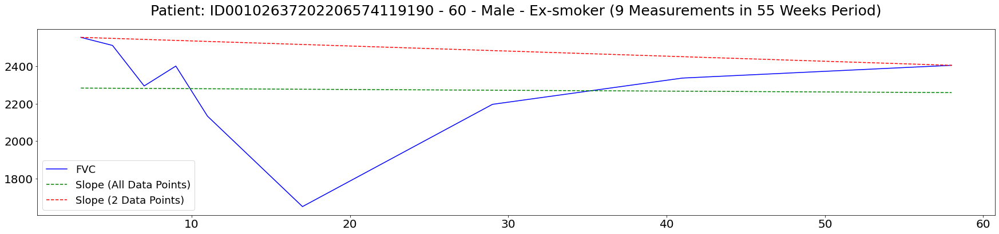

Patient: ID00104637202208063407045 FVC Statistical Summary
----------------------------------------------------------
Mean: 2188.0  -  Median: 2271.0  -  Std: 227.059
Min: 1733 -  Max: 2381
Skew: -1.25855  -  Kurtosis: 1.20074
----------------------------------------------------------
Change Mean: 104.0  - Change Median: 53.0  - Change Std: 105.122
Change Min: 7.0 -  Change Max: 303.0
Change Skew: 1.3308 -  Change Kurtosis: 1.2309
----------------------------------------------------------
Slope (Calculated with All Data Points): -16.4648
Slope (Calculated with 2 Data Points): -16.9474


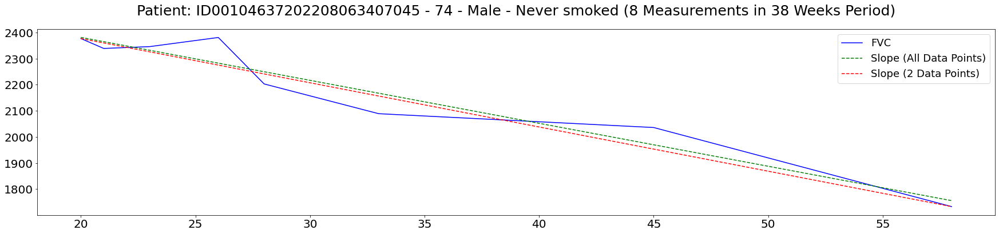

Patient: ID00105637202208831864134 FVC Statistical Summary
----------------------------------------------------------
Mean: 2389.1  -  Median: 2413.0  -  Std: 144.162
Min: 2076 -  Max: 2547
Skew: -1.23155  -  Kurtosis: 1.34751
----------------------------------------------------------
Change Mean: 77.8889  - Change Median: 81.0  - Change Std: 44.0297
Change Min: 24.0 -  Change Max: 161.0
Change Skew: 0.605612 -  Change Kurtosis: 0.208716
----------------------------------------------------------
Slope (Calculated with All Data Points): -5.8736
Slope (Calculated with 2 Data Points): -7.19643


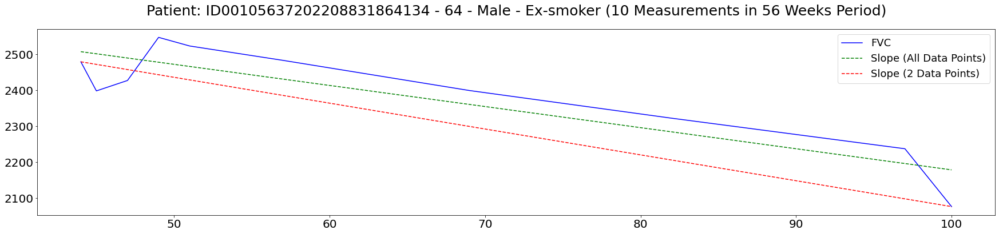

Patient: ID00108637202209619669361 FVC Statistical Summary
----------------------------------------------------------
Mean: 2742.11  -  Median: 2707.0  -  Std: 103.538
Min: 2611 -  Max: 2914
Skew: 0.410813  -  Kurtosis: -1.12559
----------------------------------------------------------
Change Mean: 82.125  - Change Median: 65.5  - Change Std: 68.6366
Change Min: 13.0 -  Change Max: 183.0
Change Skew: 0.444814 -  Change Kurtosis: -1.7399
----------------------------------------------------------
Slope (Calculated with All Data Points): -4.18505
Slope (Calculated with 2 Data Points): -5.61111


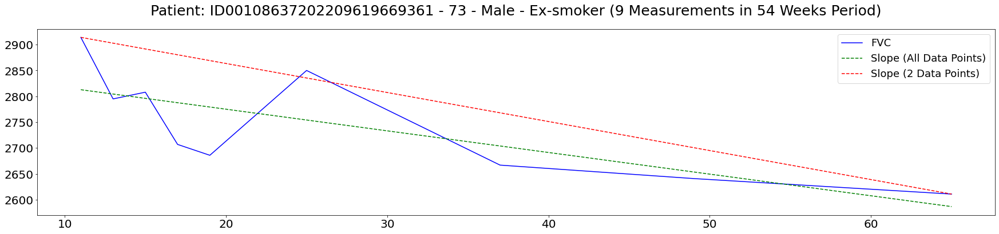

Patient: ID00109637202210454292264 FVC Statistical Summary
----------------------------------------------------------
Mean: 2148.44  -  Median: 2186.0  -  Std: 178.985
Min: 1725 -  Max: 2327
Skew: -1.86175  -  Kurtosis: 4.22484
----------------------------------------------------------
Change Mean: 139.25  - Change Median: 93.5  - Change Std: 112.865
Change Min: 41.0 -  Change Max: 387.0
Change Skew: 1.85057 -  Change Kurtosis: 3.41952
----------------------------------------------------------
Slope (Calculated with All Data Points): -6.03814
Slope (Calculated with 2 Data Points): -6.44444


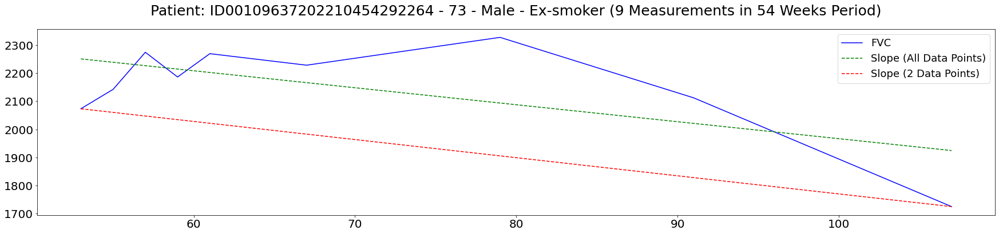

Patient: ID00110637202210673668310 FVC Statistical Summary
----------------------------------------------------------
Mean: 1451.12  -  Median: 1491.0  -  Std: 439.813
Min: 919 -  Max: 1995
Skew: -0.0911713  -  Kurtosis: -2.07405
----------------------------------------------------------
Change Mean: 153.714  - Change Median: 140.0  - Change Std: 108.351
Change Min: 19.0 -  Change Max: 350.0
Change Skew: 0.929002 -  Change Kurtosis: 0.984735
----------------------------------------------------------
Slope (Calculated with All Data Points): -28.1826
Slope (Calculated with 2 Data Points): -26.2439


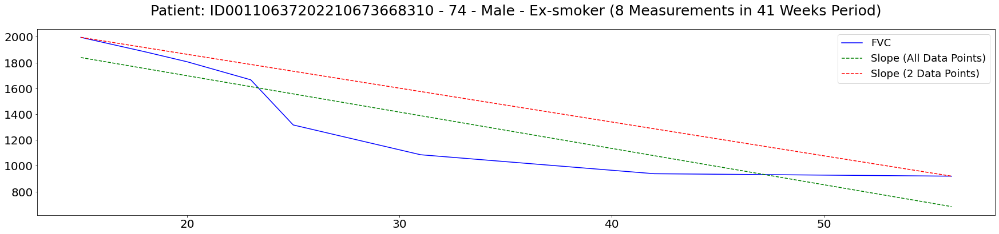

Patient: ID00111637202210956877205 FVC Statistical Summary
----------------------------------------------------------
Mean: 2283.14  -  Median: 2275.0  -  Std: 126.618
Min: 2083 -  Max: 2419
Skew: -0.448912  -  Kurtosis: -1.09424
----------------------------------------------------------
Change Mean: 92.3333  - Change Median: 67.0  - Change Std: 79.5102
Change Min: 19.0 -  Change Max: 219.0
Change Skew: 0.874259 -  Change Kurtosis: -0.61692
----------------------------------------------------------
Slope (Calculated with All Data Points): -11.6589
Slope (Calculated with 2 Data Points): -11.3333


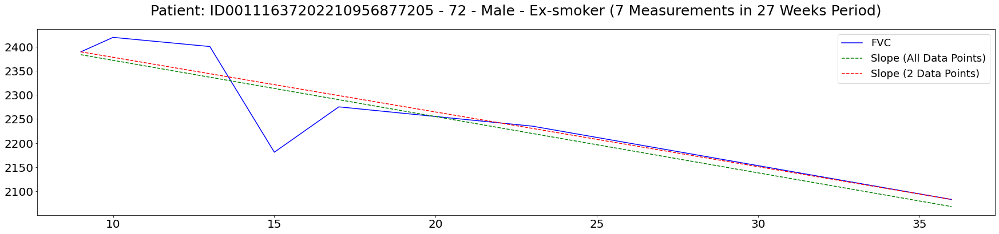

Patient: ID00115637202211874187958 FVC Statistical Summary
----------------------------------------------------------
Mean: 2405.25  -  Median: 2476.5  -  Std: 168.129
Min: 2134 -  Max: 2548
Skew: -1.10946  -  Kurtosis: -0.491499
----------------------------------------------------------
Change Mean: 144.286  - Change Median: 108.0  - Change Std: 135.633
Change Min: 22.0 -  Change Max: 351.0
Change Skew: 0.857128 -  Change Kurtosis: -1.10695
----------------------------------------------------------
Slope (Calculated with All Data Points): -6.40338
Slope (Calculated with 2 Data Points): -2.75676


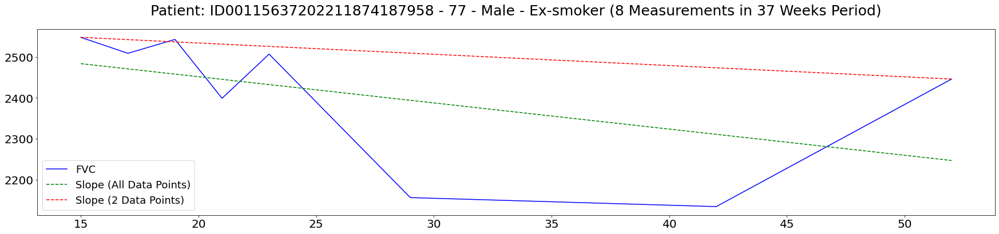

Patient: ID00117637202212360228007 FVC Statistical Summary
----------------------------------------------------------
Mean: 2921.67  -  Median: 2912.0  -  Std: 86.0247
Min: 2788 -  Max: 3037
Skew: -0.0613731  -  Kurtosis: -1.09148
----------------------------------------------------------
Change Mean: 102.25  - Change Median: 87.5  - Change Std: 60.116
Change Min: 34.0 -  Change Max: 234.0
Change Skew: 1.66492 -  Change Kurtosis: 3.65356
----------------------------------------------------------
Slope (Calculated with All Data Points): 1.9888
Slope (Calculated with 2 Data Points): 1.85714


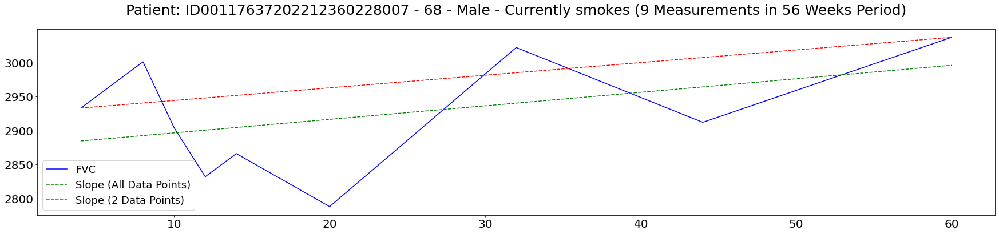

Patient: ID00119637202215426335765 FVC Statistical Summary
----------------------------------------------------------
Mean: 2916.4  -  Median: 2906.5  -  Std: 42.122
Min: 2851 -  Max: 2994
Skew: 0.528305  -  Kurtosis: 0.0243999
----------------------------------------------------------
Change Mean: 53.8889  - Change Median: 64.0  - Change Std: 31.7783
Change Min: 13.0 -  Change Max: 95.0
Change Skew: -0.327291 -  Change Kurtosis: -1.59453
----------------------------------------------------------
Slope (Calculated with All Data Points): 0.656382
Slope (Calculated with 2 Data Points): -0.157895


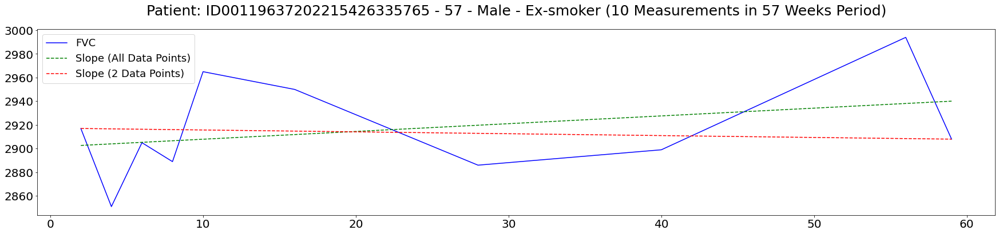

Patient: ID00122637202216437668965 FVC Statistical Summary
----------------------------------------------------------
Mean: 2296.89  -  Median: 2279.0  -  Std: 157.33
Min: 2091 -  Max: 2581
Skew: 0.466985  -  Kurtosis: -0.348351
----------------------------------------------------------
Change Mean: 63.5  - Change Median: 60.0  - Change Std: 48.3292
Change Min: 9.0 -  Change Max: 154.0
Change Skew: 0.917438 -  Change Kurtosis: 0.423985
----------------------------------------------------------
Slope (Calculated with All Data Points): -7.18235
Slope (Calculated with 2 Data Points): -7.90323


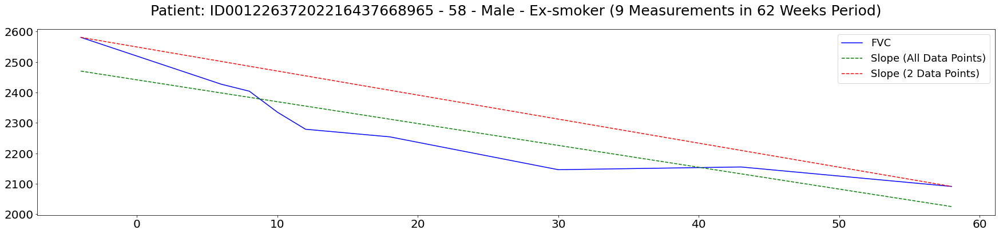

Patient: ID00123637202217151272140 FVC Statistical Summary
----------------------------------------------------------
Mean: 1588.56  -  Median: 1586.0  -  Std: 121.788
Min: 1406 -  Max: 1766
Skew: -0.167779  -  Kurtosis: -1.22298
----------------------------------------------------------
Change Mean: 76.5  - Change Median: 80.5  - Change Std: 38.9579
Change Min: 0.0 -  Change Max: 132.0
Change Skew: -0.906129 -  Change Kurtosis: 1.77055
----------------------------------------------------------
Slope (Calculated with All Data Points): -3.64625
Slope (Calculated with 2 Data Points): -2.0


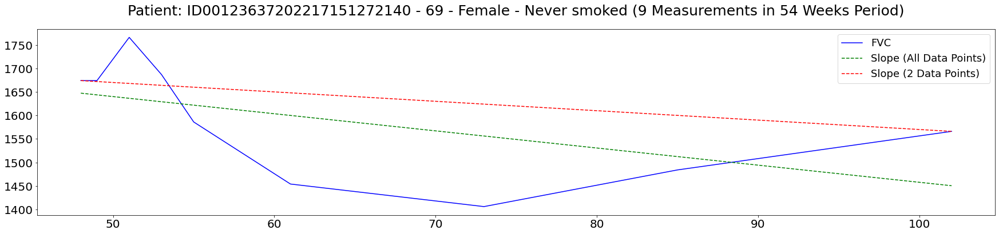

Patient: ID00124637202217596410344 FVC Statistical Summary
----------------------------------------------------------
Mean: 3493.22  -  Median: 3559.0  -  Std: 163.306
Min: 3146 -  Max: 3661
Skew: -1.31806  -  Kurtosis: 1.54761
----------------------------------------------------------
Change Mean: 109.375  - Change Median: 116.5  - Change Std: 62.833
Change Min: 28.0 -  Change Max: 204.0
Change Skew: 0.0590665 -  Change Kurtosis: -1.37231
----------------------------------------------------------
Slope (Calculated with All Data Points): -7.77926
Slope (Calculated with 2 Data Points): -7.79245


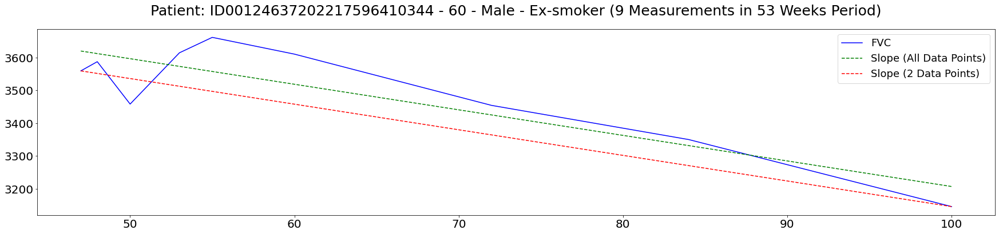

Patient: ID00125637202218590429387 FVC Statistical Summary
----------------------------------------------------------
Mean: 2239.0  -  Median: 2325.0  -  Std: 225.68
Min: 1872 -  Max: 2584
Skew: -0.289178  -  Kurtosis: -0.256422
----------------------------------------------------------
Change Mean: 135.286  - Change Median: 155.0  - Change Std: 106.597
Change Min: 7.0 -  Change Max: 247.0
Change Skew: -0.239952 -  Change Kurtosis: -2.27077
----------------------------------------------------------
Slope (Calculated with All Data Points): -15.2417
Slope (Calculated with 2 Data Points): -12.8919


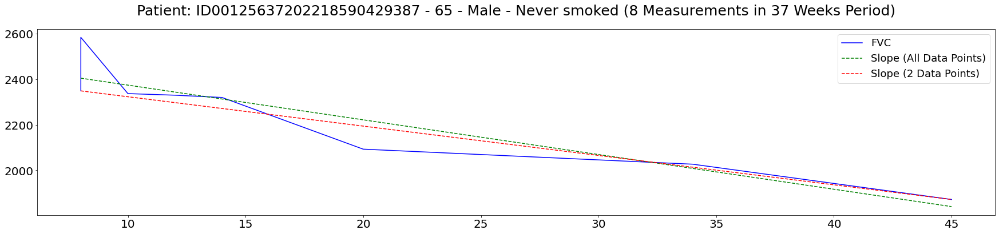

Patient: ID00126637202218610655908 FVC Statistical Summary
----------------------------------------------------------
Mean: 2308.56  -  Median: 2295.0  -  Std: 69.4732
Min: 2227 -  Max: 2455
Skew: 1.23529  -  Kurtosis: 1.65736
----------------------------------------------------------
Change Mean: 54.0  - Change Median: 34.5  - Change Std: 51.5807
Change Min: 5.0 -  Change Max: 148.0
Change Skew: 0.887034 -  Change Kurtosis: -0.289844
----------------------------------------------------------
Slope (Calculated with All Data Points): 1.8966
Slope (Calculated with 2 Data Points): 1.33333


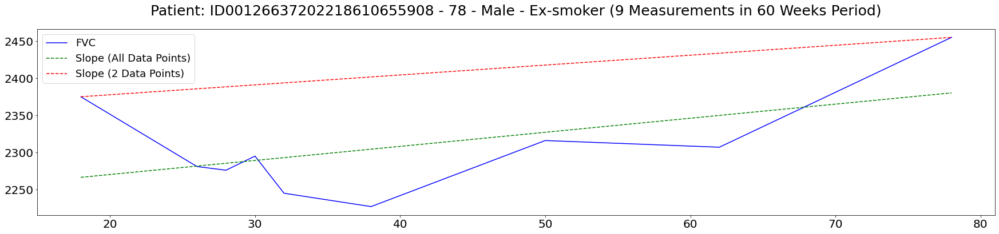

Patient: ID00127637202219096738943 FVC Statistical Summary
----------------------------------------------------------
Mean: 1664.44  -  Median: 1667.0  -  Std: 96.155
Min: 1533 -  Max: 1781
Skew: -0.0337982  -  Kurtosis: -1.56774
----------------------------------------------------------
Change Mean: 46.25  - Change Median: 37.5  - Change Std: 40.6545
Change Min: 2.0 -  Change Max: 104.0
Change Skew: 0.598737 -  Change Kurtosis: -1.24403
----------------------------------------------------------
Slope (Calculated with All Data Points): -4.28963
Slope (Calculated with 2 Data Points): -2.25


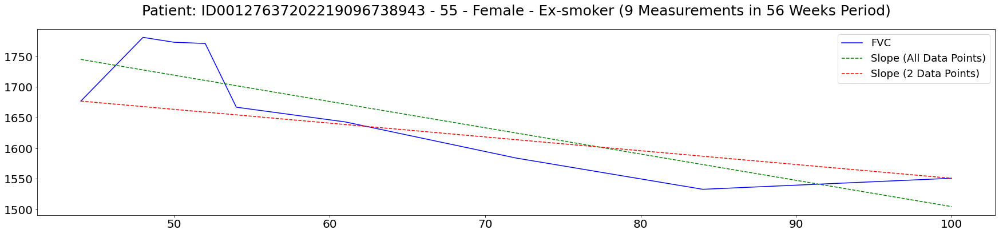

Patient: ID00128637202219474716089 FVC Statistical Summary
----------------------------------------------------------
Mean: 2175.43  -  Median: 2193.0  -  Std: 86.2513
Min: 2024 -  Max: 2274
Skew: -0.921702  -  Kurtosis: 0.264962
----------------------------------------------------------
Change Mean: 73.0  - Change Median: 66.0  - Change Std: 42.4547
Change Min: 19.0 -  Change Max: 139.0
Change Skew: 0.499303 -  Change Kurtosis: -0.102342
----------------------------------------------------------
Slope (Calculated with All Data Points): -8.91279
Slope (Calculated with 2 Data Points): -7.84


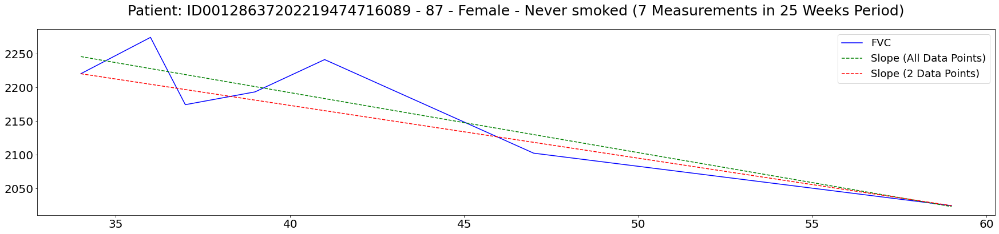

Patient: ID00129637202219868188000 FVC Statistical Summary
----------------------------------------------------------
Mean: 2234.22  -  Median: 2235.0  -  Std: 68.3077
Min: 2134 -  Max: 2333
Skew: -0.0191096  -  Kurtosis: -0.921363
----------------------------------------------------------
Change Mean: 65.375  - Change Median: 68.0  - Change Std: 24.4069
Change Min: 20.0 -  Change Max: 98.0
Change Skew: -0.643579 -  Change Kurtosis: 0.667732
----------------------------------------------------------
Slope (Calculated with All Data Points): -2.3353
Slope (Calculated with 2 Data Points): -2.125


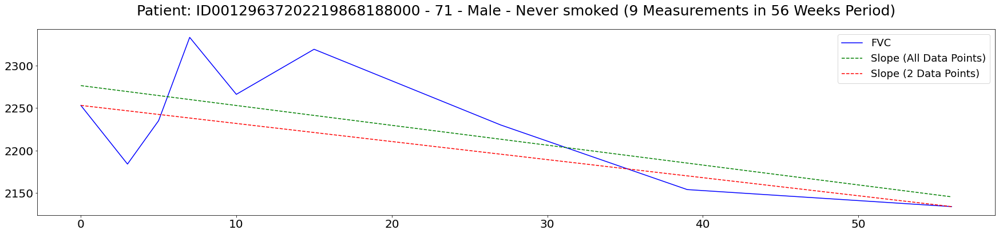

Patient: ID00130637202220059448013 FVC Statistical Summary
----------------------------------------------------------
Mean: 1482.33  -  Median: 1503.0  -  Std: 155.689
Min: 1197 -  Max: 1690
Skew: -0.490225  -  Kurtosis: -0.131234
----------------------------------------------------------
Change Mean: 70.125  - Change Median: 52.5  - Change Std: 41.2152
Change Min: 34.0 -  Change Max: 154.0
Change Skew: 1.38609 -  Change Kurtosis: 1.51121
----------------------------------------------------------
Slope (Calculated with All Data Points): -8.00338
Slope (Calculated with 2 Data Points): -9.30189


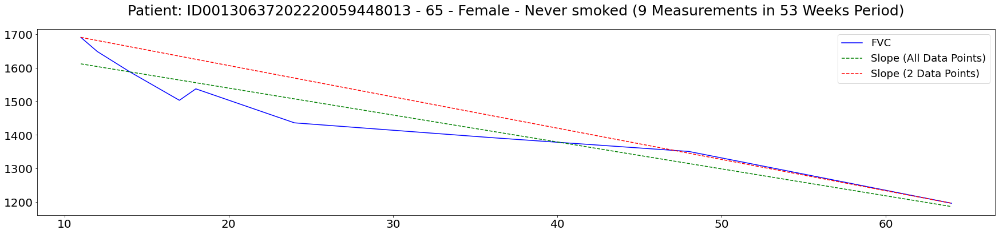

Patient: ID00131637202220424084844 FVC Statistical Summary
----------------------------------------------------------
Mean: 3272.89  -  Median: 3292.0  -  Std: 125.031
Min: 2990 -  Max: 3407
Skew: -1.5475  -  Kurtosis: 3.00186
----------------------------------------------------------
Change Mean: 93.125  - Change Median: 78.0  - Change Std: 64.6605
Change Min: 4.0 -  Change Max: 218.0
Change Skew: 0.860303 -  Change Kurtosis: 1.28511
----------------------------------------------------------
Slope (Calculated with All Data Points): -5.94791
Slope (Calculated with 2 Data Points): -6.35849


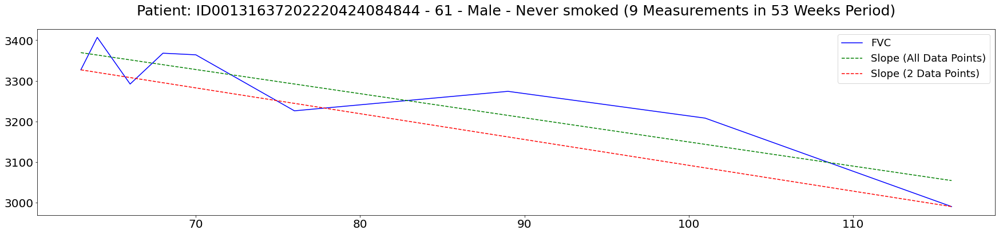

Patient: ID00132637202222178761324 FVC Statistical Summary
----------------------------------------------------------
Mean: 2623.56  -  Median: 2608.0  -  Std: 53.6612
Min: 2579 -  Max: 2743
Skew: 1.66116  -  Kurtosis: 2.51532
----------------------------------------------------------
Change Mean: 56.5  - Change Median: 39.0  - Change Std: 38.1987
Change Min: 20.0 -  Change Max: 129.0
Change Skew: 1.17662 -  Change Kurtosis: 0.378302
----------------------------------------------------------
Slope (Calculated with All Data Points): -0.658933
Slope (Calculated with 2 Data Points): 0.210526


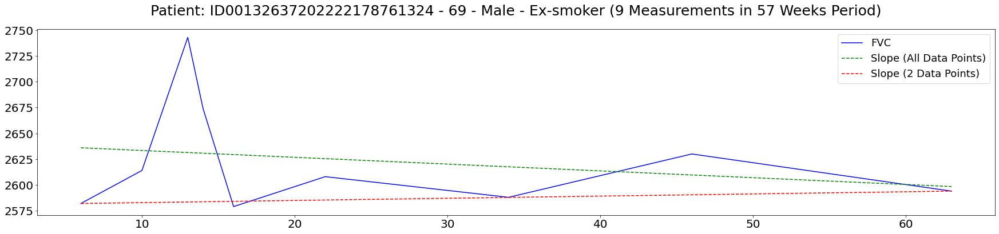

Patient: ID00133637202223847701934 FVC Statistical Summary
----------------------------------------------------------
Mean: 3111.67  -  Median: 3105.0  -  Std: 65.9773
Min: 3033 -  Max: 3203
Skew: 0.21562  -  Kurtosis: -1.50896
----------------------------------------------------------
Change Mean: 44.75  - Change Median: 37.0  - Change Std: 36.7841
Change Min: 8.0 -  Change Max: 106.0
Change Skew: 0.527476 -  Change Kurtosis: -1.20959
----------------------------------------------------------
Slope (Calculated with All Data Points): -2.90423
Slope (Calculated with 2 Data Points): -2.89286


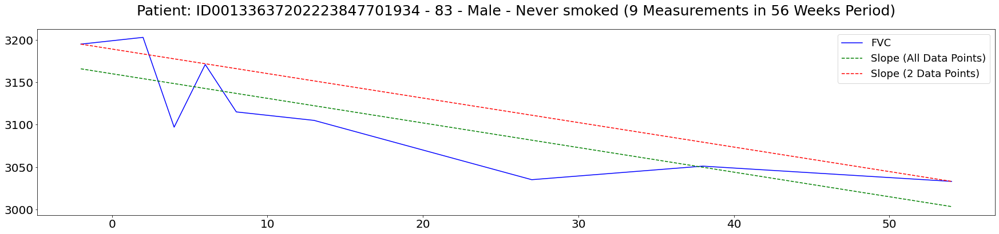

Patient: ID00134637202223873059688 FVC Statistical Summary
----------------------------------------------------------
Mean: 2502.89  -  Median: 2568.0  -  Std: 208.772
Min: 2112 -  Max: 2729
Skew: -1.06077  -  Kurtosis: 0.0359219
----------------------------------------------------------
Change Mean: 133.375  - Change Median: 117.5  - Change Std: 100.967
Change Min: 8.0 -  Change Max: 303.0
Change Skew: 0.744974 -  Change Kurtosis: -0.227831
----------------------------------------------------------
Slope (Calculated with All Data Points): -9.75655
Slope (Calculated with 2 Data Points): -6.96491


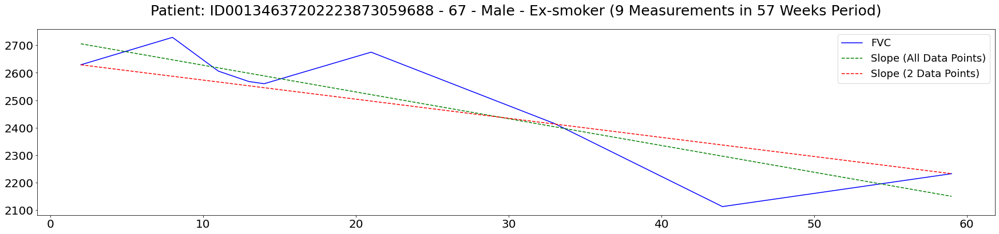

Patient: ID00135637202224630271439 FVC Statistical Summary
----------------------------------------------------------
Mean: 3913.22  -  Median: 3906.0  -  Std: 97.7417
Min: 3780 -  Max: 4087
Skew: 0.599287  -  Kurtosis: 0.0675131
----------------------------------------------------------
Change Mean: 103.625  - Change Median: 88.5  - Change Std: 88.5066
Change Min: 6.0 -  Change Max: 228.0
Change Skew: 0.4128 -  Change Kurtosis: -1.62821
----------------------------------------------------------
Slope (Calculated with All Data Points): -0.598364
Slope (Calculated with 2 Data Points): 1.60345


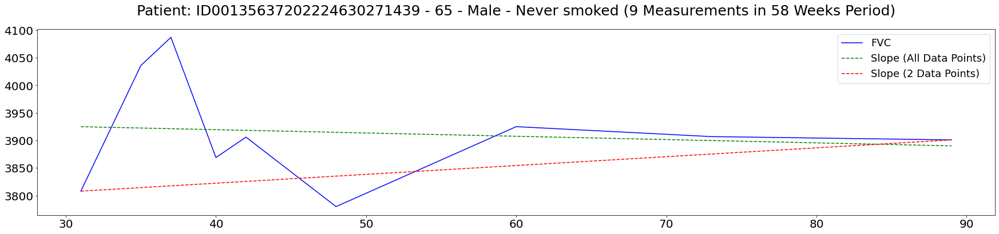

Patient: ID00136637202224951350618 FVC Statistical Summary
----------------------------------------------------------
Mean: 3305.22  -  Median: 3305.0  -  Std: 64.6776
Min: 3197 -  Max: 3390
Skew: -0.267008  -  Kurtosis: -0.821995
----------------------------------------------------------
Change Mean: 89.0  - Change Median: 91.0  - Change Std: 51.9285
Change Min: 19.0 -  Change Max: 165.0
Change Skew: 0.147006 -  Change Kurtosis: -0.872839
----------------------------------------------------------
Slope (Calculated with All Data Points): -1.14247
Slope (Calculated with 2 Data Points): -0.763636


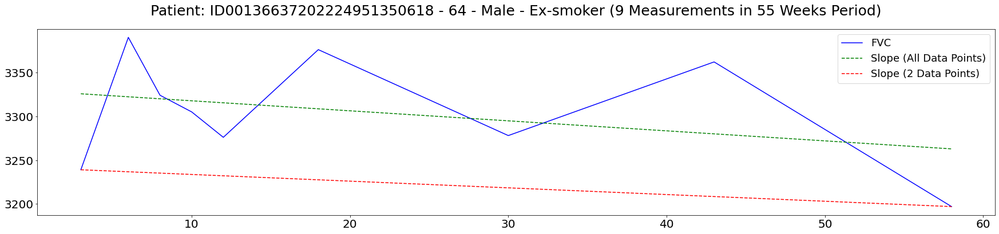

Patient: ID00138637202231603868088 FVC Statistical Summary
----------------------------------------------------------
Mean: 4310.78  -  Median: 4320.0  -  Std: 113.422
Min: 4151 -  Max: 4510
Skew: 0.474712  -  Kurtosis: -0.157578
----------------------------------------------------------
Change Mean: 75.875  - Change Median: 72.0  - Change Std: 37.1193
Change Min: 15.0 -  Change Max: 124.0
Change Skew: -0.206102 -  Change Kurtosis: -0.750304
----------------------------------------------------------
Slope (Calculated with All Data Points): -4.24043
Slope (Calculated with 2 Data Points): -6.41071


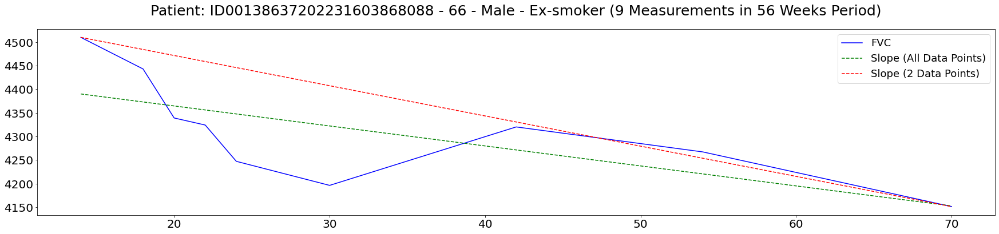

Patient: ID00139637202231703564336 FVC Statistical Summary
----------------------------------------------------------
Mean: 3893.78  -  Median: 3916.0  -  Std: 178.358
Min: 3568 -  Max: 4130
Skew: -0.494244  -  Kurtosis: -0.227759
----------------------------------------------------------
Change Mean: 153.125  - Change Median: 143.0  - Change Std: 78.0155
Change Min: 51.0 -  Change Max: 267.0
Change Skew: 0.172921 -  Change Kurtosis: -1.58758
----------------------------------------------------------
Slope (Calculated with All Data Points): -3.94448
Slope (Calculated with 2 Data Points): -3.94737


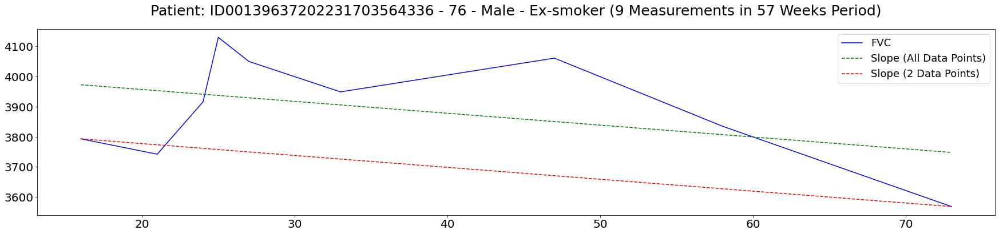

Patient: ID00140637202231728595149 FVC Statistical Summary
----------------------------------------------------------
Mean: 4035.9  -  Median: 4070.5  -  Std: 115.517
Min: 3852 -  Max: 4201
Skew: -0.475498  -  Kurtosis: -0.758916
----------------------------------------------------------
Change Mean: 105.444  - Change Median: 109.0  - Change Std: 58.6048
Change Min: 13.0 -  Change Max: 200.0
Change Skew: -0.0925399 -  Change Kurtosis: -0.361925
----------------------------------------------------------
Slope (Calculated with All Data Points): -1.51068
Slope (Calculated with 2 Data Points): -0.603448


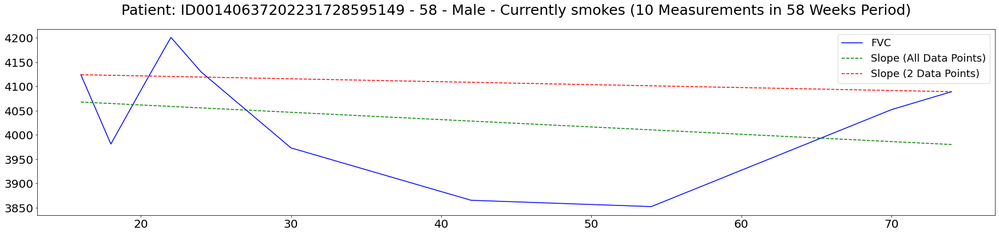

Patient: ID00149637202232704462834 FVC Statistical Summary
----------------------------------------------------------
Mean: 3082.0  -  Median: 3156.0  -  Std: 184.64
Min: 2686 -  Max: 3247
Skew: -1.36614  -  Kurtosis: 1.63763
----------------------------------------------------------
Change Mean: 106.125  - Change Median: 105.0  - Change Std: 97.7364
Change Min: 4.0 -  Change Max: 266.0
Change Skew: 0.419787 -  Change Kurtosis: -1.13591
----------------------------------------------------------
Slope (Calculated with All Data Points): -8.94053
Slope (Calculated with 2 Data Points): -10.0179


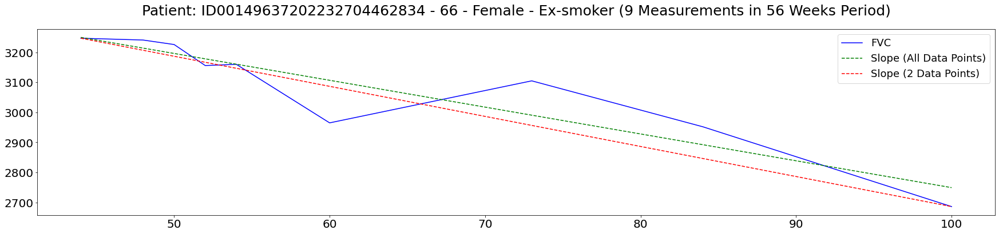

Patient: ID00161637202235731948764 FVC Statistical Summary
----------------------------------------------------------
Mean: 2868.78  -  Median: 2841.0  -  Std: 76.7948
Min: 2786 -  Max: 3017
Skew: 0.907524  -  Kurtosis: 0.0409979
----------------------------------------------------------
Change Mean: 82.625  - Change Median: 83.5  - Change Std: 43.4378
Change Min: 20.0 -  Change Max: 158.0
Change Skew: 0.259876 -  Change Kurtosis: 0.306371
----------------------------------------------------------
Slope (Calculated with All Data Points): -0.568472
Slope (Calculated with 2 Data Points): -0.433962


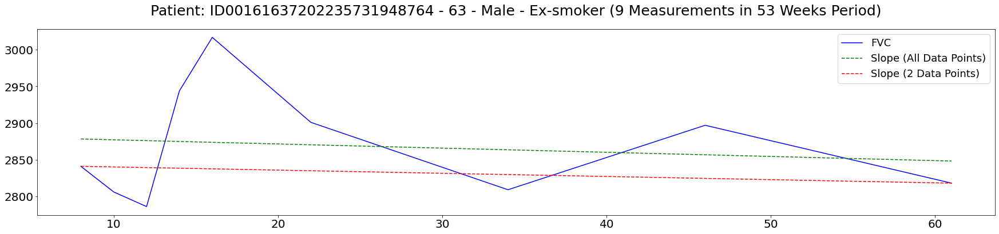

Patient: ID00165637202237320314458 FVC Statistical Summary
----------------------------------------------------------
Mean: 2149.89  -  Median: 2136.0  -  Std: 66.3428
Min: 2067 -  Max: 2296
Skew: 1.30453  -  Kurtosis: 2.55387
----------------------------------------------------------
Change Mean: 78.25  - Change Median: 69.5  - Change Std: 53.382
Change Min: 0.0 -  Change Max: 167.0
Change Skew: 0.397242 -  Change Kurtosis: -0.10972
----------------------------------------------------------
Slope (Calculated with All Data Points): 1.47501
Slope (Calculated with 2 Data Points): 1.51852


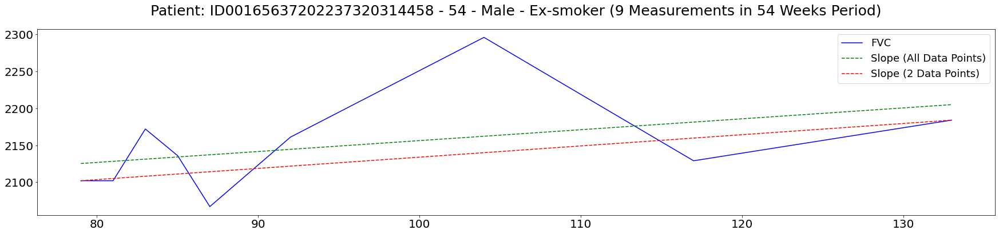

Patient: ID00167637202237397919352 FVC Statistical Summary
----------------------------------------------------------
Mean: 4481.9  -  Median: 4549.5  -  Std: 295.477
Min: 3744 -  Max: 4791
Skew: -1.94815  -  Kurtosis: 4.54332
----------------------------------------------------------
Change Mean: 156.889  - Change Median: 113.0  - Change Std: 159.07
Change Min: 27.0 -  Change Max: 544.0
Change Skew: 2.11813 -  Change Kurtosis: 5.09832
----------------------------------------------------------
Slope (Calculated with All Data Points): -11.6274
Slope (Calculated with 2 Data Points): -13.8644


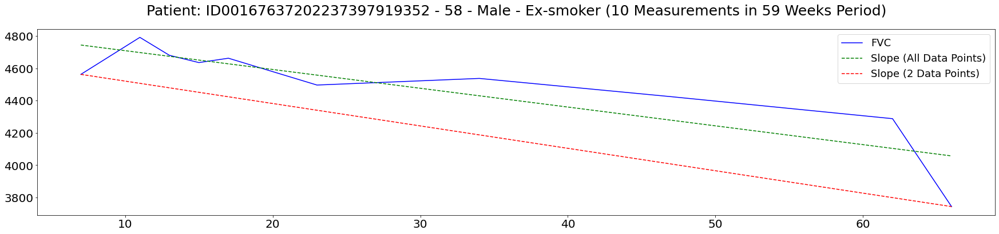

Patient: ID00168637202237852027833 FVC Statistical Summary
----------------------------------------------------------
Mean: 2973.89  -  Median: 2993.0  -  Std: 165.957
Min: 2711 -  Max: 3186
Skew: -0.447704  -  Kurtosis: -1.02478
----------------------------------------------------------
Change Mean: 83.375  - Change Median: 78.5  - Change Std: 37.0326
Change Min: 48.0 -  Change Max: 150.0
Change Skew: 0.771571 -  Change Kurtosis: -0.306821
----------------------------------------------------------
Slope (Calculated with All Data Points): -8.51575
Slope (Calculated with 2 Data Points): -8.96226


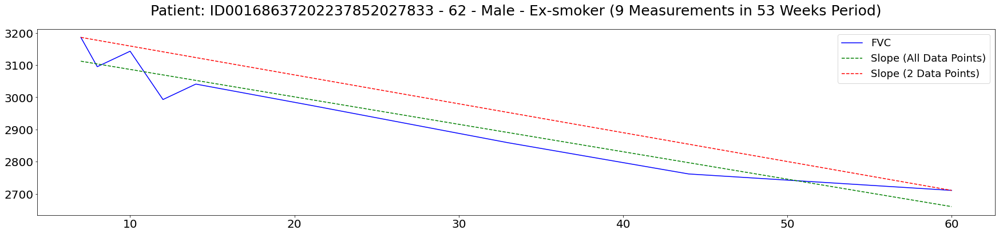

Patient: ID00169637202238024117706 FVC Statistical Summary
----------------------------------------------------------
Mean: 2463.22  -  Median: 2480.0  -  Std: 78.1645
Min: 2263 -  Max: 2527
Skew: -2.54221  -  Kurtosis: 7.15866
----------------------------------------------------------
Change Mean: 49.875  - Change Median: 32.5  - Change Std: 65.8471
Change Min: 6.0 -  Change Max: 208.0
Change Skew: 2.50477 -  Change Kurtosis: 6.64207
----------------------------------------------------------
Slope (Calculated with All Data Points): -3.07974
Slope (Calculated with 2 Data Points): -4.75926


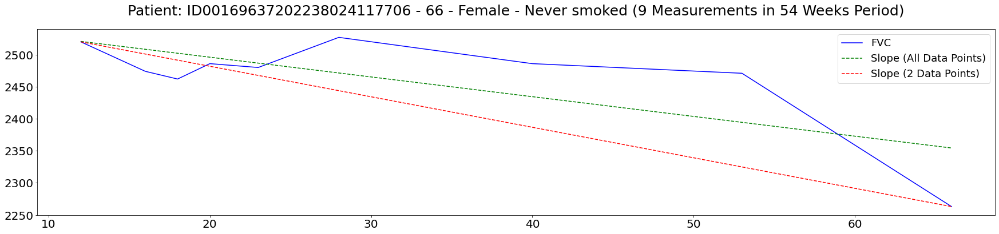

Patient: ID00170637202238079193844 FVC Statistical Summary
----------------------------------------------------------
Mean: 2209.44  -  Median: 2205.0  -  Std: 173.192
Min: 1970 -  Max: 2474
Skew: 0.0850409  -  Kurtosis: -1.223
----------------------------------------------------------
Change Mean: 188.75  - Change Median: 138.5  - Change Std: 150.512
Change Min: 50.0 -  Change Max: 504.0
Change Skew: 1.4757 -  Change Kurtosis: 2.2035
----------------------------------------------------------
Slope (Calculated with All Data Points): 4.67762
Slope (Calculated with 2 Data Points): 7.2069


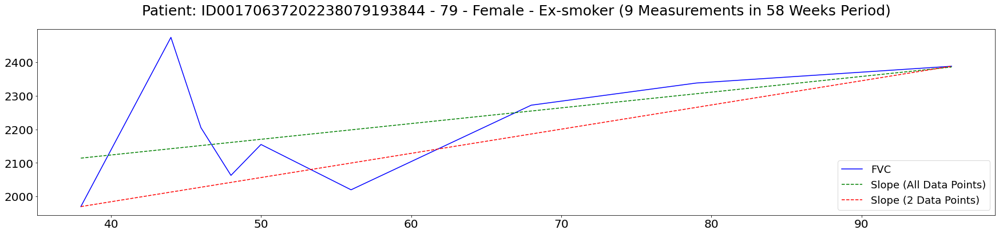

Patient: ID00172637202238316925179 FVC Statistical Summary
----------------------------------------------------------
Mean: 2740.67  -  Median: 2749.0  -  Std: 82.6544
Min: 2603 -  Max: 2833
Skew: -0.712693  -  Kurtosis: -0.543181
----------------------------------------------------------
Change Mean: 62.25  - Change Median: 43.5  - Change Std: 60.0042
Change Min: 3.0 -  Change Max: 178.0
Change Skew: 1.09036 -  Change Kurtosis: 0.637356
----------------------------------------------------------
Slope (Calculated with All Data Points): -0.576741
Slope (Calculated with 2 Data Points): 0.350877


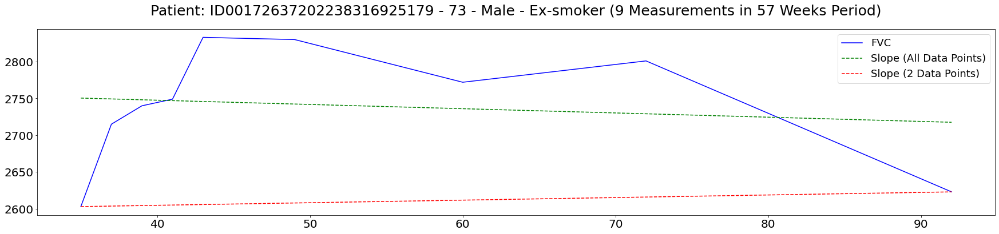

Patient: ID00173637202238329754031 FVC Statistical Summary
----------------------------------------------------------
Mean: 2719.67  -  Median: 2697.0  -  Std: 120.43
Min: 2563 -  Max: 2889
Skew: 0.197104  -  Kurtosis: -1.4008
----------------------------------------------------------
Change Mean: 70.875  - Change Median: 64.5  - Change Std: 50.6964
Change Min: 13.0 -  Change Max: 143.0
Change Skew: 0.348054 -  Change Kurtosis: -1.62363
----------------------------------------------------------
Slope (Calculated with All Data Points): -4.2635
Slope (Calculated with 2 Data Points): -1.46552


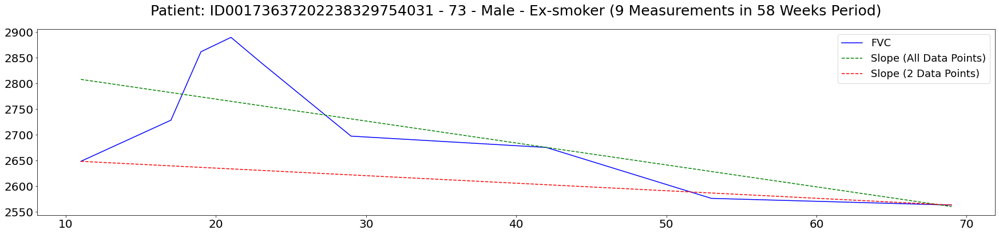

Patient: ID00180637202240177410333 FVC Statistical Summary
----------------------------------------------------------
Mean: 2957.44  -  Median: 2962.0  -  Std: 110.533
Min: 2761 -  Max: 3102
Skew: -0.529043  -  Kurtosis: -0.533487
----------------------------------------------------------
Change Mean: 103.375  - Change Median: 102.0  - Change Std: 55.8594
Change Min: 5.0 -  Change Max: 183.0
Change Skew: -0.463323 -  Change Kurtosis: 0.210156
----------------------------------------------------------
Slope (Calculated with All Data Points): -4.47151
Slope (Calculated with 2 Data Points): -2.75926


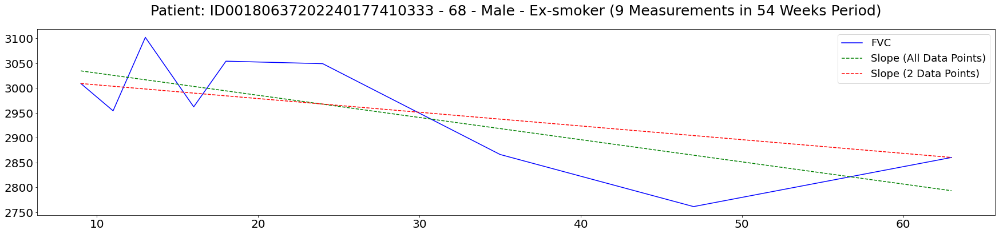

Patient: ID00183637202241995351650 FVC Statistical Summary
----------------------------------------------------------
Mean: 2429.11  -  Median: 2427.0  -  Std: 75.0857
Min: 2346 -  Max: 2541
Skew: 0.463542  -  Kurtosis: -1.13688
----------------------------------------------------------
Change Mean: 66.25  - Change Median: 72.0  - Change Std: 58.1199
Change Min: 4.0 -  Change Max: 183.0
Change Skew: 1.0481 -  Change Kurtosis: 1.6034
----------------------------------------------------------
Slope (Calculated with All Data Points): 0.405563
Slope (Calculated with 2 Data Points): -2.69091


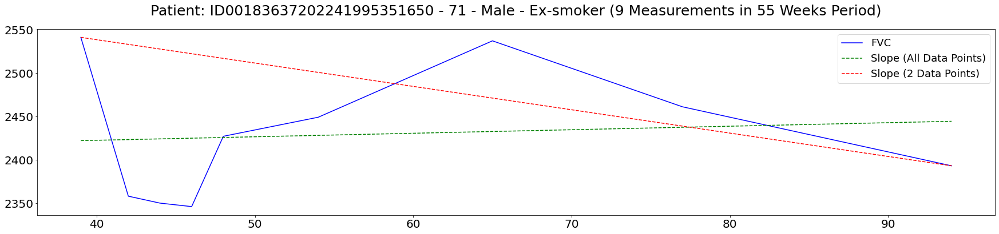

Patient: ID00184637202242062969203 FVC Statistical Summary
----------------------------------------------------------
Mean: 2999.11  -  Median: 3009.0  -  Std: 162.529
Min: 2743 -  Max: 3197
Skew: -0.55757  -  Kurtosis: -0.616565
----------------------------------------------------------
Change Mean: 209.875  - Change Median: 199.0  - Change Std: 115.848
Change Min: 30.0 -  Change Max: 436.0
Change Skew: 0.675637 -  Change Kurtosis: 2.11143
----------------------------------------------------------
Slope (Calculated with All Data Points): -4.07041
Slope (Calculated with 2 Data Points): -7.16667


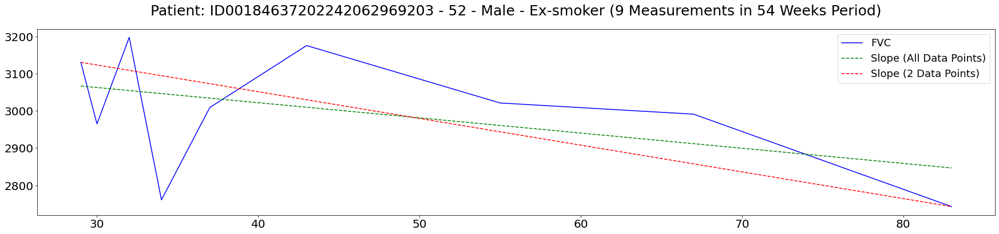

Patient: ID00186637202242472088675 FVC Statistical Summary
----------------------------------------------------------
Mean: 2657.14  -  Median: 2759.0  -  Std: 314.458
Min: 2119 -  Max: 3096
Skew: -0.569342  -  Kurtosis: 0.560611
----------------------------------------------------------
Change Mean: 177.833  - Change Median: 165.5  - Change Std: 115.122
Change Min: 45.0 -  Change Max: 315.0
Change Skew: 0.221786 -  Change Kurtosis: -1.8171
----------------------------------------------------------
Slope (Calculated with All Data Points): -16.1217
Slope (Calculated with 2 Data Points): -19.1569


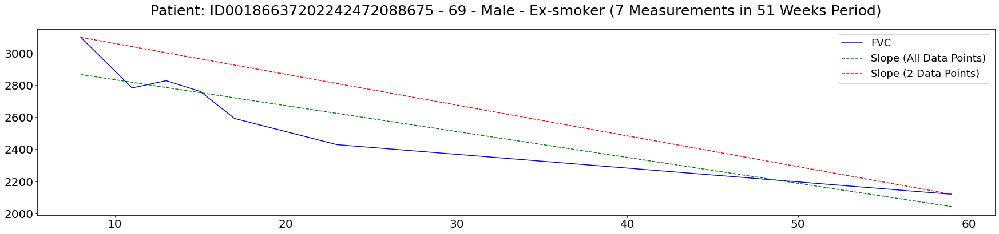

Patient: ID00190637202244450116191 FVC Statistical Summary
----------------------------------------------------------
Mean: 4350.33  -  Median: 4330.0  -  Std: 122.26
Min: 4169 -  Max: 4490
Skew: -0.269737  -  Kurtosis: -1.41942
----------------------------------------------------------
Change Mean: 107.25  - Change Median: 91.5  - Change Std: 95.3846
Change Min: 2.0 -  Change Max: 268.0
Change Skew: 0.575479 -  Change Kurtosis: -0.903066
----------------------------------------------------------
Slope (Calculated with All Data Points): -1.3071
Slope (Calculated with 2 Data Points): 2.93103


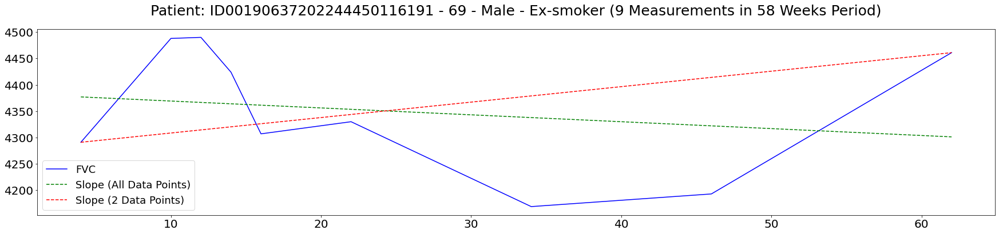

Patient: ID00192637202245493238298 FVC Statistical Summary
----------------------------------------------------------
Mean: 1782.78  -  Median: 1829.0  -  Std: 114.376
Min: 1568 -  Max: 1929
Skew: -0.843985  -  Kurtosis: 0.0886456
----------------------------------------------------------
Change Mean: 87.0  - Change Median: 51.5  - Change Std: 71.3322
Change Min: 21.0 -  Change Max: 201.0
Change Skew: 1.19591 -  Change Kurtosis: -0.341709
----------------------------------------------------------
Slope (Calculated with All Data Points): -4.2086
Slope (Calculated with 2 Data Points): -2.62295


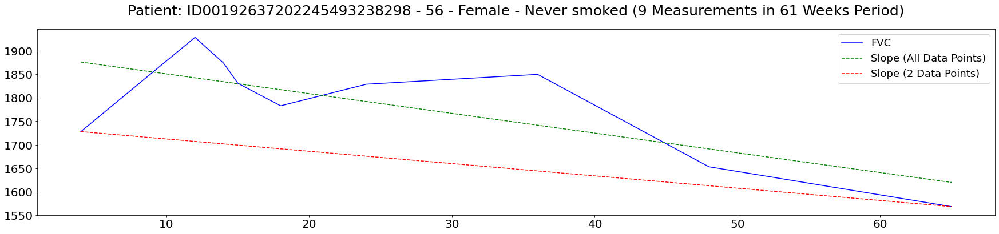

Patient: ID00196637202246668775836 FVC Statistical Summary
----------------------------------------------------------
Mean: 3907.89  -  Median: 3856.0  -  Std: 175.753
Min: 3792 -  Max: 4360
Skew: 2.61321  -  Kurtosis: 7.27874
----------------------------------------------------------
Change Mean: 155.375  - Change Median: 57.0  - Change Std: 209.443
Change Min: 19.0 -  Change Max: 549.0
Change Skew: 1.50636 -  Change Kurtosis: 0.585202
----------------------------------------------------------
Slope (Calculated with All Data Points): -1.08056
Slope (Calculated with 2 Data Points): 0.122807


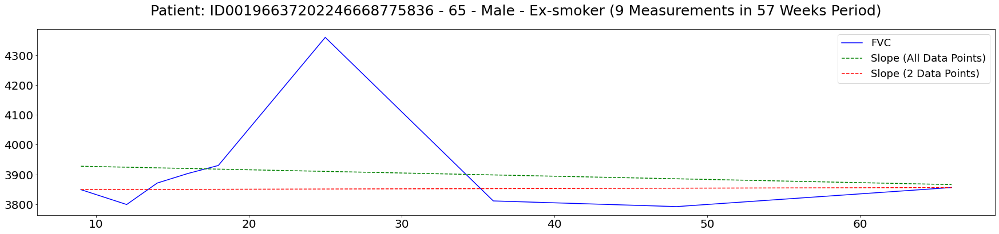

Patient: ID00197637202246865691526 FVC Statistical Summary
----------------------------------------------------------
Mean: 2512.56  -  Median: 2360.0  -  Std: 532.78
Min: 1941 -  Max: 3399
Skew: 0.809177  -  Kurtosis: -0.600901
----------------------------------------------------------
Change Mean: 646.375  - Change Median: 434.5  - Change Std: 465.064
Change Min: 168.0 -  Change Max: 1458.0
Change Skew: 0.832668 -  Change Kurtosis: -0.71247
----------------------------------------------------------
Slope (Calculated with All Data Points): 14.6826
Slope (Calculated with 2 Data Points): 8.89474


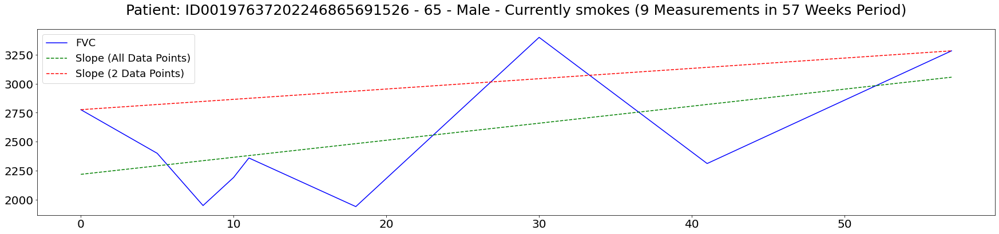

Patient: ID00199637202248141386743 FVC Statistical Summary
----------------------------------------------------------
Mean: 2814.44  -  Median: 2844.0  -  Std: 106.27
Min: 2672 -  Max: 2949
Skew: -0.462282  -  Kurtosis: -1.58164
----------------------------------------------------------
Change Mean: 92.875  - Change Median: 63.0  - Change Std: 81.0563
Change Min: 11.0 -  Change Max: 221.0
Change Skew: 0.613109 -  Change Kurtosis: -1.33239
----------------------------------------------------------
Slope (Calculated with All Data Points): 1.86715
Slope (Calculated with 2 Data Points): 4.17308


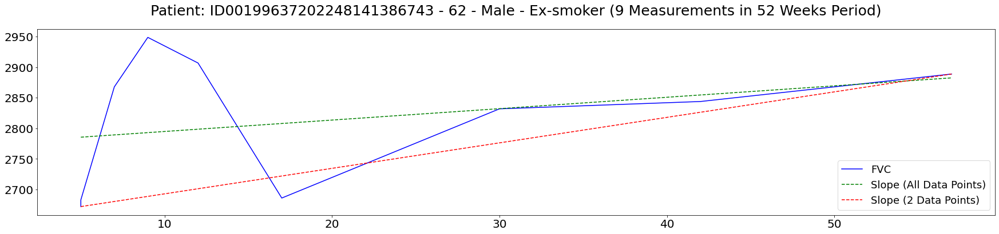

Patient: ID00202637202249376026949 FVC Statistical Summary
----------------------------------------------------------
Mean: 4059.89  -  Median: 4092.0  -  Std: 260.16
Min: 3641 -  Max: 4316
Skew: -0.906282  -  Kurtosis: -0.422031
----------------------------------------------------------
Change Mean: 109.375  - Change Median: 57.5  - Change Std: 127.664
Change Min: 5.0 -  Change Max: 399.0
Change Skew: 2.02664 -  Change Kurtosis: 4.44338
----------------------------------------------------------
Slope (Calculated with All Data Points): -12.6832
Slope (Calculated with 2 Data Points): -12.0909


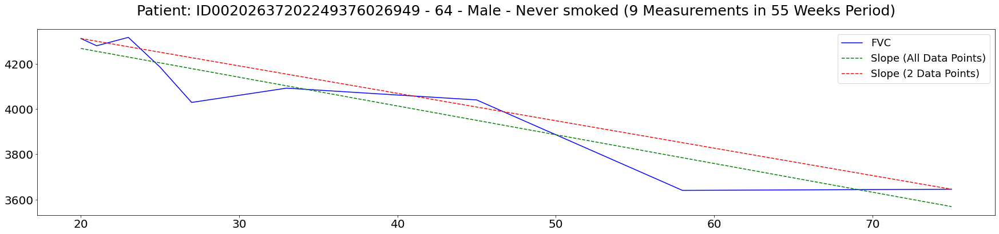

Patient: ID00207637202252526380974 FVC Statistical Summary
----------------------------------------------------------
Mean: 2682.11  -  Median: 2722.0  -  Std: 173.889
Min: 2379 -  Max: 2924
Skew: -0.498835  -  Kurtosis: -0.520507
----------------------------------------------------------
Change Mean: 118.875  - Change Median: 102.5  - Change Std: 114.913
Change Min: 4.0 -  Change Max: 343.0
Change Skew: 1.02583 -  Change Kurtosis: 0.883297
----------------------------------------------------------
Slope (Calculated with All Data Points): -3.50646
Slope (Calculated with 2 Data Points): 2.77358


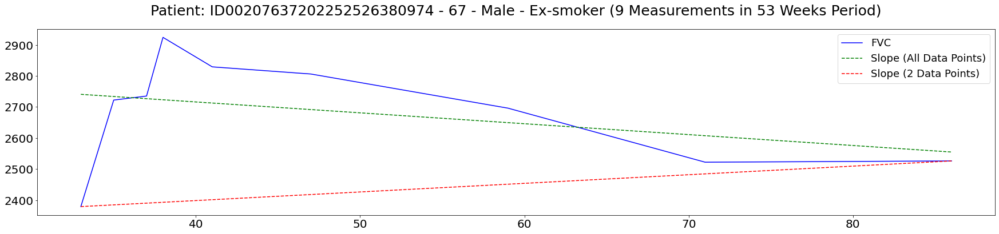

Patient: ID00210637202257228694086 FVC Statistical Summary
----------------------------------------------------------
Mean: 2827.33  -  Median: 2844.0  -  Std: 32.0858
Min: 2773 -  Max: 2860
Skew: -0.99832  -  Kurtosis: -0.613438
----------------------------------------------------------
Change Mean: 22.5  - Change Median: 10.5  - Change Std: 28.0
Change Min: 1.0 -  Change Max: 87.0
Change Skew: 2.14366 -  Change Kurtosis: 4.97448
----------------------------------------------------------
Slope (Calculated with All Data Points): 0.693772
Slope (Calculated with 2 Data Points): 0.107143


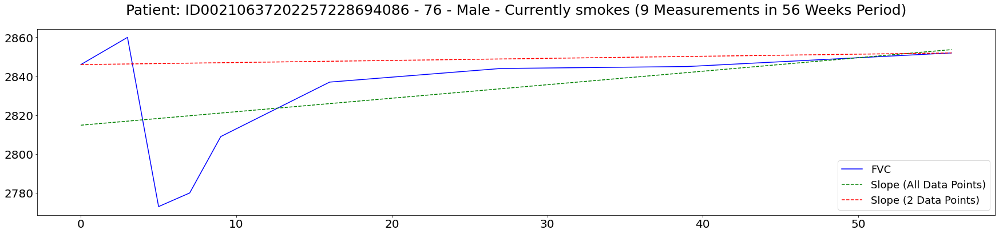

Patient: ID00213637202257692916109 FVC Statistical Summary
----------------------------------------------------------
Mean: 3131.33  -  Median: 3090.0  -  Std: 135.823
Min: 2972 -  Max: 3376
Skew: 0.791977  -  Kurtosis: -0.480199
----------------------------------------------------------
Change Mean: 207.5  - Change Median: 201.0  - Change Std: 114.945
Change Min: 69.0 -  Change Max: 341.0
Change Skew: 0.00570118 -  Change Kurtosis: -2.4107
----------------------------------------------------------
Slope (Calculated with All Data Points): -1.44889
Slope (Calculated with 2 Data Points): -0.327273


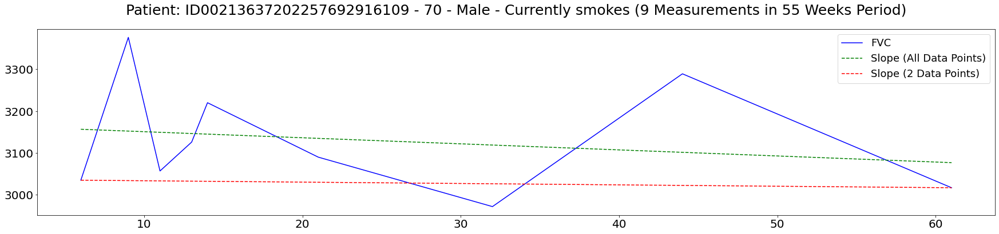

Patient: ID00214637202257820847190 FVC Statistical Summary
----------------------------------------------------------
Mean: 2867.78  -  Median: 2869.0  -  Std: 41.3726
Min: 2791 -  Max: 2929
Skew: -0.435468  -  Kurtosis: 0.460685
----------------------------------------------------------
Change Mean: 40.0  - Change Median: 40.5  - Change Std: 23.2809
Change Min: 16.0 -  Change Max: 83.0
Change Skew: 0.773755 -  Change Kurtosis: 0.183897
----------------------------------------------------------
Slope (Calculated with All Data Points): -1.56416
Slope (Calculated with 2 Data Points): -1.5


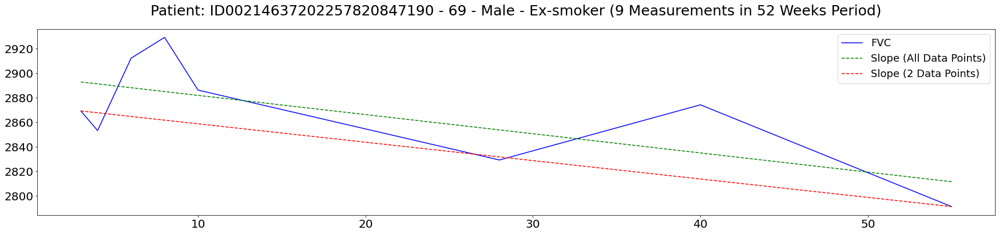

Patient: ID00216637202257988213445 FVC Statistical Summary
----------------------------------------------------------
Mean: 2224.0  -  Median: 2157.0  -  Std: 205.258
Min: 1997 -  Max: 2658
Skew: 1.33639  -  Kurtosis: 1.54922
----------------------------------------------------------
Change Mean: 181.875  - Change Median: 146.0  - Change Std: 122.601
Change Min: 24.0 -  Change Max: 369.0
Change Skew: 0.572068 -  Change Kurtosis: -0.88878
----------------------------------------------------------
Slope (Calculated with All Data Points): -3.38003
Slope (Calculated with 2 Data Points): -10.434


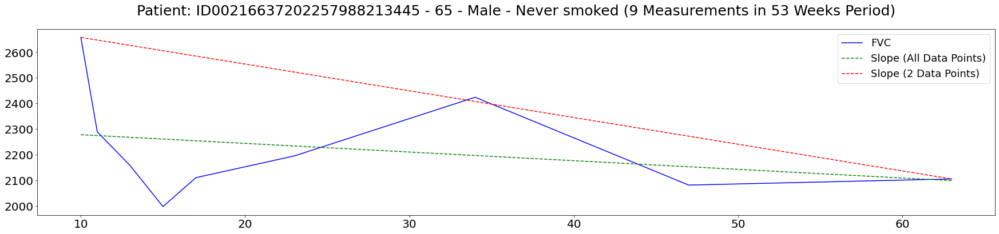

Patient: ID00218637202258156844710 FVC Statistical Summary
----------------------------------------------------------
Mean: 2615.78  -  Median: 2582.0  -  Std: 140.079
Min: 2439 -  Max: 2888
Skew: 1.16495  -  Kurtosis: 0.827429
----------------------------------------------------------
Change Mean: 112.375  - Change Median: 70.5  - Change Std: 116.767
Change Min: 18.0 -  Change Max: 361.0
Change Skew: 1.67703 -  Change Kurtosis: 2.58655
----------------------------------------------------------
Slope (Calculated with All Data Points): 3.97016
Slope (Calculated with 2 Data Points): 2.92727


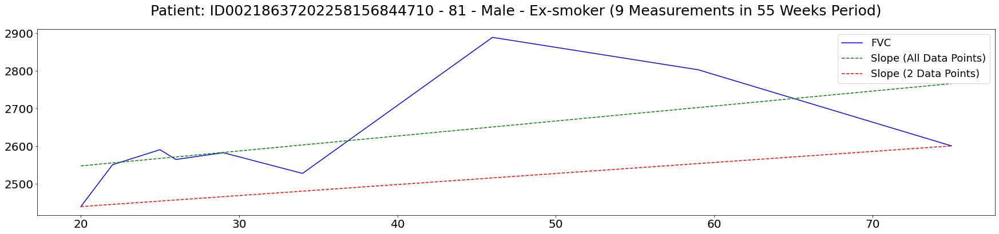

Patient: ID00219637202258203123958 FVC Statistical Summary
----------------------------------------------------------
Mean: 5845.44  -  Median: 5768.0  -  Std: 228.922
Min: 5613 -  Max: 6399
Skew: 2.01656  -  Kurtosis: 4.97073
----------------------------------------------------------
Change Mean: 233.625  - Change Median: 201.0  - Change Std: 214.613
Change Min: 24.0 -  Change Max: 721.0
Change Skew: 1.95888 -  Change Kurtosis: 4.64289
----------------------------------------------------------
Slope (Calculated with All Data Points): -3.87374
Slope (Calculated with 2 Data Points): -11.2679


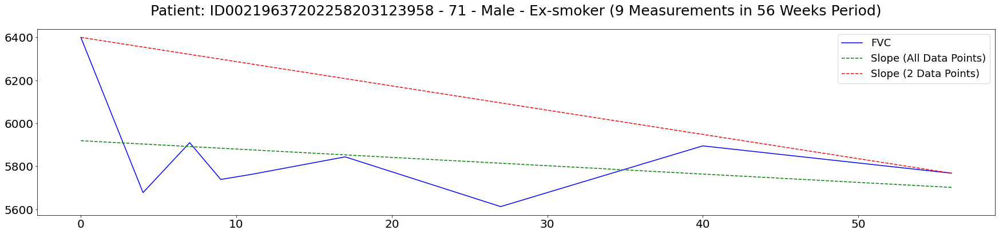

Patient: ID00221637202258717315571 FVC Statistical Summary
----------------------------------------------------------
Mean: 1414.33  -  Median: 1416.0  -  Std: 66.2344
Min: 1285 -  Max: 1529
Skew: -0.334169  -  Kurtosis: 1.82501
----------------------------------------------------------
Change Mean: 58.25  - Change Median: 69.0  - Change Std: 33.1953
Change Min: 8.0 -  Change Max: 106.0
Change Skew: -0.440938 -  Change Kurtosis: -0.559594
----------------------------------------------------------
Slope (Calculated with All Data Points): -1.85029
Slope (Calculated with 2 Data Points): -2.18868


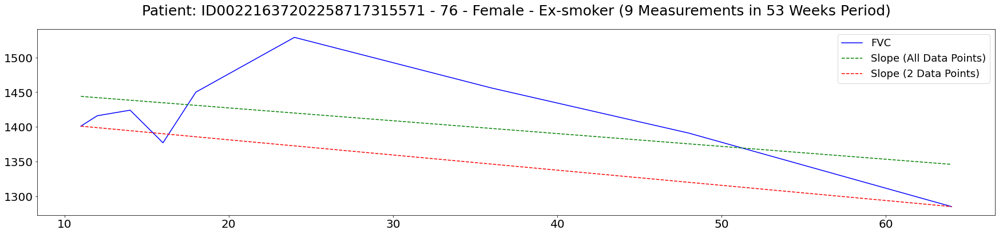

Patient: ID00222637202259066229764 FVC Statistical Summary
----------------------------------------------------------
Mean: 2468.89  -  Median: 2492.0  -  Std: 117.425
Min: 2316 -  Max: 2644
Skew: 0.0561518  -  Kurtosis: -1.64099
----------------------------------------------------------
Change Mean: 102.75  - Change Median: 58.0  - Change Std: 105.486
Change Min: 9.0 -  Change Max: 299.0
Change Skew: 1.08285 -  Change Kurtosis: 0.0578707
----------------------------------------------------------
Slope (Calculated with All Data Points): -4.21213
Slope (Calculated with 2 Data Points): -5.65517


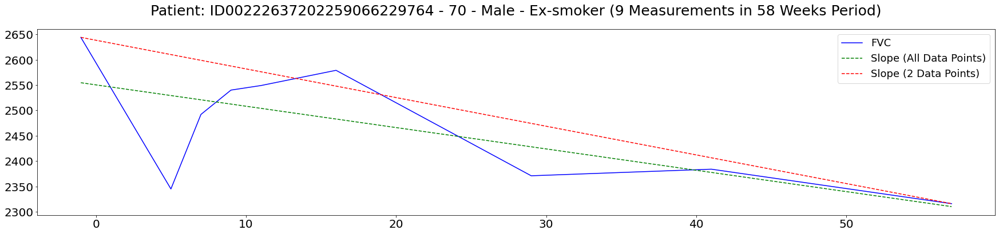

Patient: ID00224637202259281193413 FVC Statistical Summary
----------------------------------------------------------
Mean: 2692.67  -  Median: 2679.0  -  Std: 159.989
Min: 2388 -  Max: 2992
Skew: -0.00312745  -  Kurtosis: 2.32356
----------------------------------------------------------
Change Mean: 162.0  - Change Median: 111.0  - Change Std: 144.201
Change Min: 6.0 -  Change Max: 355.0
Change Skew: 0.395584 -  Change Kurtosis: -1.99873
----------------------------------------------------------
Slope (Calculated with All Data Points): 0.320381
Slope (Calculated with 2 Data Points): -3.27273


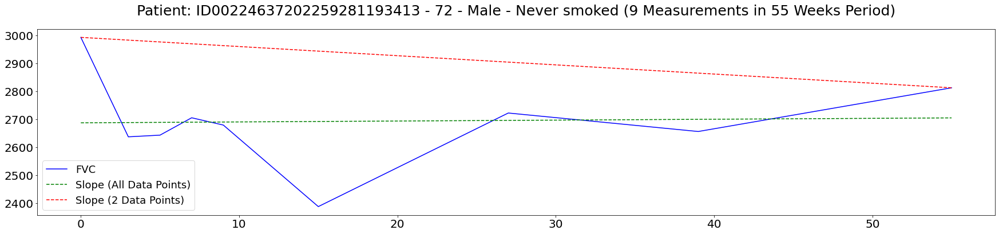

Patient: ID00225637202259339837603 FVC Statistical Summary
----------------------------------------------------------
Mean: 1026.25  -  Median: 985.5  -  Std: 237.997
Min: 827 -  Max: 1583
Skew: 2.21131  -  Kurtosis: 5.70318
----------------------------------------------------------
Change Mean: 119.286  - Change Median: 34.0  - Change Std: 210.464
Change Min: 1.0 -  Change Max: 582.0
Change Skew: 2.34276 -  Change Kurtosis: 5.64739
----------------------------------------------------------
Slope (Calculated with All Data Points): -7.46048
Slope (Calculated with 2 Data Points): -13.4821


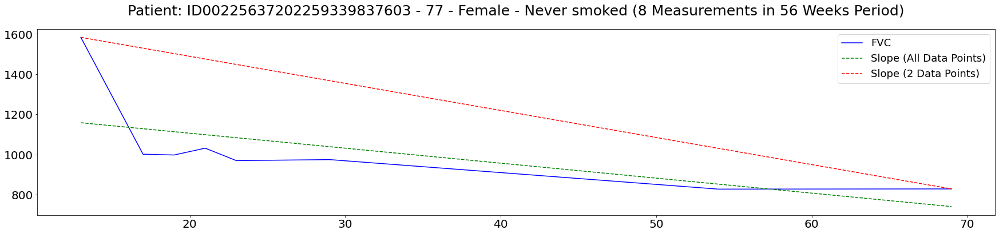

Patient: ID00228637202259965313869 FVC Statistical Summary
----------------------------------------------------------
Mean: 1818.11  -  Median: 1851.0  -  Std: 117.547
Min: 1657 -  Max: 1972
Skew: -0.460151  -  Kurtosis: -1.47258
----------------------------------------------------------
Change Mean: 85.875  - Change Median: 94.0  - Change Std: 71.8121
Change Min: 0.0 -  Change Max: 176.0
Change Skew: -0.0749532 -  Change Kurtosis: -2.07324
----------------------------------------------------------
Slope (Calculated with All Data Points): -5.13112
Slope (Calculated with 2 Data Points): -4.20755


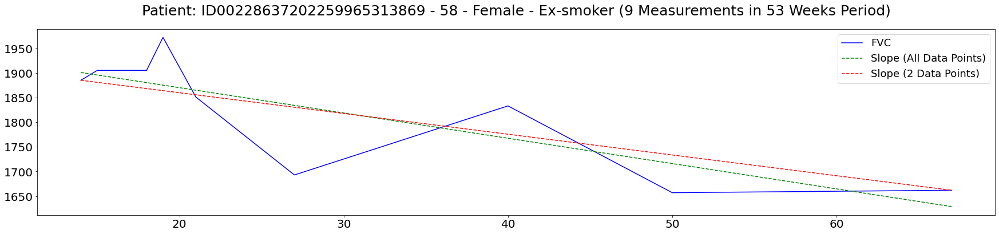

Patient: ID00229637202260254240583 FVC Statistical Summary
----------------------------------------------------------
Mean: 3483.8  -  Median: 3503.5  -  Std: 103.712
Min: 3342 -  Max: 3649
Skew: 0.0720158  -  Kurtosis: -1.10166
----------------------------------------------------------
Change Mean: 77.3333  - Change Median: 79.0  - Change Std: 47.9609
Change Min: 13.0 -  Change Max: 137.0
Change Skew: -0.203837 -  Change Kurtosis: -1.62421
----------------------------------------------------------
Slope (Calculated with All Data Points): -3.41031
Slope (Calculated with 2 Data Points): -2.98305


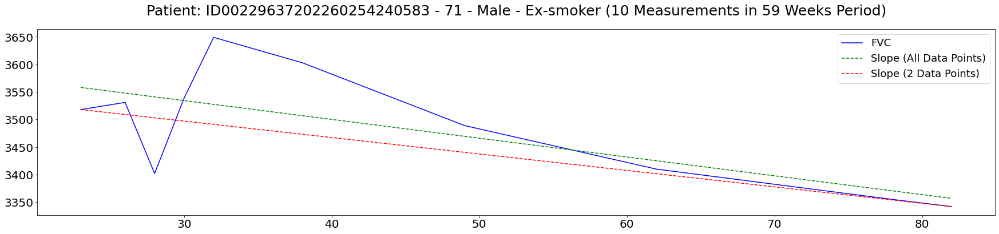

Patient: ID00232637202260377586117 FVC Statistical Summary
----------------------------------------------------------
Mean: 1901.11  -  Median: 1845.0  -  Std: 129.304
Min: 1732 -  Max: 2095
Skew: 0.60635  -  Kurtosis: -0.879146
----------------------------------------------------------
Change Mean: 153.25  - Change Median: 94.5  - Change Std: 127.605
Change Min: 32.0 -  Change Max: 363.0
Change Skew: 0.71978 -  Change Kurtosis: -1.2714
----------------------------------------------------------
Slope (Calculated with All Data Points): -1.40863
Slope (Calculated with 2 Data Points): -1.18519


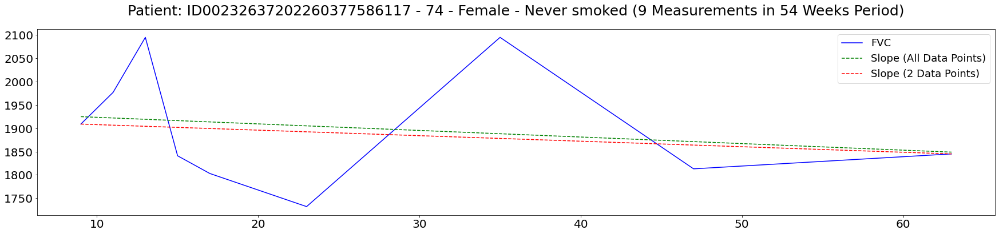

Patient: ID00233637202260580149633 FVC Statistical Summary
----------------------------------------------------------
Mean: 3554.33  -  Median: 3574.0  -  Std: 162.552
Min: 3252 -  Max: 3829
Skew: -0.266742  -  Kurtosis: 1.05001
----------------------------------------------------------
Change Mean: 167.625  - Change Median: 137.0  - Change Std: 134.811
Change Min: 10.0 -  Change Max: 362.0
Change Skew: 0.372327 -  Change Kurtosis: -1.60731
----------------------------------------------------------
Slope (Calculated with All Data Points): -4.1857
Slope (Calculated with 2 Data Points): -4.36842


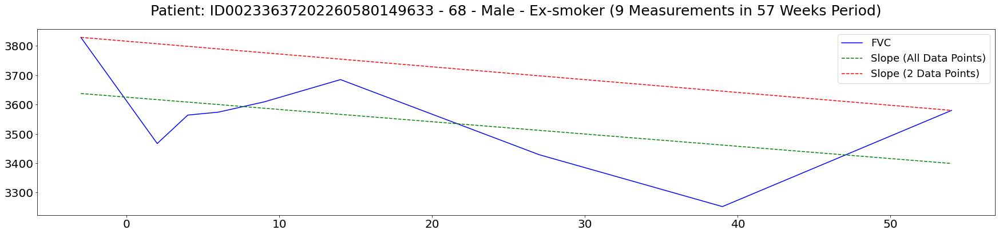

Patient: ID00234637202261078001846 FVC Statistical Summary
----------------------------------------------------------
Mean: 1922.75  -  Median: 1949.5  -  Std: 122.953
Min: 1756 -  Max: 2080
Skew: -0.278989  -  Kurtosis: -1.65293
----------------------------------------------------------
Change Mean: 178.714  - Change Median: 233.0  - Change Std: 91.3888
Change Min: 49.0 -  Change Max: 253.0
Change Skew: -0.819281 -  Change Kurtosis: -1.49261
----------------------------------------------------------
Slope (Calculated with All Data Points): -2.28099
Slope (Calculated with 2 Data Points): -4.81579


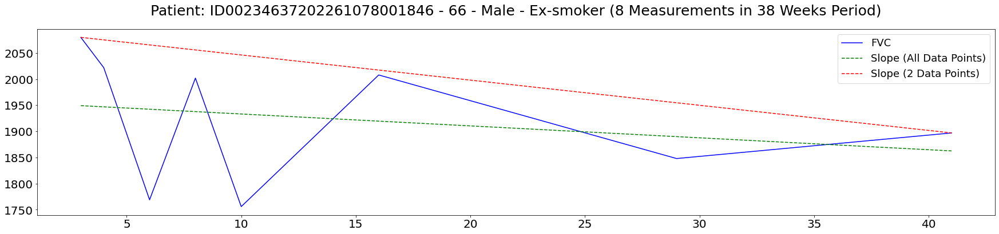

Patient: ID00235637202261451839085 FVC Statistical Summary
----------------------------------------------------------
Mean: 2143.56  -  Median: 2129.0  -  Std: 57.1929
Min: 2061 -  Max: 2257
Skew: 0.751635  -  Kurtosis: 1.00279
----------------------------------------------------------
Change Mean: 53.75  - Change Median: 58.0  - Change Std: 18.5761
Change Min: 22.0 -  Change Max: 78.0
Change Skew: -0.625689 -  Change Kurtosis: -0.361417
----------------------------------------------------------
Slope (Calculated with All Data Points): 2.55715
Slope (Calculated with 2 Data Points): 3.62963


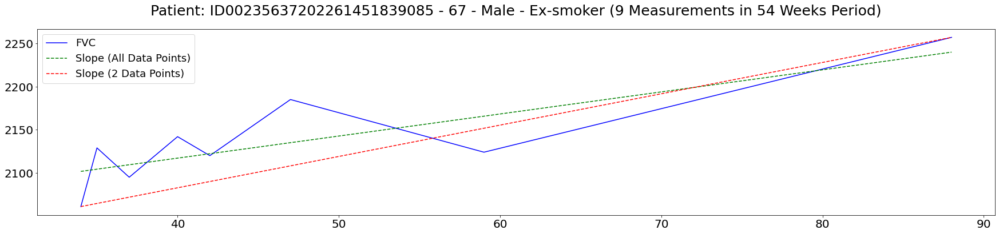

Patient: ID00240637202264138860065 FVC Statistical Summary
----------------------------------------------------------
Mean: 2815.67  -  Median: 2782.0  -  Std: 175.967
Min: 2503 -  Max: 3132
Skew: 0.157272  -  Kurtosis: 1.19697
----------------------------------------------------------
Change Mean: 131.125  - Change Median: 103.5  - Change Std: 100.624
Change Min: 20.0 -  Change Max: 260.0
Change Skew: 0.315729 -  Change Kurtosis: -1.9415
----------------------------------------------------------
Slope (Calculated with All Data Points): -4.81608
Slope (Calculated with 2 Data Points): -4.01923


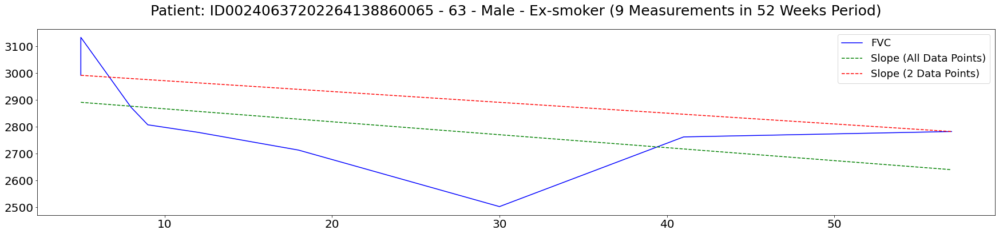

Patient: ID00241637202264294508775 FVC Statistical Summary
----------------------------------------------------------
Mean: 1328.0  -  Median: 1344.0  -  Std: 61.6543
Min: 1188 -  Max: 1399
Skew: -1.5698  -  Kurtosis: 3.17616
----------------------------------------------------------
Change Mean: 35.625  - Change Median: 27.5  - Change Std: 28.4401
Change Min: 13.0 -  Change Max: 102.0
Change Skew: 2.2345 -  Change Kurtosis: 5.51107
----------------------------------------------------------
Slope (Calculated with All Data Points): -3.13047
Slope (Calculated with 2 Data Points): -3.90741


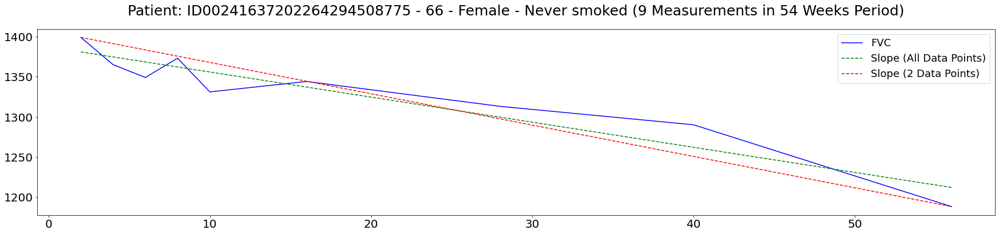

Patient: ID00242637202264759739921 FVC Statistical Summary
----------------------------------------------------------
Mean: 1775.0  -  Median: 1785.0  -  Std: 97.1146
Min: 1631 -  Max: 1918
Skew: -0.283142  -  Kurtosis: -0.896655
----------------------------------------------------------
Change Mean: 109.25  - Change Median: 113.5  - Change Std: 58.7531
Change Min: 13.0 -  Change Max: 212.0
Change Skew: 0.0862609 -  Change Kurtosis: 1.00596
----------------------------------------------------------
Slope (Calculated with All Data Points): -2.58405
Slope (Calculated with 2 Data Points): -1.7037


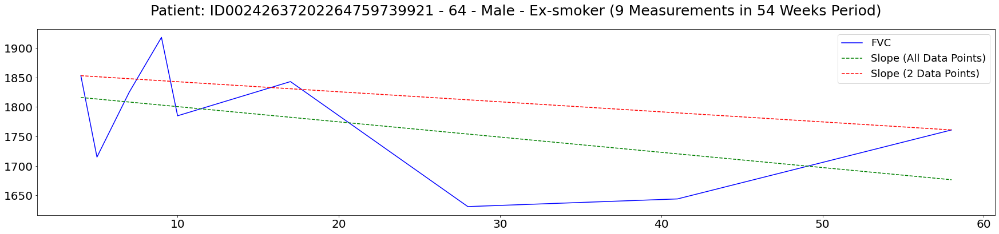

Patient: ID00248637202266698862378 FVC Statistical Summary
----------------------------------------------------------
Mean: 1366.89  -  Median: 1384.0  -  Std: 75.1789
Min: 1266 -  Max: 1481
Skew: 0.0153545  -  Kurtosis: -1.19145
----------------------------------------------------------
Change Mean: 91.875  - Change Median: 84.0  - Change Std: 80.5152
Change Min: 0.0 -  Change Max: 209.0
Change Skew: 0.230943 -  Change Kurtosis: -1.86584
----------------------------------------------------------
Slope (Calculated with All Data Points): 1.35889
Slope (Calculated with 2 Data Points): 3.18868


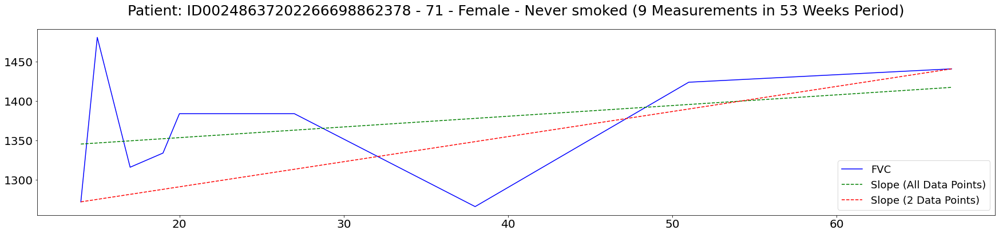

Patient: ID00249637202266730854017 FVC Statistical Summary
----------------------------------------------------------
Mean: 2831.88  -  Median: 3138.5  -  Std: 519.38
Min: 2139 -  Max: 3255
Skew: -0.654763  -  Kurtosis: -2.05557
----------------------------------------------------------
Change Mean: 162.571  - Change Median: 68.0  - Change Std: 274.885
Change Min: 3.0 -  Change Max: 768.0
Change Skew: 2.35822 -  Change Kurtosis: 5.72361
----------------------------------------------------------
Slope (Calculated with All Data Points): -24.291
Slope (Calculated with 2 Data Points): -18.8621


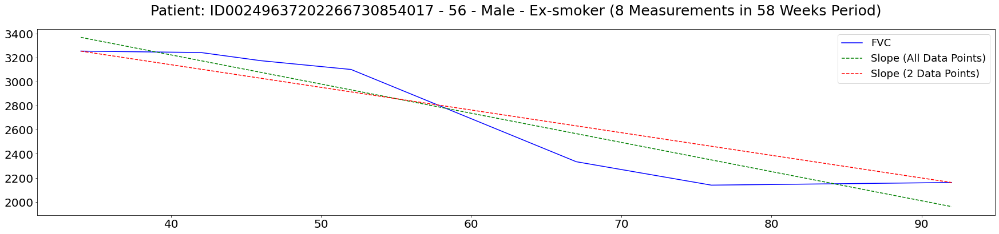

Patient: ID00251637202267455595113 FVC Statistical Summary
----------------------------------------------------------
Mean: 1981.11  -  Median: 2039.0  -  Std: 134.684
Min: 1715 -  Max: 2100
Skew: -1.32517  -  Kurtosis: 0.563777
----------------------------------------------------------
Change Mean: 88.375  - Change Median: 64.0  - Change Std: 101.204
Change Min: 0.0 -  Change Max: 311.0
Change Skew: 1.75921 -  Change Kurtosis: 3.52045
----------------------------------------------------------
Slope (Calculated with All Data Points): -5.5859
Slope (Calculated with 2 Data Points): -4.30645


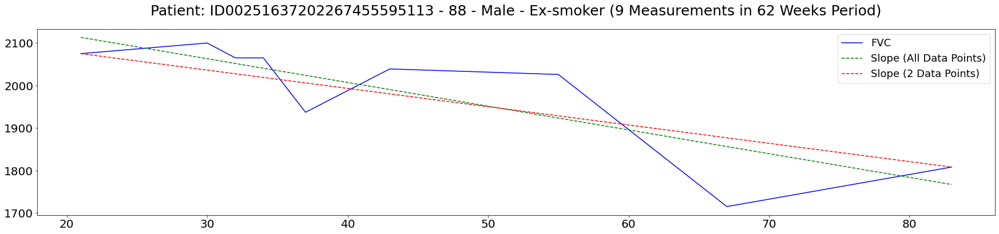

Patient: ID00255637202267923028520 FVC Statistical Summary
----------------------------------------------------------
Mean: 1502.25  -  Median: 1530.5  -  Std: 126.451
Min: 1315 -  Max: 1647
Skew: -0.751149  -  Kurtosis: -0.843792
----------------------------------------------------------
Change Mean: 101.143  - Change Median: 63.0  - Change Std: 107.464
Change Min: 2.0 -  Change Max: 292.0
Change Skew: 0.960958 -  Change Kurtosis: 0.0607946
----------------------------------------------------------
Slope (Calculated with All Data Points): -2.31592
Slope (Calculated with 2 Data Points): 0.814815


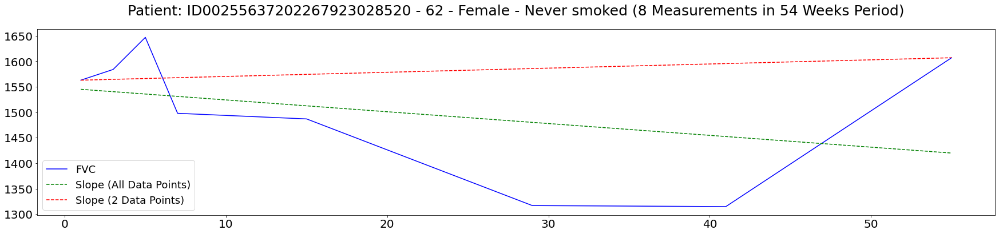

Patient: ID00264637202270643353440 FVC Statistical Summary
----------------------------------------------------------
Mean: 2027.75  -  Median: 2019.5  -  Std: 98.1628
Min: 1931 -  Max: 2239
Skew: 1.53552  -  Kurtosis: 3.07392
----------------------------------------------------------
Change Mean: 106.429  - Change Median: 113.0  - Change Std: 75.9448
Change Min: 23.0 -  Change Max: 221.0
Change Skew: 0.335718 -  Change Kurtosis: -1.34932
----------------------------------------------------------
Slope (Calculated with All Data Points): 0.265338
Slope (Calculated with 2 Data Points): 2.18421


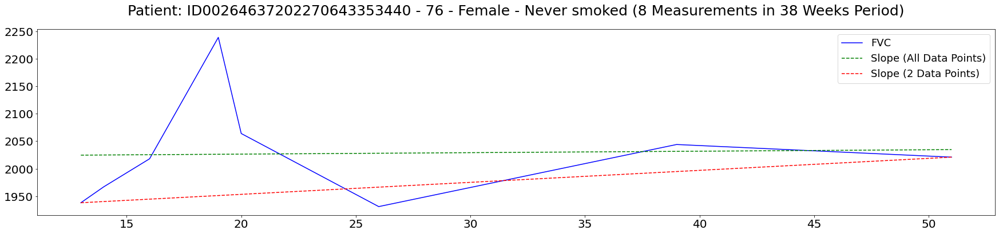

Patient: ID00267637202270790561585 FVC Statistical Summary
----------------------------------------------------------
Mean: 988.333  -  Median: 1017.0  -  Std: 74.0342
Min: 865 -  Max: 1065
Skew: -1.0732  -  Kurtosis: 0.244382
----------------------------------------------------------
Change Mean: 54.8  - Change Median: 50.0  - Change Std: 31.0677
Change Min: 12.0 -  Change Max: 96.0
Change Skew: -0.0798759 -  Change Kurtosis: 0.448869
----------------------------------------------------------
Slope (Calculated with All Data Points): -6.53189
Slope (Calculated with 2 Data Points): -5.35714


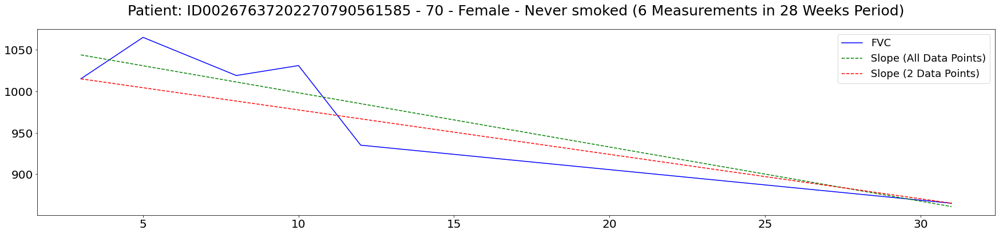

Patient: ID00273637202271319294586 FVC Statistical Summary
----------------------------------------------------------
Mean: 2870.67  -  Median: 2860.0  -  Std: 90.6394
Min: 2708 -  Max: 3020
Skew: -0.123902  -  Kurtosis: 0.587578
----------------------------------------------------------
Change Mean: 77.0  - Change Median: 71.0  - Change Std: 51.6029
Change Min: 13.0 -  Change Max: 160.0
Change Skew: 0.531419 -  Change Kurtosis: -0.690148
----------------------------------------------------------
Slope (Calculated with All Data Points): 1.47899
Slope (Calculated with 2 Data Points): -1.03571


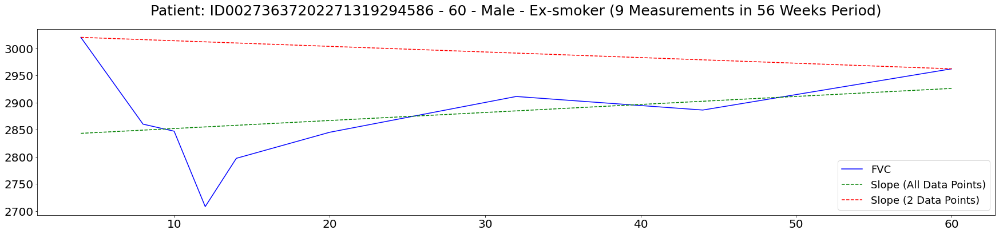

Patient: ID00275637202271440119890 FVC Statistical Summary
----------------------------------------------------------
Mean: 1934.44  -  Median: 1989.0  -  Std: 228.926
Min: 1481 -  Max: 2167
Skew: -1.22938  -  Kurtosis: 0.703924
----------------------------------------------------------
Change Mean: 161.75  - Change Median: 145.0  - Change Std: 149.74
Change Min: 24.0 -  Change Max: 484.0
Change Skew: 1.57783 -  Change Kurtosis: 2.98618
----------------------------------------------------------
Slope (Calculated with All Data Points): -10.1037
Slope (Calculated with 2 Data Points): -8.0


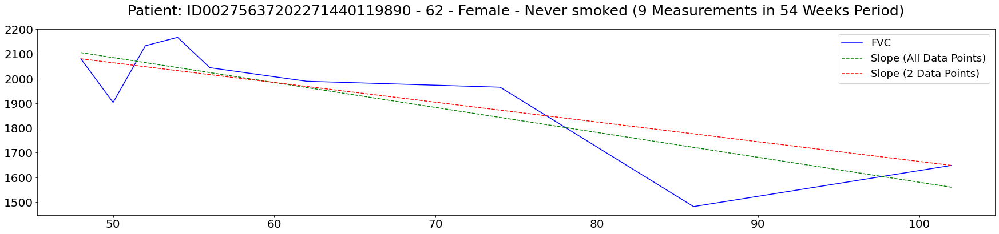

Patient: ID00276637202271694539978 FVC Statistical Summary
----------------------------------------------------------
Mean: 2882.86  -  Median: 2879.0  -  Std: 139.196
Min: 2718 -  Max: 3107
Skew: 0.457052  -  Kurtosis: -0.534599
----------------------------------------------------------
Change Mean: 126.167  - Change Median: 87.0  - Change Std: 105.232
Change Min: 20.0 -  Change Max: 284.0
Change Skew: 0.832782 -  Change Kurtosis: -1.15423
----------------------------------------------------------
Slope (Calculated with All Data Points): -10.778
Slope (Calculated with 2 Data Points): -14.76


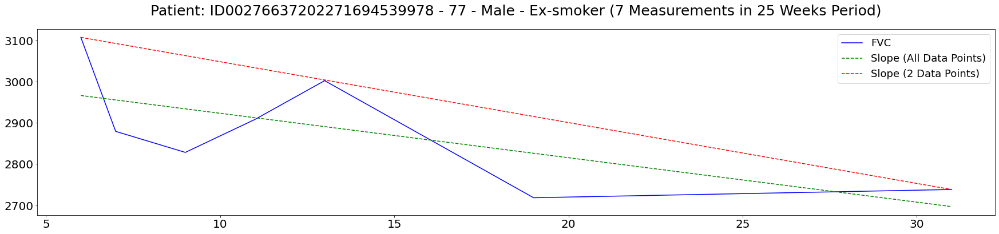

Patient: ID00279637202272164826258 FVC Statistical Summary
----------------------------------------------------------
Mean: 4051.11  -  Median: 4086.0  -  Std: 111.652
Min: 3796 -  Max: 4167
Skew: -1.64846  -  Kurtosis: 3.24916
----------------------------------------------------------
Change Mean: 87.875  - Change Median: 74.5  - Change Std: 71.3691
Change Min: 26.0 -  Change Max: 250.0
Change Skew: 1.99104 -  Change Kurtosis: 4.58559
----------------------------------------------------------
Slope (Calculated with All Data Points): -5.16591
Slope (Calculated with 2 Data Points): -6.27273


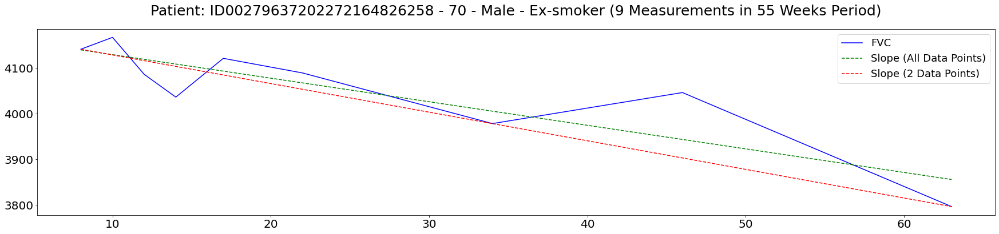

Patient: ID00283637202278714365037 FVC Statistical Summary
----------------------------------------------------------
Mean: 1970.11  -  Median: 1965.0  -  Std: 68.4205
Min: 1854 -  Max: 2109
Skew: 0.556582  -  Kurtosis: 2.29991
----------------------------------------------------------
Change Mean: 83.875  - Change Median: 96.5  - Change Std: 54.2361
Change Min: 10.0 -  Change Max: 154.0
Change Skew: -0.165923 -  Change Kurtosis: -1.639
----------------------------------------------------------
Slope (Calculated with All Data Points): 0.681112
Slope (Calculated with 2 Data Points): 0.351852


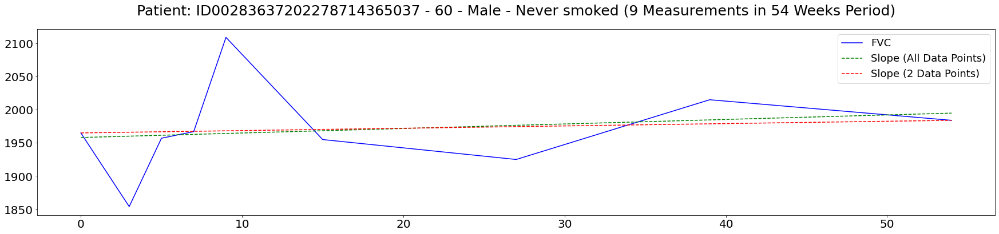

Patient: ID00285637202278913507108 FVC Statistical Summary
----------------------------------------------------------
Mean: 1376.89  -  Median: 1371.0  -  Std: 85.3529
Min: 1276 -  Max: 1528
Skew: 0.45105  -  Kurtosis: -0.697387
----------------------------------------------------------
Change Mean: 98.125  - Change Median: 85.0  - Change Std: 72.0524
Change Min: 7.0 -  Change Max: 252.0
Change Skew: 1.43215 -  Change Kurtosis: 3.19652
----------------------------------------------------------
Slope (Calculated with All Data Points): 0.350064
Slope (Calculated with 2 Data Points): -1.98148


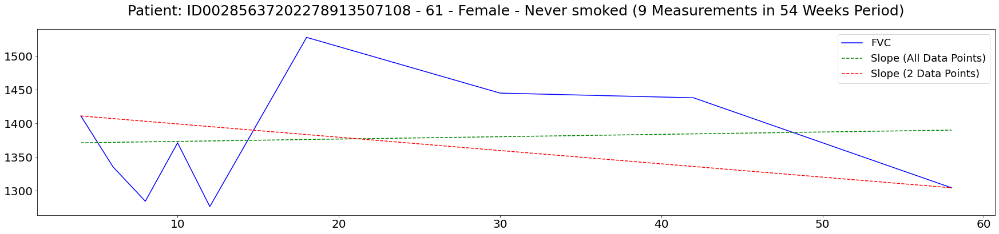

Patient: ID00288637202279148973731 FVC Statistical Summary
----------------------------------------------------------
Mean: 2201.88  -  Median: 2199.0  -  Std: 165.149
Min: 1970 -  Max: 2387
Skew: -0.173618  -  Kurtosis: -1.91226
----------------------------------------------------------
Change Mean: 104.714  - Change Median: 81.0  - Change Std: 88.2019
Change Min: 5.0 -  Change Max: 257.0
Change Skew: 0.739379 -  Change Kurtosis: -0.0830158
----------------------------------------------------------
Slope (Calculated with All Data Points): 9.05221
Slope (Calculated with 2 Data Points): 3.08333


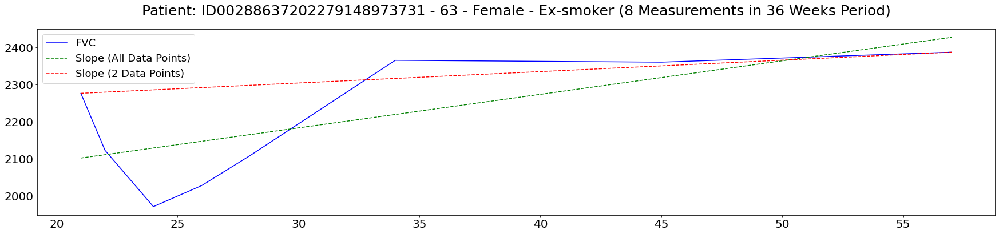

Patient: ID00290637202279304677843 FVC Statistical Summary
----------------------------------------------------------
Mean: 2179.88  -  Median: 2229.0  -  Std: 170.346
Min: 1814 -  Max: 2315
Skew: -1.61119  -  Kurtosis: 2.81072
----------------------------------------------------------
Change Mean: 167.286  - Change Median: 179.0  - Change Std: 94.8766
Change Min: 15.0 -  Change Max: 321.0
Change Skew: -0.00464131 -  Change Kurtosis: 1.01278
----------------------------------------------------------
Slope (Calculated with All Data Points): -9.10758
Slope (Calculated with 2 Data Points): -9.97872


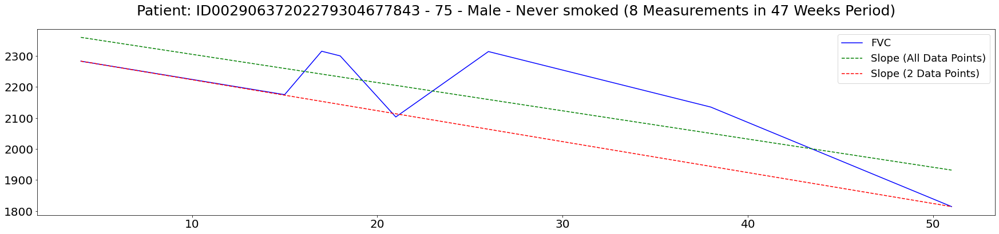

Patient: ID00291637202279398396106 FVC Statistical Summary
----------------------------------------------------------
Mean: 3911.33  -  Median: 4001.0  -  Std: 190.13
Min: 3581 -  Max: 4079
Skew: -1.15817  -  Kurtosis: -0.254964
----------------------------------------------------------
Change Mean: 132.25  - Change Median: 99.0  - Change Std: 118.802
Change Min: 24.0 -  Change Max: 383.0
Change Skew: 1.51725 -  Change Kurtosis: 2.40992
----------------------------------------------------------
Slope (Calculated with All Data Points): -9.08141
Slope (Calculated with 2 Data Points): -8.7037


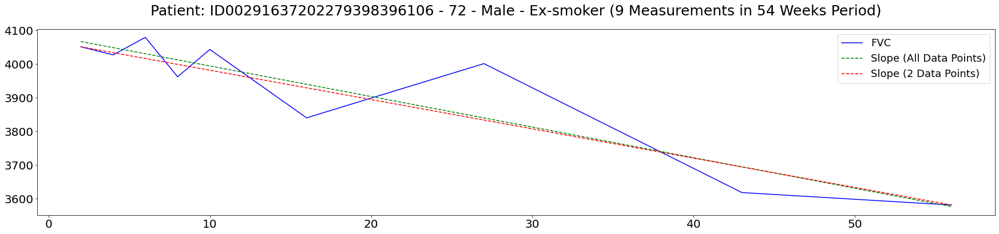

Patient: ID00294637202279614924243 FVC Statistical Summary
----------------------------------------------------------
Mean: 2194.89  -  Median: 2174.0  -  Std: 114.222
Min: 2058 -  Max: 2361
Skew: 0.201675  -  Kurtosis: -1.60835
----------------------------------------------------------
Change Mean: 73.25  - Change Median: 64.0  - Change Std: 37.2165
Change Min: 34.0 -  Change Max: 117.0
Change Skew: 0.248921 -  Change Kurtosis: -2.28017
----------------------------------------------------------
Slope (Calculated with All Data Points): -4.40627
Slope (Calculated with 2 Data Points): -4.85185


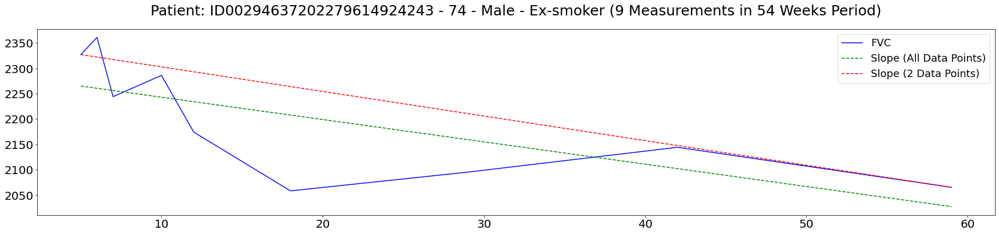

Patient: ID00296637202279895784347 FVC Statistical Summary
----------------------------------------------------------
Mean: 2154.88  -  Median: 2164.5  -  Std: 84.0314
Min: 1990 -  Max: 2258
Skew: -0.991741  -  Kurtosis: 1.24029
----------------------------------------------------------
Change Mean: 125.857  - Change Median: 128.0  - Change Std: 67.7186
Change Min: 33.0 -  Change Max: 220.0
Change Skew: -0.280703 -  Change Kurtosis: -0.874366
----------------------------------------------------------
Slope (Calculated with All Data Points): -0.245669
Slope (Calculated with 2 Data Points): -1.46154


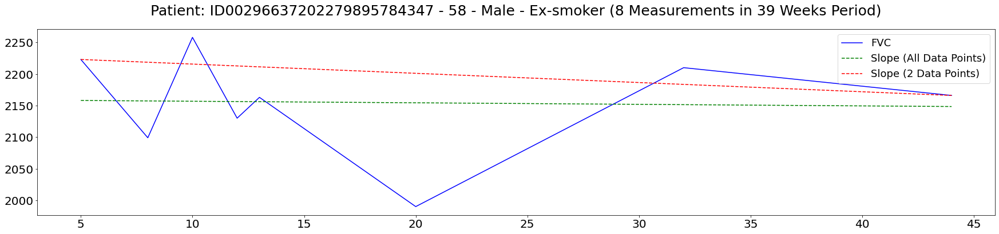

Patient: ID00298637202280361773446 FVC Statistical Summary
----------------------------------------------------------
Mean: 1765.89  -  Median: 1803.0  -  Std: 165.908
Min: 1409 -  Max: 1932
Skew: -1.47424  -  Kurtosis: 1.88367
----------------------------------------------------------
Change Mean: 115.625  - Change Median: 108.5  - Change Std: 55.5645
Change Min: 49.0 -  Change Max: 187.0
Change Skew: 0.0876297 -  Change Kurtosis: -1.72668
----------------------------------------------------------
Slope (Calculated with All Data Points): -8.1157
Slope (Calculated with 2 Data Points): -8.88679


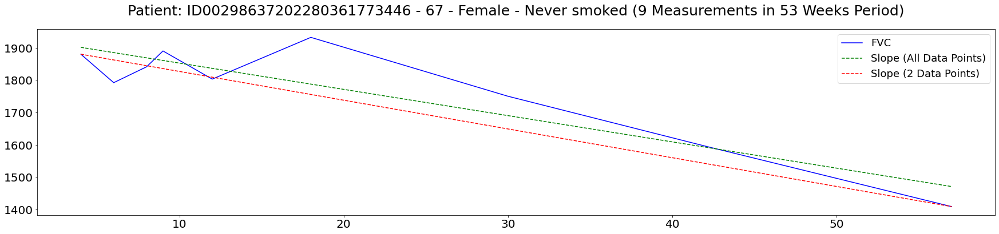

Patient: ID00299637202280383305867 FVC Statistical Summary
----------------------------------------------------------
Mean: 2134.33  -  Median: 2141.0  -  Std: 182.736
Min: 1741 -  Max: 2328
Skew: -1.26639  -  Kurtosis: 1.93661
----------------------------------------------------------
Change Mean: 153.625  - Change Median: 94.0  - Change Std: 193.09
Change Min: 4.0 -  Change Max: 587.0
Change Skew: 1.9593 -  Change Kurtosis: 4.09692
----------------------------------------------------------
Slope (Calculated with All Data Points): -2.35612
Slope (Calculated with 2 Data Points): 0.314815


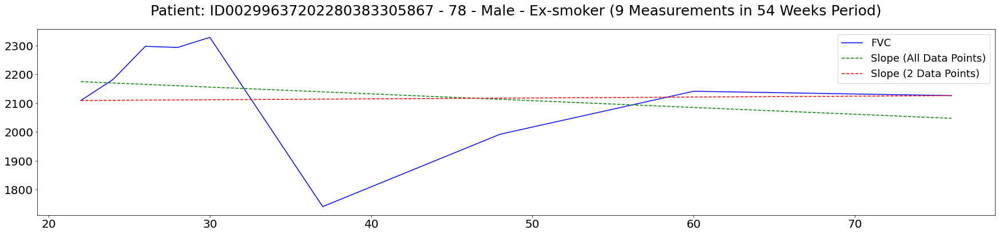

Patient: ID00305637202281772703145 FVC Statistical Summary
----------------------------------------------------------
Mean: 2802.0  -  Median: 2785.0  -  Std: 136.803
Min: 2555 -  Max: 2984
Skew: -0.337136  -  Kurtosis: -0.232704
----------------------------------------------------------
Change Mean: 111.875  - Change Median: 100.5  - Change Std: 67.6069
Change Min: 32.0 -  Change Max: 227.0
Change Skew: 0.515235 -  Change Kurtosis: -0.770054
----------------------------------------------------------
Slope (Calculated with All Data Points): -4.80809
Slope (Calculated with 2 Data Points): -7.94444


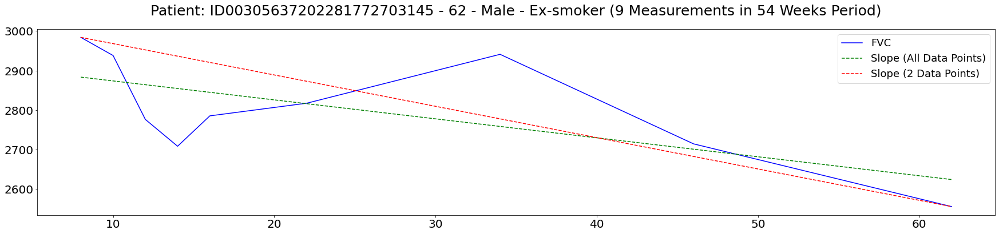

Patient: ID00307637202282126172865 FVC Statistical Summary
----------------------------------------------------------
Mean: 3073.67  -  Median: 3166.0  -  Std: 195.007
Min: 2762 -  Max: 3292
Skew: -0.682202  -  Kurtosis: -1.29828
----------------------------------------------------------
Change Mean: 96.625  - Change Median: 74.5  - Change Std: 75.5569
Change Min: 37.0 -  Change Max: 272.0
Change Skew: 2.2021 -  Change Kurtosis: 5.28729
----------------------------------------------------------
Slope (Calculated with All Data Points): -8.9319
Slope (Calculated with 2 Data Points): -5.21818


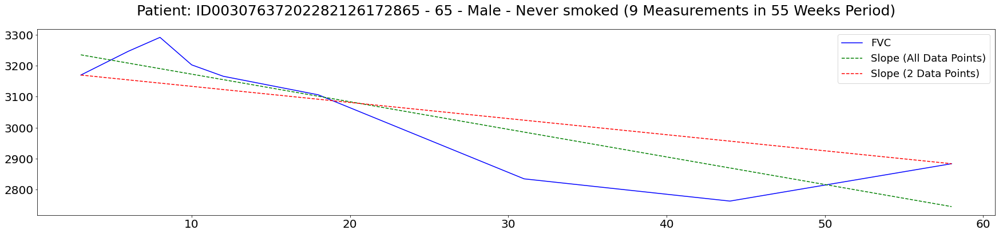

Patient: ID00309637202282195513787 FVC Statistical Summary
----------------------------------------------------------
Mean: 3140.22  -  Median: 3180.0  -  Std: 190.231
Min: 2828 -  Max: 3499
Skew: 0.168412  -  Kurtosis: 1.20725
----------------------------------------------------------
Change Mean: 196.375  - Change Median: 145.0  - Change Std: 161.038
Change Min: 4.0 -  Change Max: 400.0
Change Skew: 0.305232 -  Change Kurtosis: -2.04229
----------------------------------------------------------
Slope (Calculated with All Data Points): -4.44101
Slope (Calculated with 2 Data Points): -0.981481


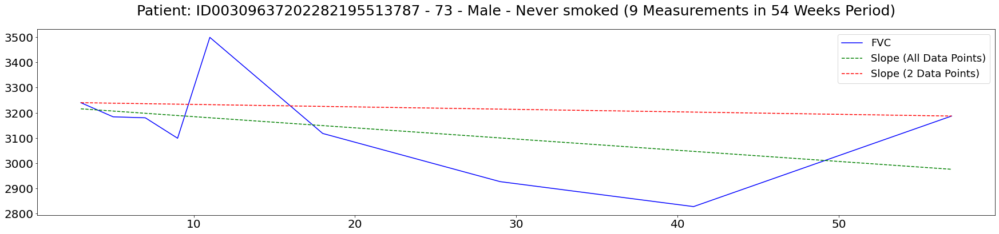

Patient: ID00312637202282607344793 FVC Statistical Summary
----------------------------------------------------------
Mean: 1761.89  -  Median: 1765.0  -  Std: 116.012
Min: 1571 -  Max: 1919
Skew: -0.402292  -  Kurtosis: -0.545097
----------------------------------------------------------
Change Mean: 82.0  - Change Median: 78.0  - Change Std: 69.6071
Change Min: 0.0 -  Change Max: 178.0
Change Skew: 0.163267 -  Change Kurtosis: -2.03098
----------------------------------------------------------
Slope (Calculated with All Data Points): -4.98037
Slope (Calculated with 2 Data Points): -5.40351


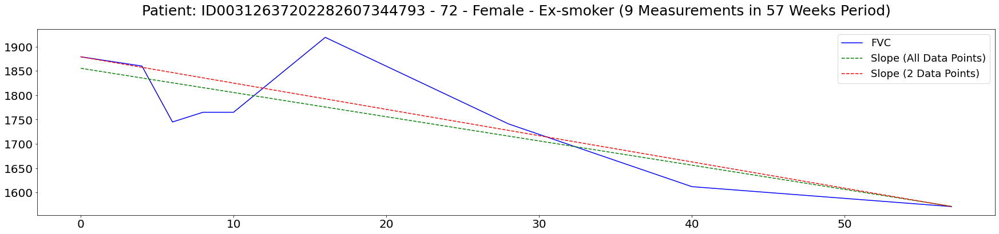

Patient: ID00317637202283194142136 FVC Statistical Summary
----------------------------------------------------------
Mean: 2154.0  -  Median: 2270.0  -  Std: 257.766
Min: 1653 -  Max: 2375
Skew: -1.42917  -  Kurtosis: 0.885989
----------------------------------------------------------
Change Mean: 150.571  - Change Median: 70.0  - Change Std: 172.525
Change Min: 42.0 -  Change Max: 520.0
Change Skew: 2.13241 -  Change Kurtosis: 4.60543
----------------------------------------------------------
Slope (Calculated with All Data Points): -10.9399
Slope (Calculated with 2 Data Points): -8.71186


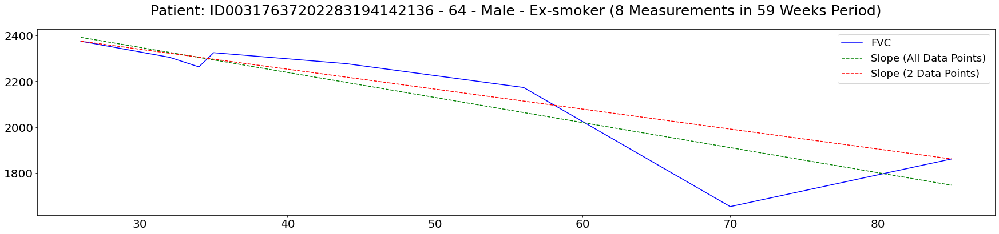

Patient: ID00319637202283897208687 FVC Statistical Summary
----------------------------------------------------------
Mean: 4078.22  -  Median: 4218.0  -  Std: 425.855
Min: 2951 -  Max: 4287
Skew: -2.91589  -  Kurtosis: 8.62329
----------------------------------------------------------
Change Mean: 360.875  - Change Median: 68.0  - Change Std: 560.209
Change Min: 9.0 -  Change Max: 1336.0
Change Skew: 1.43848 -  Change Kurtosis: 0.100019
----------------------------------------------------------
Slope (Calculated with All Data Points): 7.19714
Slope (Calculated with 2 Data Points): 1.31579


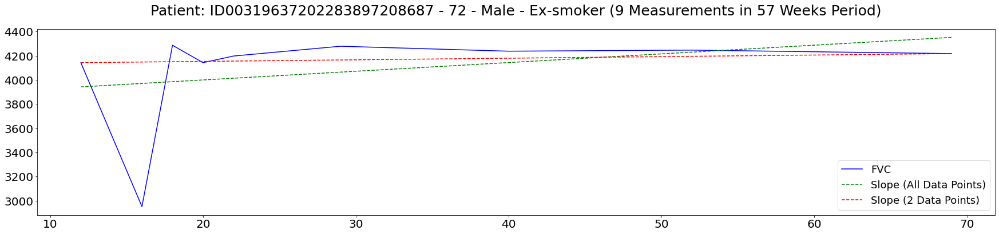

Patient: ID00322637202284842245491 FVC Statistical Summary
----------------------------------------------------------
Mean: 2498.0  -  Median: 2460.0  -  Std: 159.386
Min: 2311 -  Max: 2795
Skew: 0.56112  -  Kurtosis: -0.193021
----------------------------------------------------------
Change Mean: 108.375  - Change Median: 72.5  - Change Std: 118.016
Change Min: 6.0 -  Change Max: 339.0
Change Skew: 1.19055 -  Change Kurtosis: 0.81093
----------------------------------------------------------
Slope (Calculated with All Data Points): -6.31469
Slope (Calculated with 2 Data Points): -2.5


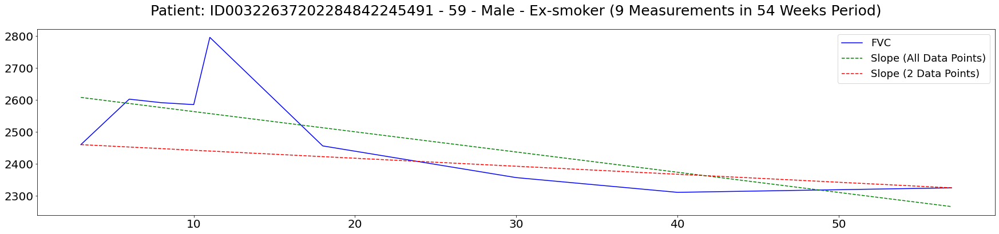

Patient: ID00323637202285211956970 FVC Statistical Summary
----------------------------------------------------------
Mean: 1629.12  -  Median: 1612.5  -  Std: 130.63
Min: 1412 -  Max: 1818
Skew: -0.145598  -  Kurtosis: -0.318031
----------------------------------------------------------
Change Mean: 144.286  - Change Median: 126.0  - Change Std: 84.9896
Change Min: 11.0 -  Change Max: 257.0
Change Skew: -0.14797 -  Change Kurtosis: -0.521971
----------------------------------------------------------
Slope (Calculated with All Data Points): 4.5155
Slope (Calculated with 2 Data Points): 9.15789


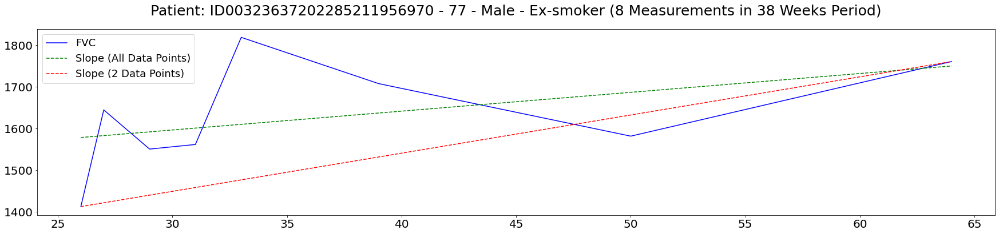

Patient: ID00329637202285906759848 FVC Statistical Summary
----------------------------------------------------------
Mean: 2796.67  -  Median: 2805.0  -  Std: 123.057
Min: 2618 -  Max: 3051
Skew: 0.777149  -  Kurtosis: 1.77763
----------------------------------------------------------
Change Mean: 152.25  - Change Median: 140.5  - Change Std: 122.332
Change Min: 8.0 -  Change Max: 317.0
Change Skew: 0.156857 -  Change Kurtosis: -2.13694
----------------------------------------------------------
Slope (Calculated with All Data Points): -1.04024
Slope (Calculated with 2 Data Points): -2.28571


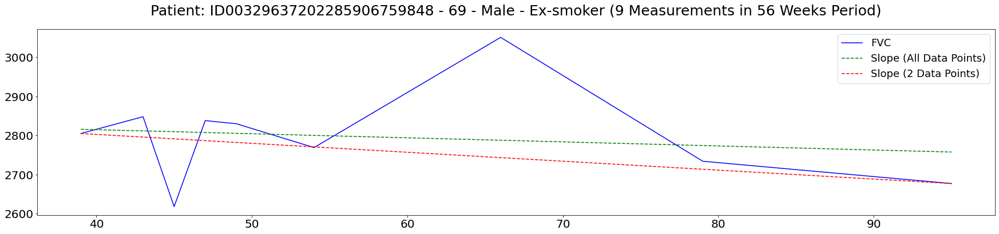

Patient: ID00331637202286306023714 FVC Statistical Summary
----------------------------------------------------------
Mean: 3141.78  -  Median: 3153.0  -  Std: 105.089
Min: 2965 -  Max: 3272
Skew: -0.805972  -  Kurtosis: -0.266329
----------------------------------------------------------
Change Mean: 107.25  - Change Median: 96.0  - Change Std: 58.1052
Change Min: 21.0 -  Change Max: 212.0
Change Skew: 0.505798 -  Change Kurtosis: 0.592362
----------------------------------------------------------
Slope (Calculated with All Data Points): 2.56112
Slope (Calculated with 2 Data Points): 1.59259


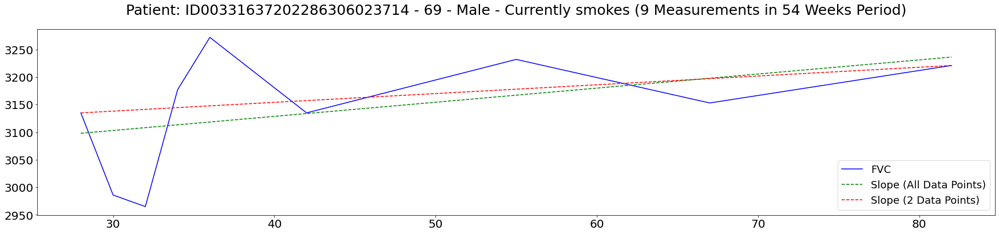

Patient: ID00335637202286784464927 FVC Statistical Summary
----------------------------------------------------------
Mean: 2636.67  -  Median: 2598.0  -  Std: 168.347
Min: 2467 -  Max: 3043
Skew: 1.99925  -  Kurtosis: 4.9183
----------------------------------------------------------
Change Mean: 110.75  - Change Median: 81.0  - Change Std: 100.058
Change Min: 38.0 -  Change Max: 349.0
Change Skew: 2.4204 -  Change Kurtosis: 6.29261
----------------------------------------------------------
Slope (Calculated with All Data Points): -5.53089
Slope (Calculated with 2 Data Points): -10.8679


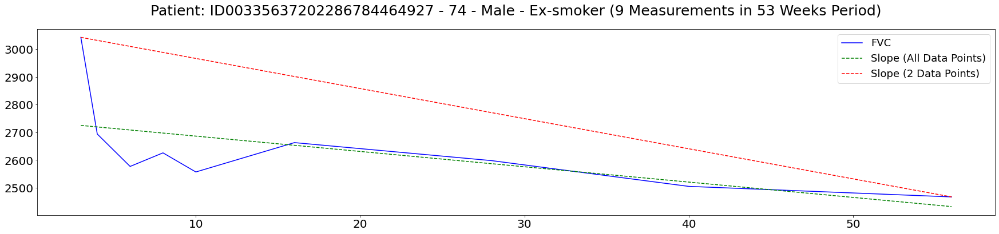

Patient: ID00336637202286801879145 FVC Statistical Summary
----------------------------------------------------------
Mean: 2516.88  -  Median: 2547.0  -  Std: 92.3927
Min: 2294 -  Max: 2570
Skew: -2.56573  -  Kurtosis: 6.80932
----------------------------------------------------------
Change Mean: 46.1429  - Change Median: 20.0  - Change Std: 73.7505
Change Min: 3.0 -  Change Max: 211.0
Change Skew: 2.49251 -  Change Kurtosis: 6.36658
----------------------------------------------------------
Slope (Calculated with All Data Points): -6.04144
Slope (Calculated with 2 Data Points): -7.23684


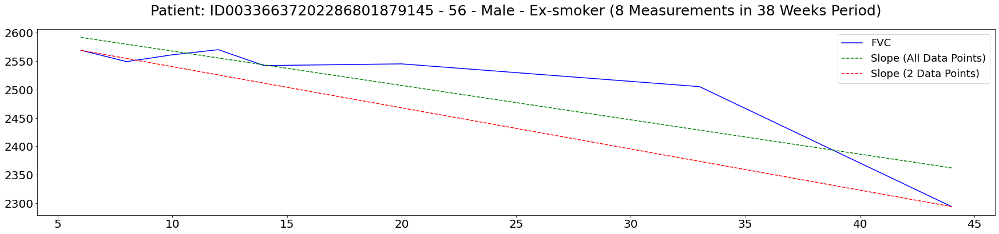

Patient: ID00337637202286839091062 FVC Statistical Summary
----------------------------------------------------------
Mean: 3921.11  -  Median: 3941.0  -  Std: 133.918
Min: 3625 -  Max: 4096
Skew: -1.21266  -  Kurtosis: 2.9106
----------------------------------------------------------
Change Mean: 137.125  - Change Median: 127.0  - Change Std: 111.603
Change Min: 6.0 -  Change Max: 316.0
Change Skew: 0.620441 -  Change Kurtosis: -0.662649
----------------------------------------------------------
Slope (Calculated with All Data Points): -0.0377488
Slope (Calculated with 2 Data Points): 1.76786


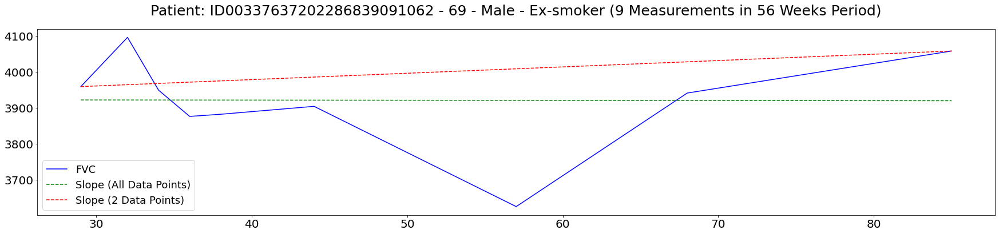

Patient: ID00339637202287377736231 FVC Statistical Summary
----------------------------------------------------------
Mean: 3375.11  -  Median: 3421.0  -  Std: 185.595
Min: 2968 -  Max: 3574
Skew: -1.35817  -  Kurtosis: 2.34833
----------------------------------------------------------
Change Mean: 90.5  - Change Median: 48.0  - Change Std: 93.2983
Change Min: 9.0 -  Change Max: 286.0
Change Skew: 1.54983 -  Change Kurtosis: 2.14919
----------------------------------------------------------
Slope (Calculated with All Data Points): -9.38185
Slope (Calculated with 2 Data Points): -10.4483


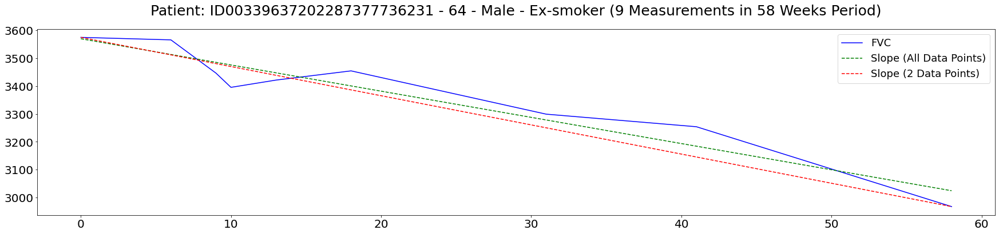

Patient: ID00340637202287399835821 FVC Statistical Summary
----------------------------------------------------------
Mean: 2237.67  -  Median: 2253.0  -  Std: 106.671
Min: 2000 -  Max: 2346
Skew: -1.4751  -  Kurtosis: 2.69108
----------------------------------------------------------
Change Mean: 86.375  - Change Median: 60.5  - Change Std: 70.8377
Change Min: 11.0 -  Change Max: 222.0
Change Skew: 1.19249 -  Change Kurtosis: 0.695174
----------------------------------------------------------
Slope (Calculated with All Data Points): -3.81405
Slope (Calculated with 2 Data Points): -2.08475


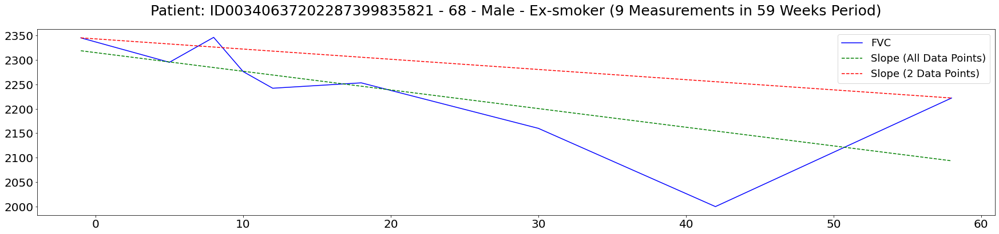

Patient: ID00341637202287410878488 FVC Statistical Summary
----------------------------------------------------------
Mean: 2822.33  -  Median: 2849.0  -  Std: 58.5811
Min: 2701 -  Max: 2891
Skew: -1.12577  -  Kurtosis: 1.18379
----------------------------------------------------------
Change Mean: 66.75  - Change Median: 57.0  - Change Std: 39.8381
Change Min: 2.0 -  Change Max: 118.0
Change Skew: -0.134152 -  Change Kurtosis: -0.753679
----------------------------------------------------------
Slope (Calculated with All Data Points): -2.01668
Slope (Calculated with 2 Data Points): -2.64286


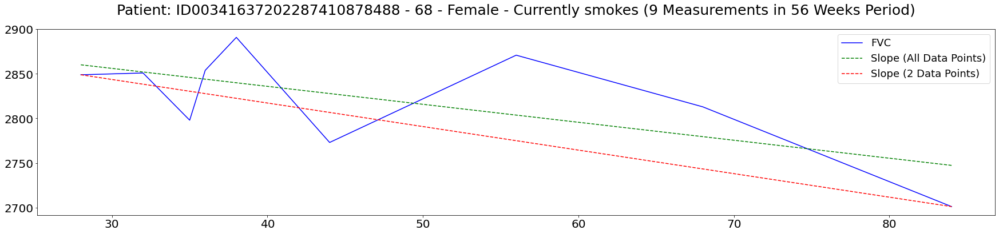

Patient: ID00342637202287526592911 FVC Statistical Summary
----------------------------------------------------------
Mean: 2102.78  -  Median: 2062.0  -  Std: 195.431
Min: 1865 -  Max: 2390
Skew: 0.325965  -  Kurtosis: -1.52369
----------------------------------------------------------
Change Mean: 83.375  - Change Median: 65.5  - Change Std: 71.3201
Change Min: 17.0 -  Change Max: 197.0
Change Skew: 1.03583 -  Change Kurtosis: -0.504065
----------------------------------------------------------
Slope (Calculated with All Data Points): -8.22449
Slope (Calculated with 2 Data Points): -8.89091


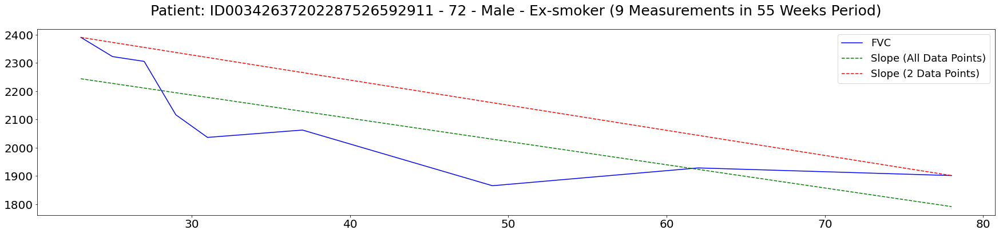

Patient: ID00343637202287577133798 FVC Statistical Summary
----------------------------------------------------------
Mean: 1551.6  -  Median: 1531.0  -  Std: 90.2862
Min: 1383 -  Max: 1699
Skew: -0.165129  -  Kurtosis: 0.21316
----------------------------------------------------------
Change Mean: 105.333  - Change Median: 95.0  - Change Std: 63.9512
Change Min: 14.0 -  Change Max: 207.0
Change Skew: 0.313107 -  Change Kurtosis: -0.579756
----------------------------------------------------------
Slope (Calculated with All Data Points): -0.280842
Slope (Calculated with 2 Data Points): -2.25


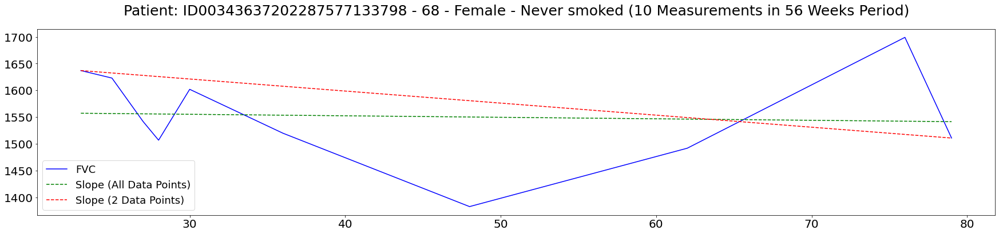

Patient: ID00344637202287684217717 FVC Statistical Summary
----------------------------------------------------------
Mean: 1992.14  -  Median: 2020.0  -  Std: 89.8637
Min: 1812 -  Max: 2074
Skew: -1.56432  -  Kurtosis: 2.7077
----------------------------------------------------------
Change Mean: 56.0  - Change Median: 43.5  - Change Std: 46.1433
Change Min: 8.0 -  Change Max: 142.0
Change Skew: 1.55796 -  Change Kurtosis: 3.06875
----------------------------------------------------------
Slope (Calculated with All Data Points): -8.56446
Slope (Calculated with 2 Data Points): -8.19355


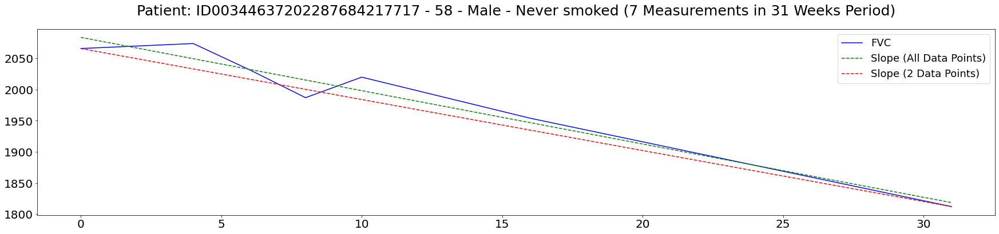

Patient: ID00351637202289476567312 FVC Statistical Summary
----------------------------------------------------------
Mean: 2617.78  -  Median: 2627.0  -  Std: 137.987
Min: 2441 -  Max: 2808
Skew: 0.0515431  -  Kurtosis: -1.55284
----------------------------------------------------------
Change Mean: 157.5  - Change Median: 139.0  - Change Std: 136.127
Change Min: 4.0 -  Change Max: 367.0
Change Skew: 0.426601 -  Change Kurtosis: -1.13546
----------------------------------------------------------
Slope (Calculated with All Data Points): 1.65657
Slope (Calculated with 2 Data Points): -2.26923


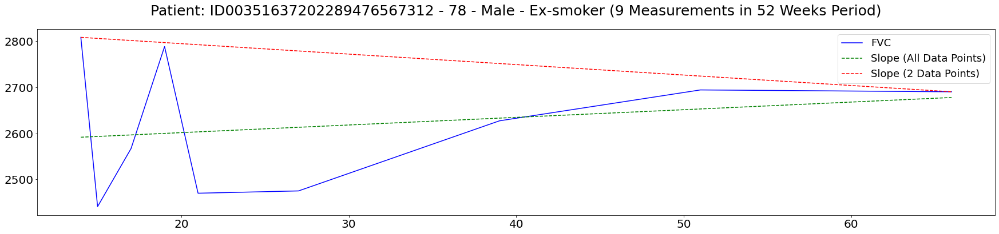

Patient: ID00355637202295106567614 FVC Statistical Summary
----------------------------------------------------------
Mean: 4453.56  -  Median: 4447.0  -  Std: 336.468
Min: 3681 -  Max: 4791
Skew: -1.57922  -  Kurtosis: 3.46188
----------------------------------------------------------
Change Mean: 305.125  - Change Median: 219.5  - Change Std: 284.931
Change Min: 32.0 -  Change Max: 737.0
Change Skew: 0.937933 -  Change Kurtosis: -0.724997
----------------------------------------------------------
Slope (Calculated with All Data Points): 7.33126
Slope (Calculated with 2 Data Points): 0.5


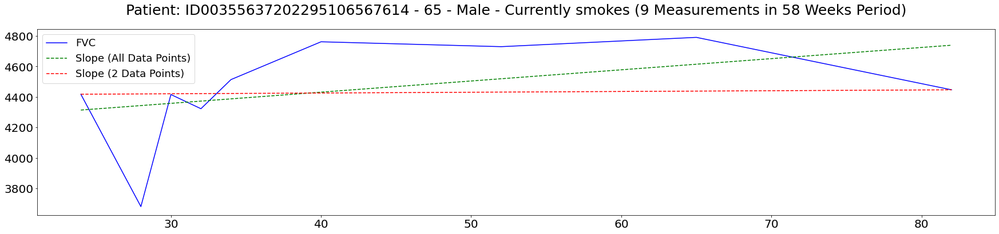

Patient: ID00358637202295388077032 FVC Statistical Summary
----------------------------------------------------------
Mean: 2017.0  -  Median: 2032.0  -  Std: 105.6
Min: 1823 -  Max: 2151
Skew: -0.584747  -  Kurtosis: 0.590487
----------------------------------------------------------
Change Mean: 134.714  - Change Median: 108.0  - Change Std: 107.865
Change Min: 1.0 -  Change Max: 328.0
Change Skew: 0.819389 -  Change Kurtosis: 0.771015
----------------------------------------------------------
Slope (Calculated with All Data Points): -0.265161
Slope (Calculated with 2 Data Points): 2.08621


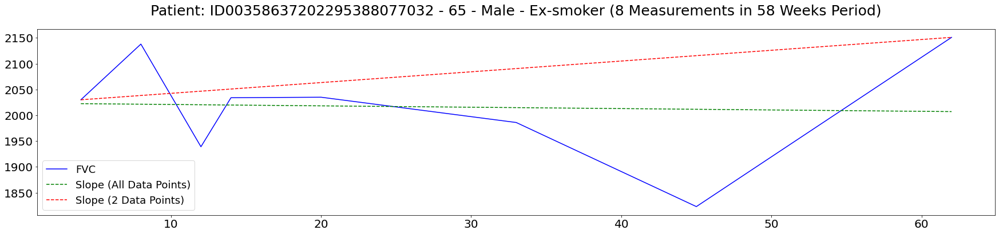

Patient: ID00360637202295712204040 FVC Statistical Summary
----------------------------------------------------------
Mean: 2835.44  -  Median: 2760.0  -  Std: 146.821
Min: 2687 -  Max: 3107
Skew: 0.861197  -  Kurtosis: -0.450226
----------------------------------------------------------
Change Mean: 125.25  - Change Median: 126.5  - Change Std: 93.8293
Change Min: 15.0 -  Change Max: 284.0
Change Skew: 0.426651 -  Change Kurtosis: -0.717883
----------------------------------------------------------
Slope (Calculated with All Data Points): -2.21685
Slope (Calculated with 2 Data Points): -4.03704


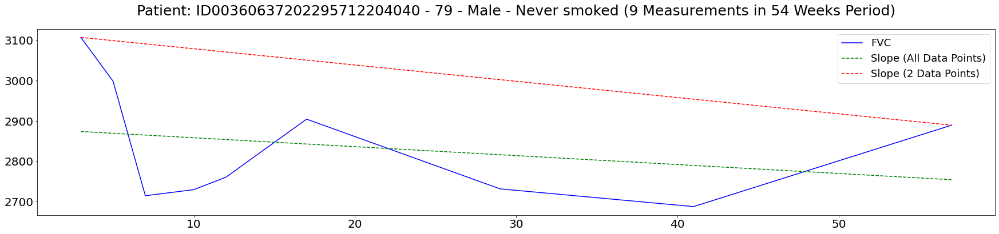

Patient: ID00364637202296074419422 FVC Statistical Summary
----------------------------------------------------------
Mean: 2851.89  -  Median: 3032.0  -  Std: 333.106
Min: 2170 -  Max: 3191
Skew: -1.32276  -  Kurtosis: 1.03973
----------------------------------------------------------
Change Mean: 189.875  - Change Median: 164.0  - Change Std: 194.214
Change Min: 13.0 -  Change Max: 598.0
Change Skew: 1.44535 -  Change Kurtosis: 2.3527
----------------------------------------------------------
Slope (Calculated with All Data Points): -15.0307
Slope (Calculated with 2 Data Points): -17.9123


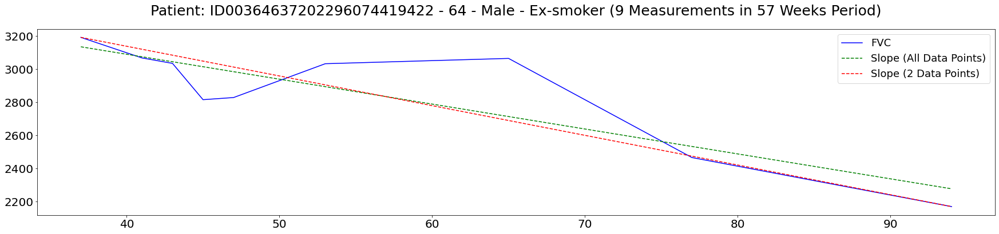

Patient: ID00365637202296085035729 FVC Statistical Summary
----------------------------------------------------------
Mean: 2349.62  -  Median: 2366.5  -  Std: 138.773
Min: 2122 -  Max: 2581
Skew: -0.0374394  -  Kurtosis: 0.476491
----------------------------------------------------------
Change Mean: 131.286  - Change Median: 165.0  - Change Std: 78.2234
Change Min: 18.0 -  Change Max: 246.0
Change Skew: -0.0909174 -  Change Kurtosis: -0.807853
----------------------------------------------------------
Slope (Calculated with All Data Points): -8.18946
Slope (Calculated with 2 Data Points): -7.86842


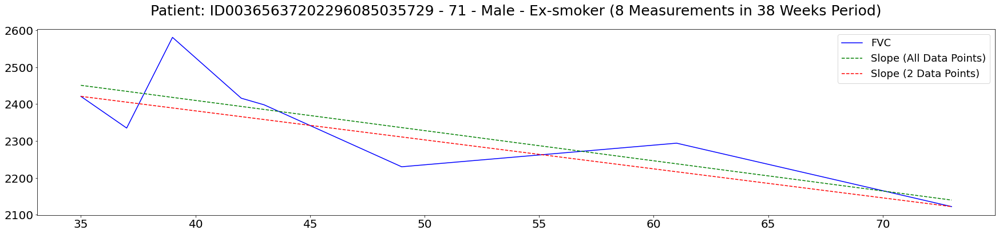

Patient: ID00367637202296290303449 FVC Statistical Summary
----------------------------------------------------------
Mean: 1328.0  -  Median: 1332.0  -  Std: 204.937
Min: 837 -  Max: 1593
Skew: -1.80738  -  Kurtosis: 5.06219
----------------------------------------------------------
Change Mean: 158.625  - Change Median: 110.5  - Change Std: 165.757
Change Min: 8.0 -  Change Max: 478.0
Change Skew: 1.06042 -  Change Kurtosis: 0.536547
----------------------------------------------------------
Slope (Calculated with All Data Points): -8.28763
Slope (Calculated with 2 Data Points): -10.1731


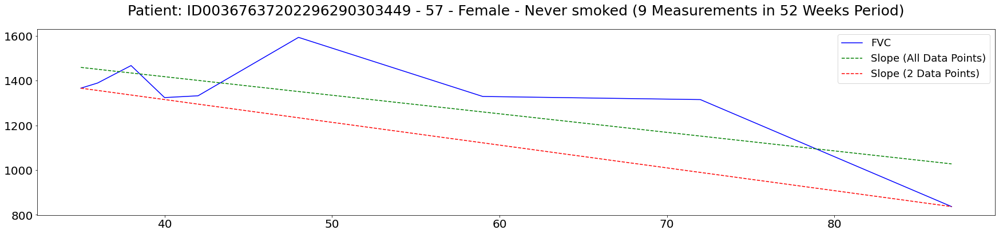

Patient: ID00368637202296470751086 FVC Statistical Summary
----------------------------------------------------------
Mean: 2973.11  -  Median: 2964.0  -  Std: 114.534
Min: 2801 -  Max: 3128
Skew: -0.313911  -  Kurtosis: -0.73072
----------------------------------------------------------
Change Mean: 132.625  - Change Median: 151.5  - Change Std: 60.2944
Change Min: 32.0 -  Change Max: 218.0
Change Skew: -0.453733 -  Change Kurtosis: -0.419755
----------------------------------------------------------
Slope (Calculated with All Data Points): -2.22093
Slope (Calculated with 2 Data Points): -1.91228


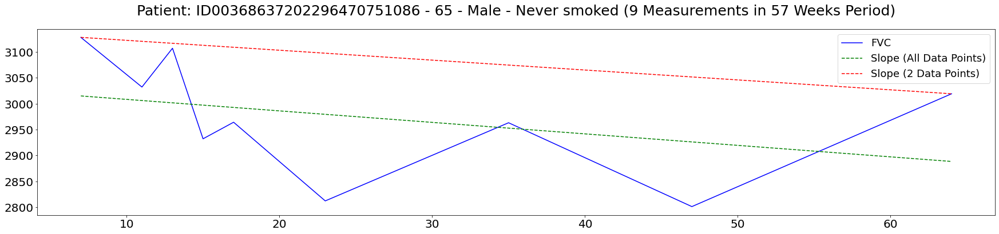

Patient: ID00370637202296737666151 FVC Statistical Summary
----------------------------------------------------------
Mean: 2243.44  -  Median: 2243.0  -  Std: 31.2134
Min: 2209 -  Max: 2308
Skew: 1.04717  -  Kurtosis: 1.28141
----------------------------------------------------------
Change Mean: 38.25  - Change Median: 28.5  - Change Std: 28.0802
Change Min: 7.0 -  Change Max: 97.0
Change Skew: 1.52276 -  Change Kurtosis: 2.39254
----------------------------------------------------------
Slope (Calculated with All Data Points): -0.330568
Slope (Calculated with 2 Data Points): -1.11538


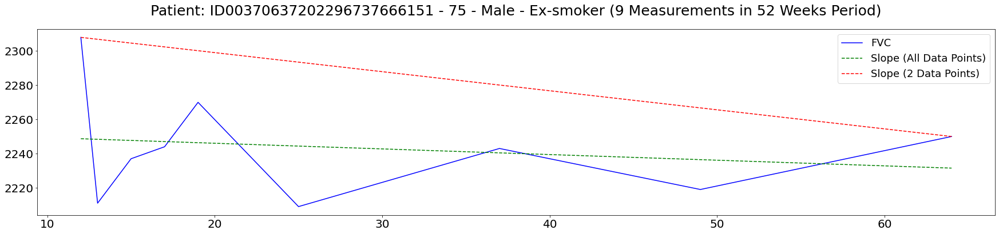

Patient: ID00371637202296828615743 FVC Statistical Summary
----------------------------------------------------------
Mean: 2445.78  -  Median: 2470.0  -  Std: 84.7301
Min: 2232 -  Max: 2510
Skew: -2.43034  -  Kurtosis: 6.46455
----------------------------------------------------------
Change Mean: 53.75  - Change Median: 37.0  - Change Std: 57.0833
Change Min: 4.0 -  Change Max: 187.0
Change Skew: 2.21933 -  Change Kurtosis: 5.55814
----------------------------------------------------------
Slope (Calculated with All Data Points): -3.66512
Slope (Calculated with 2 Data Points): -4.40741


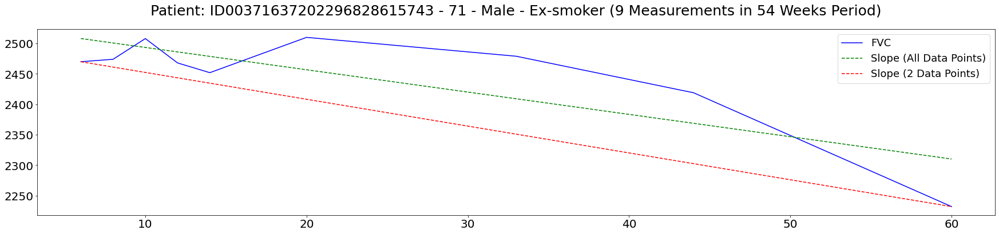

Patient: ID00376637202297677828573 FVC Statistical Summary
----------------------------------------------------------
Mean: 4260.44  -  Median: 4284.0  -  Std: 87.3629
Min: 4125 -  Max: 4386
Skew: -0.344499  -  Kurtosis: -1.05626
----------------------------------------------------------
Change Mean: 69.125  - Change Median: 66.0  - Change Std: 53.0483
Change Min: 1.0 -  Change Max: 163.0
Change Skew: 0.73906 -  Change Kurtosis: 0.0422225
----------------------------------------------------------
Slope (Calculated with All Data Points): -3.44358
Slope (Calculated with 2 Data Points): -2.94444


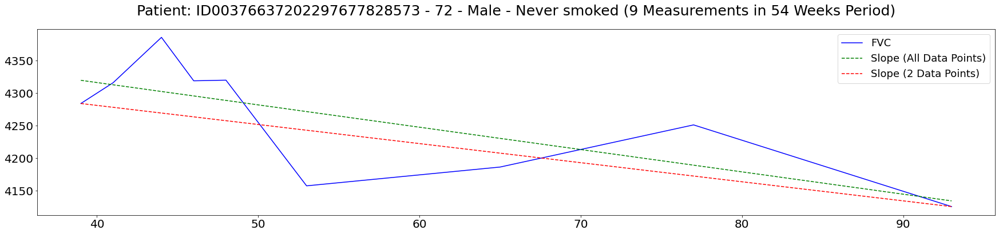

Patient: ID00378637202298597306391 FVC Statistical Summary
----------------------------------------------------------
Mean: 3317.56  -  Median: 3290.0  -  Std: 211.915
Min: 2939 -  Max: 3629
Skew: 0.0311387  -  Kurtosis: 0.602102
----------------------------------------------------------
Change Mean: 183.125  - Change Median: 95.0  - Change Std: 163.623
Change Min: 6.0 -  Change Max: 439.0
Change Skew: 0.661388 -  Change Kurtosis: -1.55455
----------------------------------------------------------
Slope (Calculated with All Data Points): -3.9567
Slope (Calculated with 2 Data Points): -7.25455


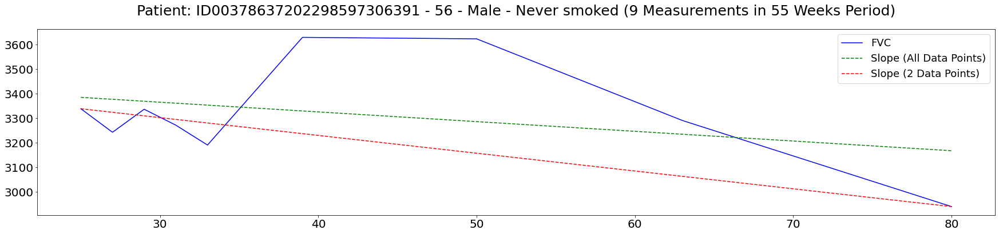

Patient: ID00381637202299644114027 FVC Statistical Summary
----------------------------------------------------------
Mean: 2179.29  -  Median: 2202.0  -  Std: 165.057
Min: 1996 -  Max: 2415
Skew: 0.183587  -  Kurtosis: -1.57935
----------------------------------------------------------
Change Mean: 100.833  - Change Median: 113.0  - Change Std: 60.4332
Change Min: 1.0 -  Change Max: 173.0
Change Skew: -0.783503 -  Change Kurtosis: 0.548051
----------------------------------------------------------
Slope (Calculated with All Data Points): -15.3295
Slope (Calculated with 2 Data Points): -16.1154


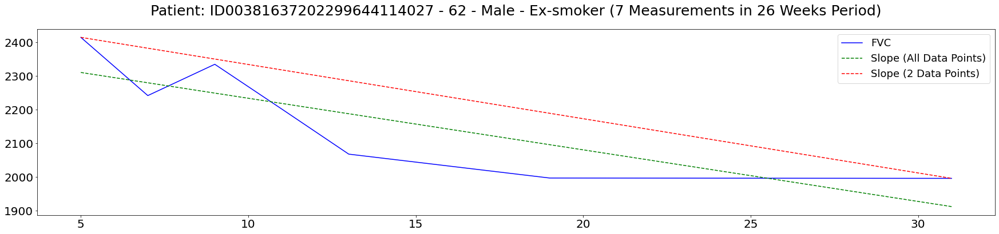

Patient: ID00383637202300493233675 FVC Statistical Summary
----------------------------------------------------------
Mean: 3096.33  -  Median: 3109.0  -  Std: 121.471
Min: 2862 -  Max: 3246
Skew: -0.626208  -  Kurtosis: 0.403061
----------------------------------------------------------
Change Mean: 114.125  - Change Median: 125.0  - Change Std: 51.6871
Change Min: 45.0 -  Change Max: 174.0
Change Skew: -0.196522 -  Change Kurtosis: -1.86307
----------------------------------------------------------
Slope (Calculated with All Data Points): -4.49784
Slope (Calculated with 2 Data Points): -3.72222


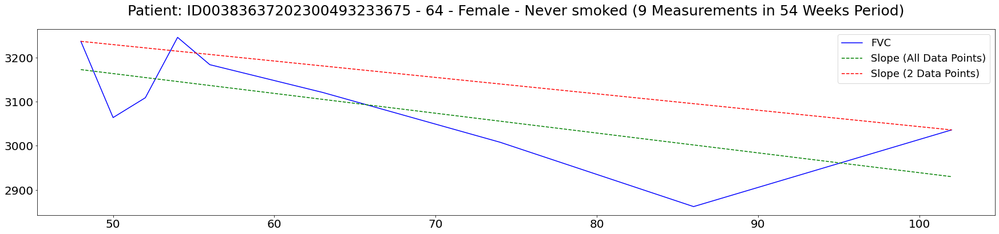

Patient: ID00388637202301028491611 FVC Statistical Summary
----------------------------------------------------------
Mean: 3033.4  -  Median: 3043.5  -  Std: 142.357
Min: 2756 -  Max: 3282
Skew: -0.337297  -  Kurtosis: 1.21863
----------------------------------------------------------
Change Mean: 111.667  - Change Median: 102.0  - Change Std: 84.9323
Change Min: 16.0 -  Change Max: 240.0
Change Skew: 0.511207 -  Change Kurtosis: -1.09828
----------------------------------------------------------
Slope (Calculated with All Data Points): -5.16613
Slope (Calculated with 2 Data Points): -6.79661


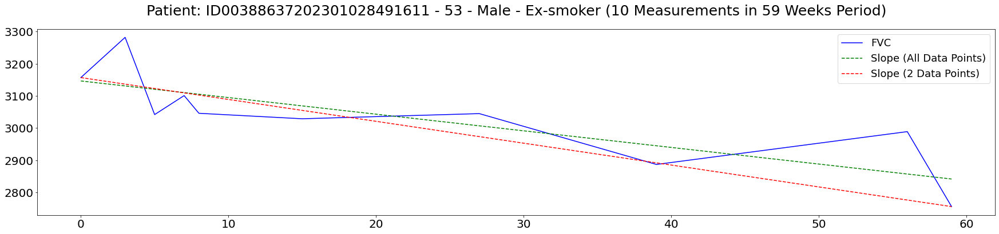

Patient: ID00392637202302319160044 FVC Statistical Summary
----------------------------------------------------------
Mean: 2048.89  -  Median: 2058.0  -  Std: 151.858
Min: 1808 -  Max: 2231
Skew: -0.576882  -  Kurtosis: -0.708264
----------------------------------------------------------
Change Mean: 84.875  - Change Median: 86.0  - Change Std: 53.4427
Change Min: 18.0 -  Change Max: 166.0
Change Skew: 0.0973081 -  Change Kurtosis: -1.33097
----------------------------------------------------------
Slope (Calculated with All Data Points): -7.61722
Slope (Calculated with 2 Data Points): -7.83333


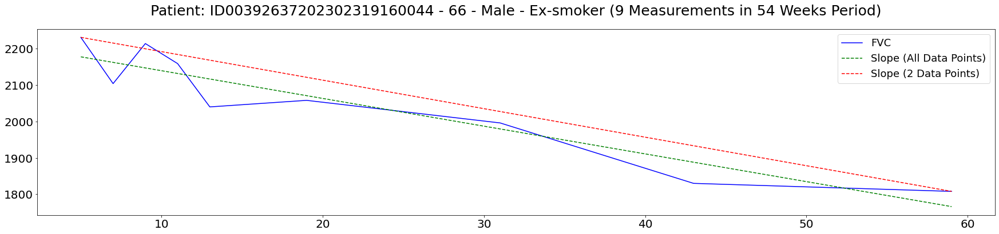

Patient: ID00393637202302431697467 FVC Statistical Summary
----------------------------------------------------------
Mean: 3671.67  -  Median: 3589.0  -  Std: 148.499
Min: 3540 -  Max: 3936
Skew: 1.11078  -  Kurtosis: -0.363154
----------------------------------------------------------
Change Mean: 170.25  - Change Median: 154.0  - Change Std: 142.499
Change Min: 1.0 -  Change Max: 374.0
Change Skew: 0.347157 -  Change Kurtosis: -1.47051
----------------------------------------------------------
Slope (Calculated with All Data Points): -3.44433
Slope (Calculated with 2 Data Points): -0.37931


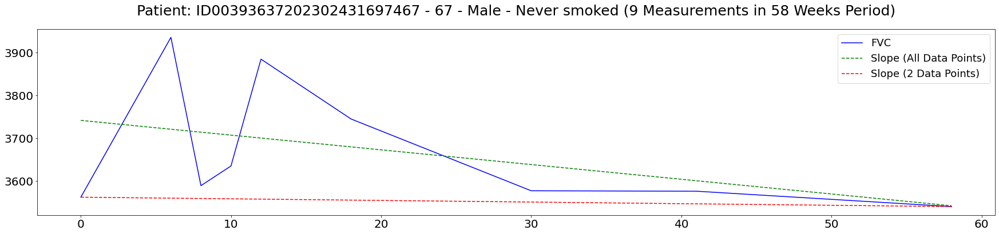

Patient: ID00398637202303897337979 FVC Statistical Summary
----------------------------------------------------------
Mean: 2632.0  -  Median: 2700.0  -  Std: 320.283
Min: 2083 -  Max: 3046
Skew: -0.539352  -  Kurtosis: -0.535678
----------------------------------------------------------
Change Mean: 137.571  - Change Median: 131.0  - Change Std: 86.9307
Change Min: 31.0 -  Change Max: 266.0
Change Skew: 0.157611 -  Change Kurtosis: -1.03165
----------------------------------------------------------
Slope (Calculated with All Data Points): -23.1145
Slope (Calculated with 2 Data Points): -25.3421


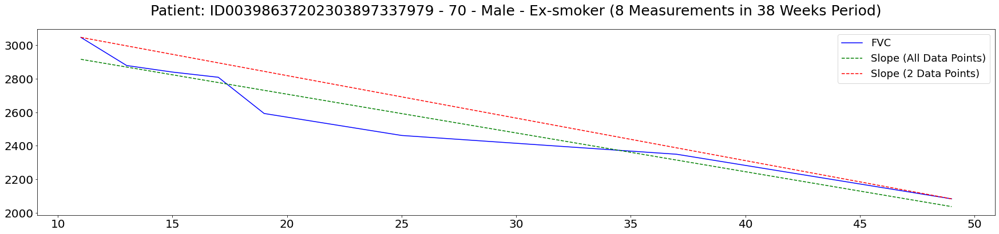

Patient: ID00400637202305055099402 FVC Statistical Summary
----------------------------------------------------------
Mean: 3922.0  -  Median: 3930.0  -  Std: 68.5468
Min: 3797 -  Max: 4014
Skew: -0.32437  -  Kurtosis: -0.263367
----------------------------------------------------------
Change Mean: 68.4444  - Change Median: 64.0  - Change Std: 62.674
Change Min: 1.0 -  Change Max: 217.0
Change Skew: 1.84649 -  Change Kurtosis: 4.35732
----------------------------------------------------------
Slope (Calculated with All Data Points): -0.929922
Slope (Calculated with 2 Data Points): -1.57143


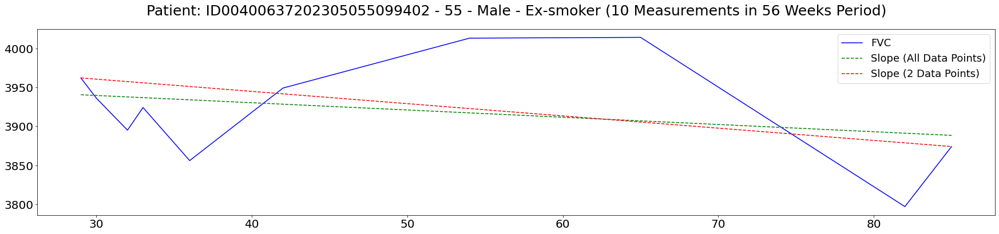

Patient: ID00401637202305320178010 FVC Statistical Summary
----------------------------------------------------------
Mean: 1894.44  -  Median: 1889.0  -  Std: 140.8
Min: 1734 -  Max: 2184
Skew: 0.998668  -  Kurtosis: 1.12914
----------------------------------------------------------
Change Mean: 114.75  - Change Median: 107.0  - Change Std: 89.5828
Change Min: 3.0 -  Change Max: 242.0
Change Skew: 0.173461 -  Change Kurtosis: -1.50371
----------------------------------------------------------
Slope (Calculated with All Data Points): -0.883794
Slope (Calculated with 2 Data Points): -5.12281


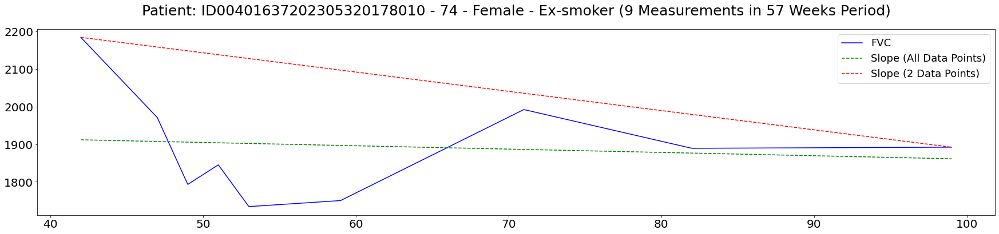

Patient: ID00405637202308359492977 FVC Statistical Summary
----------------------------------------------------------
Mean: 1534.56  -  Median: 1547.0  -  Std: 59.353
Min: 1412 -  Max: 1603
Skew: -1.23706  -  Kurtosis: 1.28156
----------------------------------------------------------
Change Mean: 73.125  - Change Median: 77.5  - Change Std: 51.6401
Change Min: 14.0 -  Change Max: 135.0
Change Skew: -0.0293167 -  Change Kurtosis: -2.0879
----------------------------------------------------------
Slope (Calculated with All Data Points): -1.17905
Slope (Calculated with 2 Data Points): -0.224138


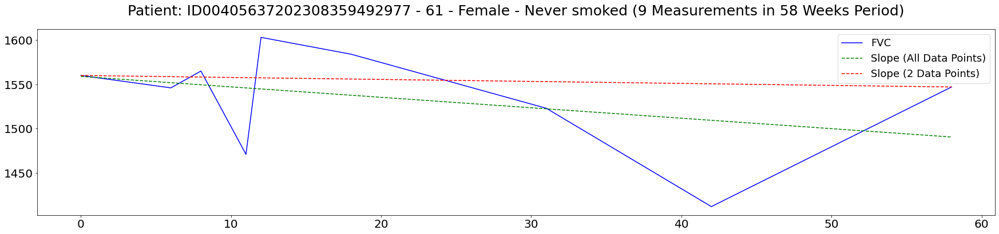

Patient: ID00407637202308788732304 FVC Statistical Summary
----------------------------------------------------------
Mean: 3095.56  -  Median: 3096.0  -  Std: 100.587
Min: 2944 -  Max: 3201
Skew: -0.427064  -  Kurtosis: -1.48911
----------------------------------------------------------
Change Mean: 76.25  - Change Median: 60.5  - Change Std: 63.457
Change Min: 11.0 -  Change Max: 158.0
Change Skew: 0.319817 -  Change Kurtosis: -2.09906
----------------------------------------------------------
Slope (Calculated with All Data Points): -4.51305
Slope (Calculated with 2 Data Points): -4.0


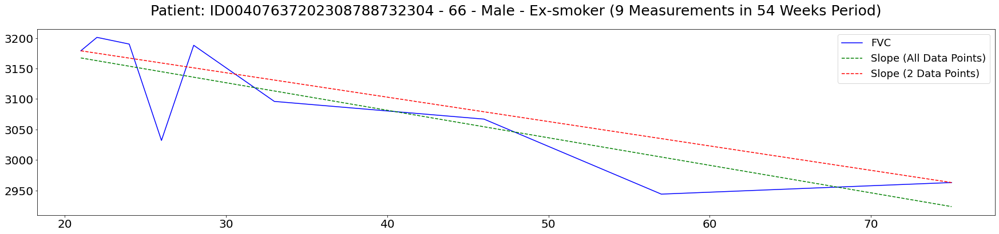

Patient: ID00408637202308839708961 FVC Statistical Summary
----------------------------------------------------------
Mean: 2412.62  -  Median: 2399.0  -  Std: 132.242
Min: 2181 -  Max: 2651
Skew: 0.144551  -  Kurtosis: 2.02977
----------------------------------------------------------
Change Mean: 136.429  - Change Median: 130.0  - Change Std: 91.431
Change Min: 30.0 -  Change Max: 274.0
Change Skew: 0.237329 -  Change Kurtosis: -1.26236
----------------------------------------------------------
Slope (Calculated with All Data Points): 0.0166596
Slope (Calculated with 2 Data Points): -6.35135


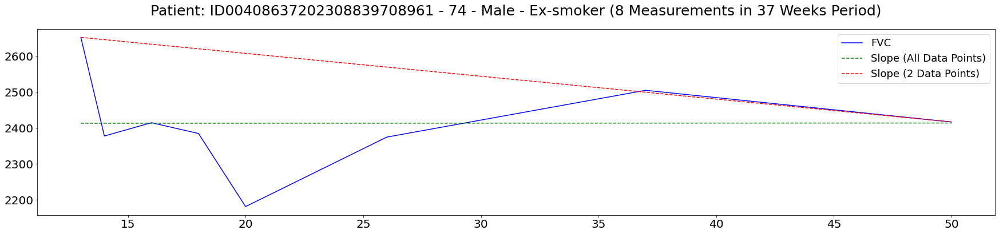

Patient: ID00411637202309374271828 FVC Statistical Summary
----------------------------------------------------------
Mean: 1722.67  -  Median: 1746.0  -  Std: 90.3147
Min: 1556 -  Max: 1843
Skew: -0.577061  -  Kurtosis: -0.226545
----------------------------------------------------------
Change Mean: 108.75  - Change Median: 100.0  - Change Std: 56.3858
Change Min: 55.0 -  Change Max: 232.0
Change Skew: 1.68188 -  Change Kurtosis: 3.42416
----------------------------------------------------------
Slope (Calculated with All Data Points): -0.956803
Slope (Calculated with 2 Data Points): 1.77358


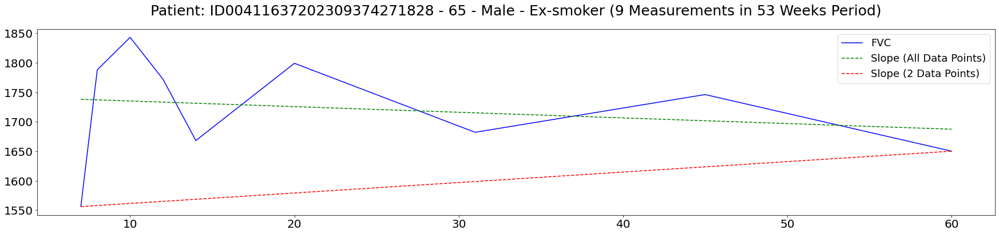

Patient: ID00414637202310318891556 FVC Statistical Summary
----------------------------------------------------------
Mean: 2440.78  -  Median: 2612.0  -  Std: 425.608
Min: 1612 -  Max: 3006
Skew: -0.710963  -  Kurtosis: 0.493014
----------------------------------------------------------
Change Mean: 282.875  - Change Median: 281.0  - Change Std: 166.168
Change Min: 10.0 -  Change Max: 549.0
Change Skew: -0.123055 -  Change Kurtosis: 0.196574
----------------------------------------------------------
Slope (Calculated with All Data Points): -20.4537
Slope (Calculated with 2 Data Points): -17.9821


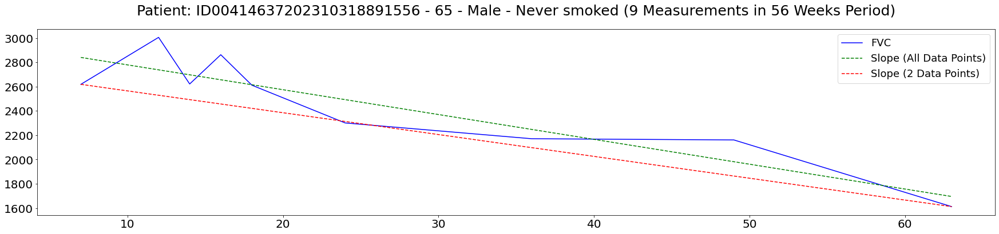

Patient: ID00417637202310901214011 FVC Statistical Summary
----------------------------------------------------------
Mean: 3317.56  -  Median: 3305.0  -  Std: 53.0144
Min: 3240 -  Max: 3397
Skew: 0.00669156  -  Kurtosis: -1.29944
----------------------------------------------------------
Change Mean: 77.5  - Change Median: 72.0  - Change Std: 35.1202
Change Min: 40.0 -  Change Max: 124.0
Change Skew: 0.34915 -  Change Kurtosis: -1.69453
----------------------------------------------------------
Slope (Calculated with All Data Points): -1.1616
Slope (Calculated with 2 Data Points): -1.01887


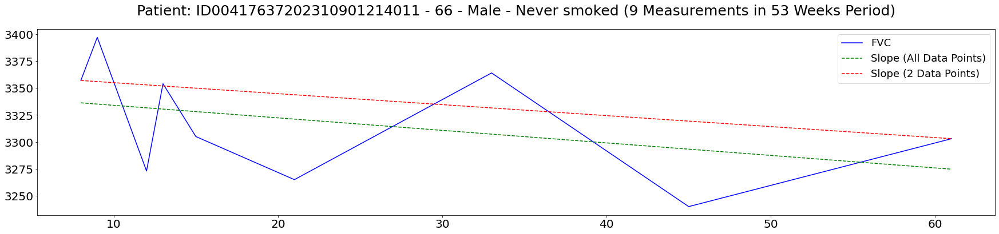

Patient: ID00419637202311204720264 FVC Statistical Summary
----------------------------------------------------------
Mean: 2782.33  -  Median: 2738.0  -  Std: 102.983
Min: 2694 -  Max: 3020
Skew: 1.80493  -  Kurtosis: 3.39667
----------------------------------------------------------
Change Mean: 66.125  - Change Median: 65.0  - Change Std: 46.1161
Change Min: 14.0 -  Change Max: 161.0
Change Skew: 1.17415 -  Change Kurtosis: 2.20397
----------------------------------------------------------
Slope (Calculated with All Data Points): -2.13598
Slope (Calculated with 2 Data Points): -5.5283


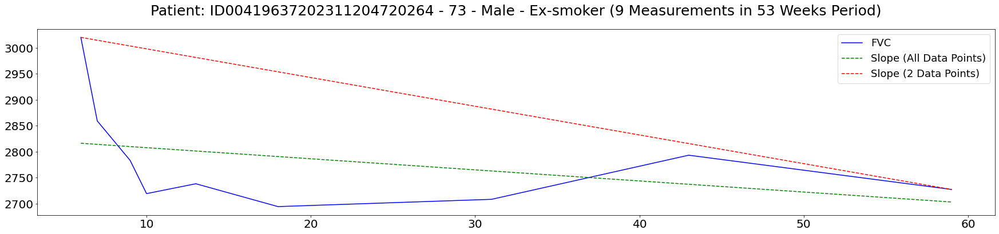

Patient: ID00421637202311550012437 FVC Statistical Summary
----------------------------------------------------------
Mean: 2759.0  -  Median: 2755.5  -  Std: 66.0067
Min: 2628 -  Max: 2853
Skew: -0.451642  -  Kurtosis: 0.519244
----------------------------------------------------------
Change Mean: 74.0  - Change Median: 65.0  - Change Std: 51.6624
Change Min: 1.0 -  Change Max: 143.0
Change Skew: 0.0202666 -  Change Kurtosis: -1.42306
----------------------------------------------------------
Slope (Calculated with All Data Points): -1.55403
Slope (Calculated with 2 Data Points): -0.363636


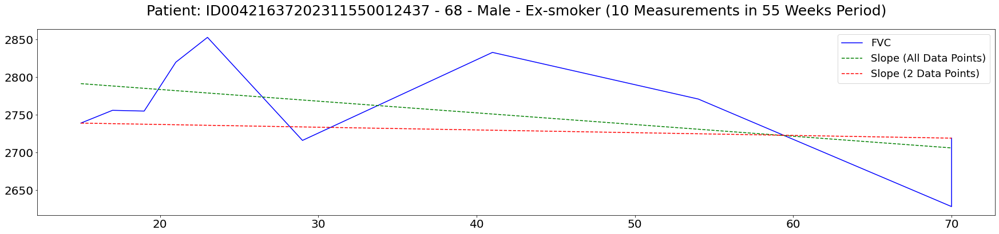

Patient: ID00422637202311677017371 FVC Statistical Summary
----------------------------------------------------------
Mean: 1885.88  -  Median: 1913.5  -  Std: 80.0597
Min: 1713 -  Max: 1955
Skew: -1.66055  -  Kurtosis: 2.95789
----------------------------------------------------------
Change Mean: 66.1429  - Change Median: 49.0  - Change Std: 50.4659
Change Min: 6.0 -  Change Max: 149.0
Change Skew: 0.563408 -  Change Kurtosis: -0.492009
----------------------------------------------------------
Slope (Calculated with All Data Points): -4.7401
Slope (Calculated with 2 Data Points): -5.29268


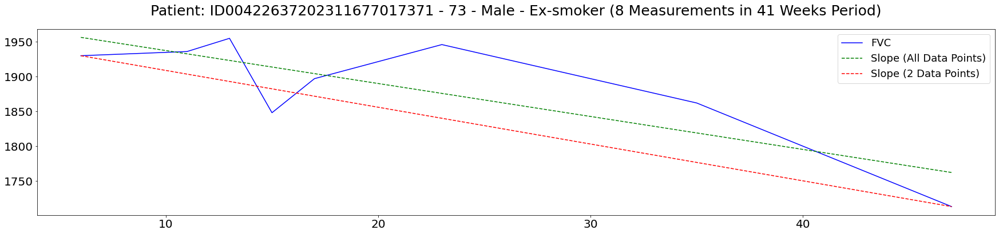

Patient: ID00423637202312137826377 FVC Statistical Summary
----------------------------------------------------------
Mean: 2750.0  -  Median: 2700.0  -  Std: 265.29
Min: 2432 -  Max: 3294
Skew: 1.10646  -  Kurtosis: 1.19357
----------------------------------------------------------
Change Mean: 233.75  - Change Median: 204.0  - Change Std: 155.846
Change Min: 77.0 -  Change Max: 517.0
Change Skew: 0.779172 -  Change Kurtosis: -0.231173
----------------------------------------------------------
Slope (Calculated with All Data Points): -9.21489
Slope (Calculated with 2 Data Points): -13.5094


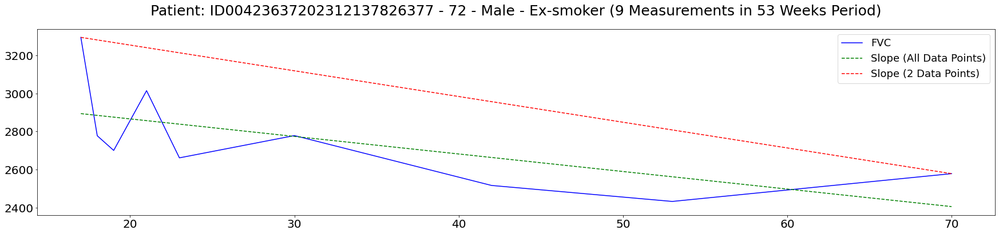

Patient: ID00426637202313170790466 FVC Statistical Summary
----------------------------------------------------------
Mean: 2896.33  -  Median: 2916.0  -  Std: 93.2322
Min: 2712 -  Max: 2978
Skew: -1.29381  -  Kurtosis: 0.754953
----------------------------------------------------------
Change Mean: 120.375  - Change Median: 68.5  - Change Std: 105.947
Change Min: 13.0 -  Change Max: 266.0
Change Skew: 0.622254 -  Change Kurtosis: -1.71102
----------------------------------------------------------
Slope (Calculated with All Data Points): -1.08132
Slope (Calculated with 2 Data Points): -2.55932


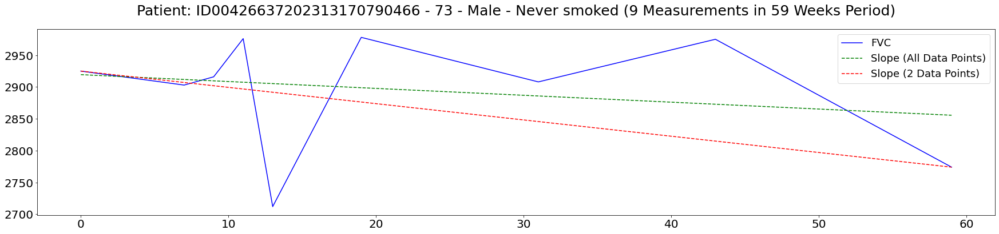

In [9]:
df_train['FVC_diff-1'] = np.abs(df_train.groupby('Patient')['FVC'].diff(-1))
df_train['FVC_First'] = df_train.groupby('Patient')['FVC'].transform('first')
df_train['FVC_Last'] = df_train.groupby('Patient')['FVC'].transform('last')
df_train['Weeks_First'] = df_train.groupby('Patient')['Weeks'].transform('first')
df_train['Weeks_Last'] = df_train.groupby('Patient')['Weeks'].transform('last')

df_train['2_Data_Point_Slope'] =  (df_train['FVC_Last'] - df_train['FVC_First']) / (df_train['Weeks_Last'] - df_train['Weeks_First'])

for patient, df in df_train.groupby('Patient'):
    slope, intercept, _, _, _ = linregress(df['Weeks'], df['FVC'])
    df_train.loc[df_train['Patient'] == patient, 'All_Data_Point_Slope'] = slope
    df_train.loc[df_train['Patient'] == patient, 'Intercept'] = intercept
    
def plot_fvc(df, patient):
    
    xs = df['FVC_First'].unique().tolist() +  df['FVC_Last'].unique().tolist()
    ys = df['Weeks_First'].unique().tolist() +  df['Weeks_Last'].unique().tolist()
            
    ax = df[(['Weeks', 'FVC',])].set_index('Weeks').plot(figsize=(30, 6), style=['b-'])
    ax.plot(df['Weeks'], df['All_Data_Point_Slope'] * df['Weeks'] + df['Intercept'], label='Slope (All Data Points)', color='green', linestyle='--')
    ax.plot(ys, xs, label='Slope (2 Data Points)', color='red', linestyle='--')
    
    plt.tick_params(axis='x', labelsize=20)
    plt.tick_params(axis='y', labelsize=20)
    plt.xlabel('')
    plt.ylabel('')
    plt.title(f'Patient: {patient} - {df["Age"].tolist()[0]} - {df["Sex"].tolist()[0]} - {df["SmokingStatus"].tolist()[0]} ({len(df)} Measurements in {(df["Weeks"].max() - df["Weeks"].min())} Weeks Period)', size=25, pad=25)
    plt.legend(prop={'size': 18})
    plt.show()

for patient, df in list(df_train.groupby('Patient')):

    print(f'Patient: {patient} FVC Statistical Summary\n{"-" * 58}')
    print(f'Mean: {df["FVC"].mean():.6}  -  Median: {df["FVC"].median():.6}  -  Std: {df["FVC"].std():.6}')
    print(f'Min: {df["FVC"].min()} -  Max: {df["FVC"].max()}')
    print(f'Skew: {df["FVC"].skew():.6}  -  Kurtosis: {df["FVC"].kurtosis():.6}\n{"-" * 58}')
    print(f'Change Mean: {df["FVC_diff-1"].mean():.6}  - Change Median: {df["FVC_diff-1"].median():.6}  - Change Std: {df["FVC_diff-1"].std():.6}')
    print(f'Change Min: {df["FVC_diff-1"].min()} -  Change Max: {df["FVC_diff-1"].max()}')
    print(f'Change Skew: {df["FVC_diff-1"].skew():.6} -  Change Kurtosis: {df["FVC_diff-1"].kurtosis():.6}\n{"-" * 58}')
    print(f'Slope (Calculated with All Data Points): {df["All_Data_Point_Slope"].values[0]:.6}')
    print(f'Slope (Calculated with 2 Data Points): {df["2_Data_Point_Slope"].values[0]:.6}')
    
    plot_fvc(df, patient)
    
df_train.drop(columns=['FVC_diff-1', 'FVC_First', 'FVC_Last', 'Weeks_First', 'Weeks_Last'], inplace=True)

## **4. Tabular Data**

### **4.1. Continuous Features**

There are four continuous features along with `FVC` in tabular data. Those features are:

* `Weeks`: The relative number of weeks pre/post the baseline CT (may be negative). It doesn't have any significant relationship with other features because patients got both better or worse over the course of time regardless of their `Age`.
* `Percent`: A computed field which approximates the patient's `FVC` as a percent of the typical `FVC` for a person of similar characteristics. This feature has a strong relationship with `FVC` because it is derived from it, but it doesn't have any significant relationship with other features.
* `Age`: Age of the patient. `Age` has a slight relationship with `FVC` and `Percent` since younger patients have higher lung capacity.

Distributions of `FVC`, `Percent` and `Age` are very similar but `Weeks` is different than those features.

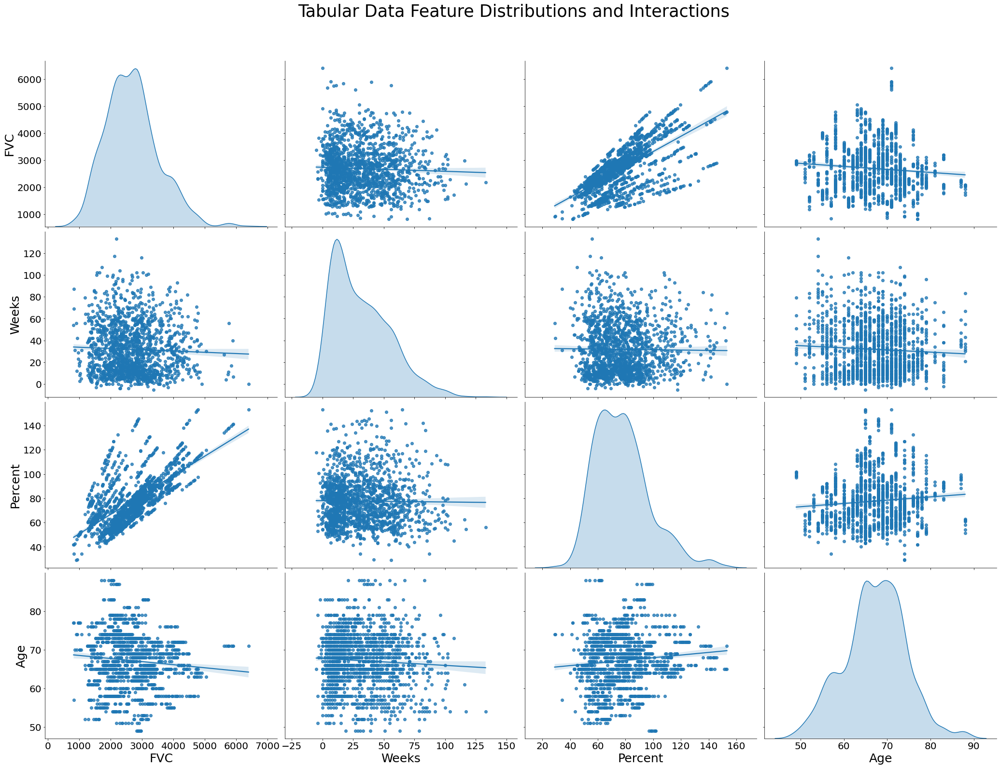

In [10]:
g = sns.pairplot(df_train[['FVC', 'Weeks', 'Percent', 'Age']], aspect=1.4, height=5, diag_kind='kde', kind='reg')

g.axes[3, 0].set_xlabel('FVC', fontsize=25)
g.axes[3, 1].set_xlabel('Weeks', fontsize=25)
g.axes[3, 2].set_xlabel('Percent', fontsize=25)
g.axes[3, 3].set_xlabel('Age', fontsize=25)
g.axes[0, 0].set_ylabel('FVC', fontsize=25)
g.axes[1, 0].set_ylabel('Weeks', fontsize=25)
g.axes[2, 0].set_ylabel('Percent', fontsize=25)
g.axes[3, 0].set_ylabel('Age', fontsize=25)

g.axes[3, 0].tick_params(axis='x', labelsize=20)
g.axes[3, 1].tick_params(axis='x', labelsize=20)
g.axes[3, 2].tick_params(axis='x', labelsize=20)
g.axes[3, 3].tick_params(axis='x', labelsize=20)
g.axes[0, 0].tick_params(axis='y', labelsize=20)
g.axes[1, 0].tick_params(axis='y', labelsize=20)
g.axes[2, 0].tick_params(axis='y', labelsize=20)
g.axes[3, 0].tick_params(axis='y', labelsize=20)

g.fig.suptitle('Tabular Data Feature Distributions and Interactions', fontsize=35, y=1.08)

plt.show()

### **4.2. Sex**

The first categorical feature in tabular data is `Sex` which is basically gender of the patient. In training set, **139** (79%) patients are male and **37** (21%) patients are female.

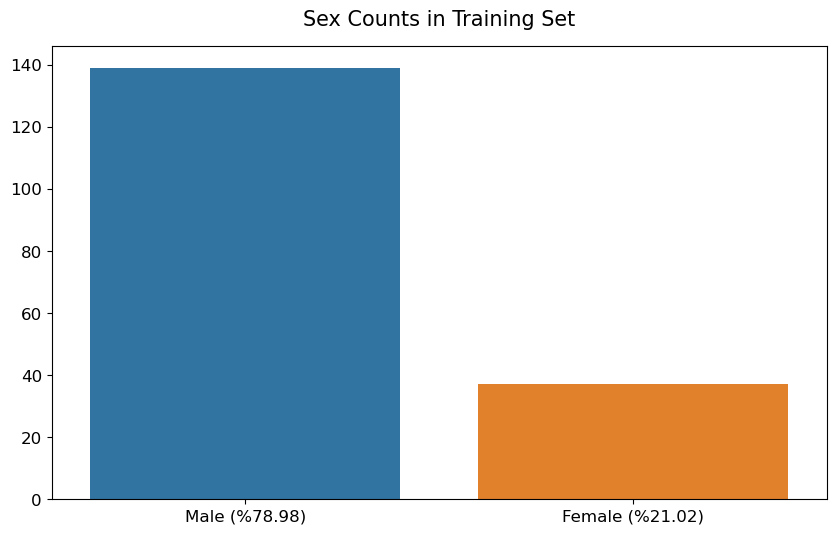

In [11]:
fig = plt.figure(figsize=(10, 6), dpi=100)

sns.barplot(x=df_train.groupby('Patient')['Sex'].first().value_counts().index, y=df_train.groupby('Patient')['Sex'].first().value_counts())
percentages = [(count / df_train.groupby('Patient')['Sex'].first().value_counts().sum() * 100).round(2) for count in df_train.groupby('Patient')['Sex'].first().value_counts()]

plt.ylabel('')
plt.xticks(np.arange(2), [f'Male (%{percentages[0]})', f'Female (%{percentages[1]})'])
plt.tick_params(axis='x', labelsize=12)
plt.tick_params(axis='y', labelsize=12)
plt.title('Sex Counts in Training Set', size=15, pad=15)

plt.show()

`FVC` distributions of males and females are very different from each other. Females have lower lung capacity compared to males due to genetics. `FVC` relationships with other features are also very different for males and females. `FVC` of males have a stronger relationship with `Percent` and `Age` compared to `FVC` of females.

Comparing `Weeks` for different genders is not logical but females have a decent `FVC` improvement over the course weeks compared to males.

`Percent` distributions of males and females are very different from each other just like `FVC` distributions because `Percent` is derived from it.

`Age` has no differences between males and females in terms of relationships and distributions except female's `Age` distribution have slightly longer tails and a shorter peak.

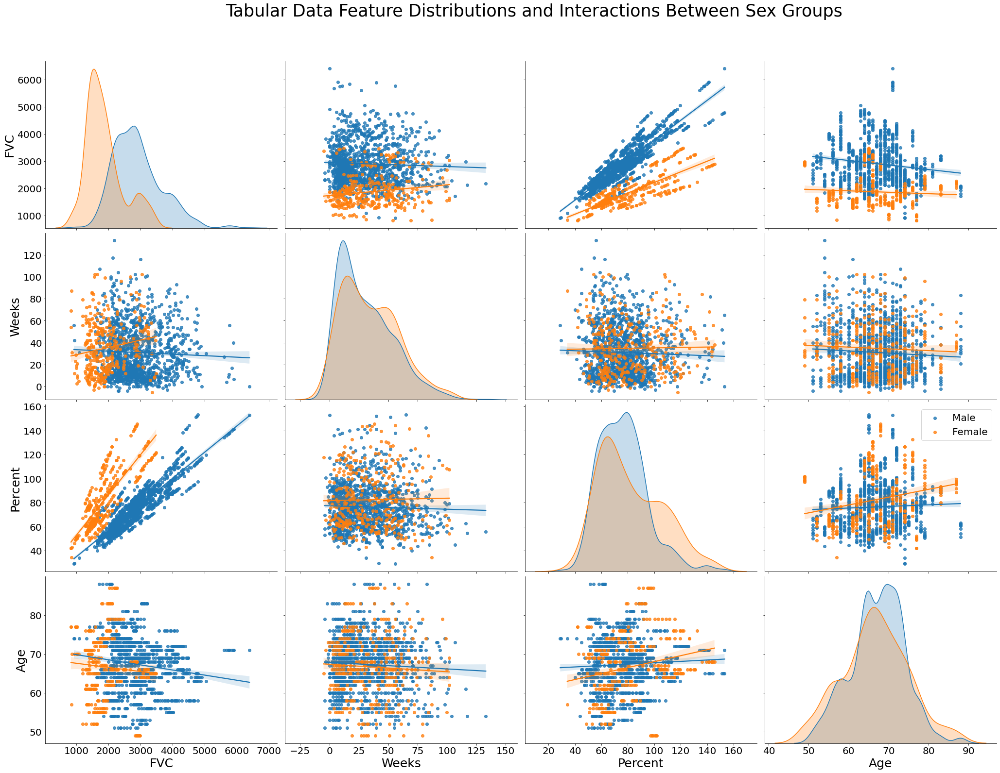

In [12]:
g = sns.pairplot(df_train[['FVC', 'Weeks', 'Percent', 'Age', 'Sex']], hue='Sex', aspect=1.4, height=5, diag_kind='kde', kind='reg')

g.axes[3, 0].set_xlabel('FVC', fontsize=25)
g.axes[3, 1].set_xlabel('Weeks', fontsize=25)
g.axes[3, 2].set_xlabel('Percent', fontsize=25)
g.axes[3, 3].set_xlabel('Age', fontsize=25)
g.axes[0, 0].set_ylabel('FVC', fontsize=25)
g.axes[1, 0].set_ylabel('Weeks', fontsize=25)
g.axes[2, 0].set_ylabel('Percent', fontsize=25)
g.axes[3, 0].set_ylabel('Age', fontsize=25)

g.axes[3, 0].tick_params(axis='x', labelsize=20)
g.axes[3, 1].tick_params(axis='x', labelsize=20)
g.axes[3, 2].tick_params(axis='x', labelsize=20)
g.axes[3, 3].tick_params(axis='x', labelsize=20)
g.axes[0, 0].tick_params(axis='y', labelsize=20)
g.axes[1, 0].tick_params(axis='y', labelsize=20)
g.axes[2, 0].tick_params(axis='y', labelsize=20)
g.axes[3, 0].tick_params(axis='y', labelsize=20)

plt.legend(prop={'size': 20})
g._legend.remove()
g.fig.suptitle('Tabular Data Feature Distributions and Interactions Between Sex Groups', fontsize=35, y=1.08)

plt.show()

### **4.3. SmokingStatus**

The second categorical feature in tabular data is `SmokingStatus` which is also self-explanatory. In training set, **118** (67%) patients are ex-smokers, **49** (28%) patients had never smoked and **9** (5%) patients are smokers.

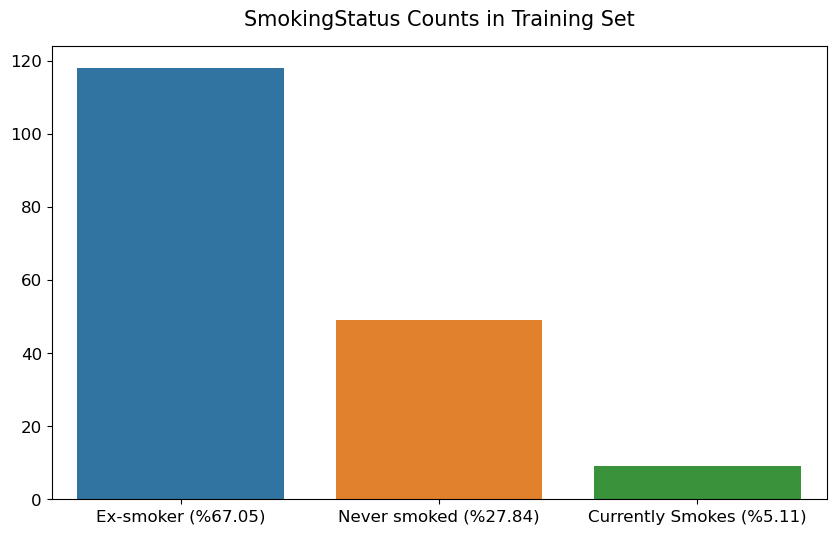

In [13]:
fig = plt.figure(figsize=(10, 6), dpi=100)

sns.barplot(x=df_train.groupby('Patient')['SmokingStatus'].first().value_counts().index, y=df_train.groupby('Patient')['SmokingStatus'].first().value_counts())
percentages = [(count / df_train.groupby('Patient')['SmokingStatus'].first().value_counts().sum() * 100).round(2) for count in df_train.groupby('Patient')['SmokingStatus'].first().value_counts()]

plt.ylabel('')
plt.xticks(np.arange(3), [f'Ex-smoker (%{percentages[0]})', f'Never smoked (%{percentages[1]})', f'Currently Smokes (%{percentages[2]})'])
plt.tick_params(axis='x', labelsize=12)
plt.tick_params(axis='y', labelsize=12)
plt.title('SmokingStatus Counts in Training Set', size=15, pad=15)

plt.show()

`FVC` distributions of `SmokingStatus` groups are quite unexpected. Mean `FVC` of smokers is  higher than mean `FVC` of ex-smokers and patients who had never smoked.

Distribution of `Weeks` is similar for different `SmokingStatus`. Smokers have the strongest positive linear relationship between `FVC` and `Weeks` which is also another unexpected phenomenon.

`Percent` distributions of different `SmokingStatus` groups is very similar to `FVC` distributions but peaks are taller. The linear relationship between `Percent` and `Weeks` is also stronger compared to `FVC` and `Weeks`.

`Age` has no relationship with `SmokingStatus`.

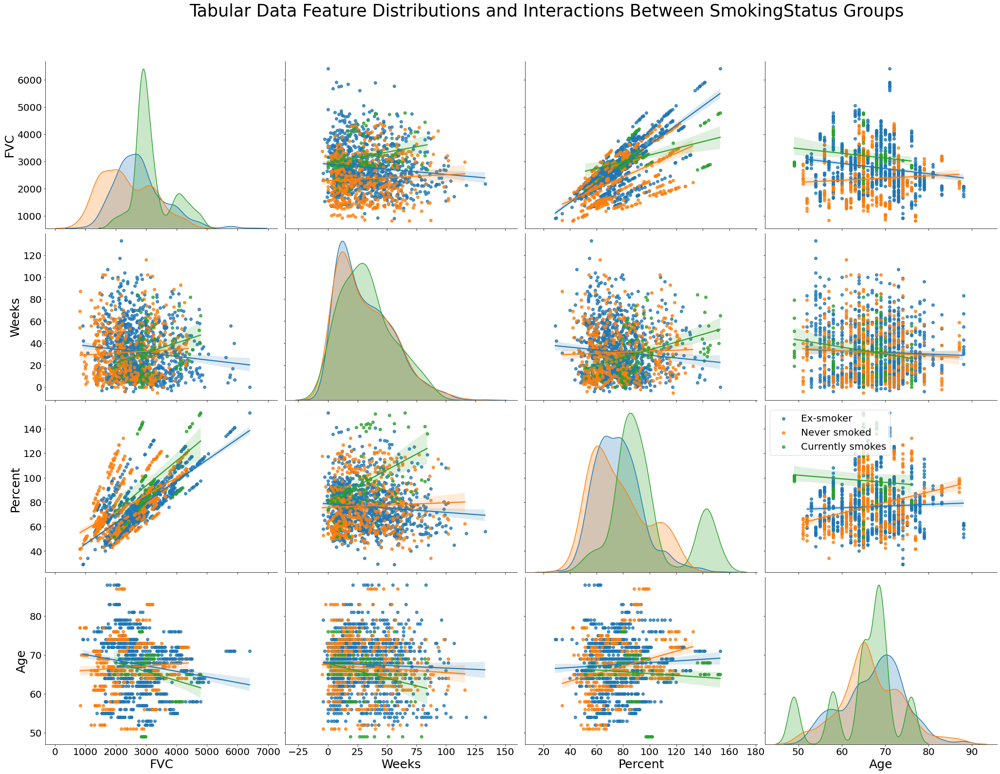

In [14]:
g = sns.pairplot(df_train[['FVC', 'Weeks', 'Percent', 'Age', 'SmokingStatus']], hue='SmokingStatus', aspect=1.4, height=5, diag_kind='kde', kind='reg')

g.axes[3, 0].set_xlabel('FVC', fontsize=25)
g.axes[3, 1].set_xlabel('Weeks', fontsize=25)
g.axes[3, 2].set_xlabel('Percent', fontsize=25)
g.axes[3, 3].set_xlabel('Age', fontsize=25)
g.axes[0, 0].set_ylabel('FVC', fontsize=25)
g.axes[1, 0].set_ylabel('Weeks', fontsize=25)
g.axes[2, 0].set_ylabel('Percent', fontsize=25)
g.axes[3, 0].set_ylabel('Age', fontsize=25)

g.axes[3, 0].tick_params(axis='x', labelsize=20)
g.axes[3, 1].tick_params(axis='x', labelsize=20)
g.axes[3, 2].tick_params(axis='x', labelsize=20)
g.axes[3, 3].tick_params(axis='x', labelsize=20)
g.axes[0, 0].tick_params(axis='y', labelsize=20)
g.axes[1, 0].tick_params(axis='y', labelsize=20)
g.axes[2, 0].tick_params(axis='y', labelsize=20)
g.axes[3, 0].tick_params(axis='y', labelsize=20)

plt.legend(prop={'size': 20})
g._legend.remove()
g.fig.suptitle('Tabular Data Feature Distributions and Interactions Between SmokingStatus Groups', fontsize=35, y=1.08)

plt.show()

### **4.4. Tabular Feature Correlations**

As seen from the plots above, the only strong correlation is between `FVC` and `Percent`. The other features' correlations are between -0.1 and 0.1.

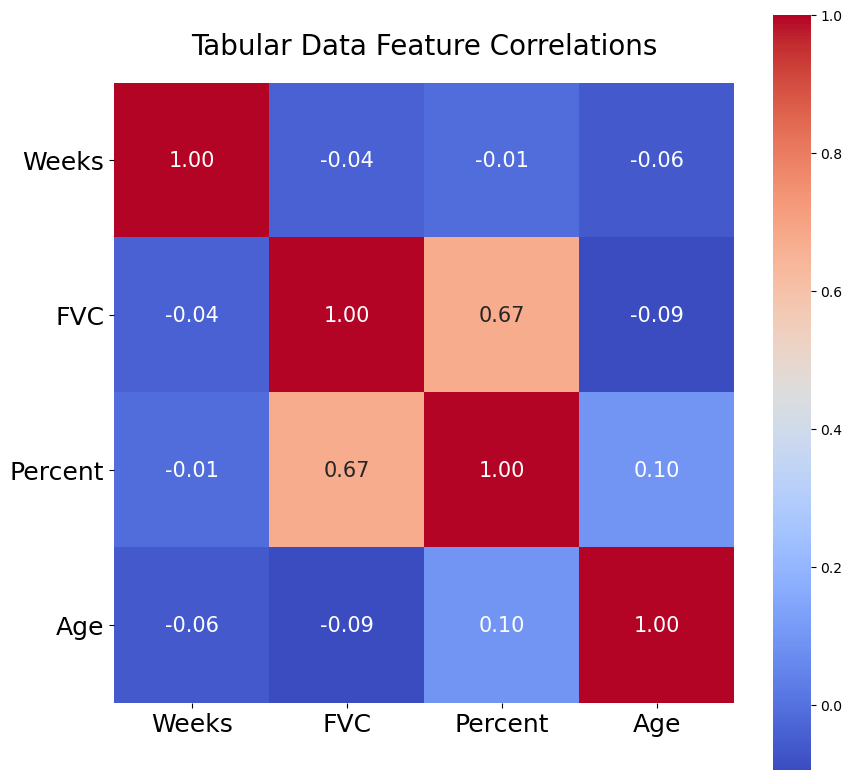

In [15]:
fig = plt.figure(figsize=(10, 10), dpi=100)

sns.heatmap(df_train[['Weeks', 'FVC', 'Percent', 'Age']].corr(), annot=True, square=True, cmap='coolwarm', annot_kws={'size': 15},  fmt='.2f')   

plt.tick_params(axis='x', labelsize=18, rotation=0)
plt.tick_params(axis='y', labelsize=18, rotation=0)
plt.title('Tabular Data Feature Correlations', size=20, pad=20)

plt.show()

## **5. DICOM Files**

A `.dcm` file is an image file saved in the Digital Imaging and Communications in Medicine (DICOM) image format. It stores a medical image, such as a CT scan or ultrasound. DCM files may also include patient information to pair the image with the patient. There are **176** directories in `osic-pulmonary-fibrosis-progression/train` and **5** directories in `osic-pulmonary-fibrosis-progression/test`. Every directory has the `.dcm` files of the corresponding patient.

In [16]:
print(f'Patients (directories) in osic-pulmonary-fibrosis-progression/train: {len(os.listdir("../input/osic-pulmonary-fibrosis-progression/train"))}')
print(f'Patients (directories) in osic-pulmonary-fibrosis-progression/test: {len(os.listdir("../input/osic-pulmonary-fibrosis-progression/test"))}')

Patients (directories) in osic-pulmonary-fibrosis-progression/train: 176
Patients (directories) in osic-pulmonary-fibrosis-progression/test: 5


Multiple `.dcm` files represent different slices of a single CT scan which is acquired at Week 0. CT scans produce 3D volumes for each scan, those volumes consist of 2D slices and each slice is a `.dcm` file. Every directory has different number of slices in `osic-pulmonary-fibrosis-progression/train`. Those number of slices are between **12** and **1018** with a median of **98**. Total number of slices adds up to **33026** for 176 patients.

Number of Image Slices in Training Set
--------------------------------------
Mean Slice Count: 187.648  -  Median Slice Count: 98 - Total Slice Count: 33026
Min Slice Count: 12 -  Max Slice Count: 1018


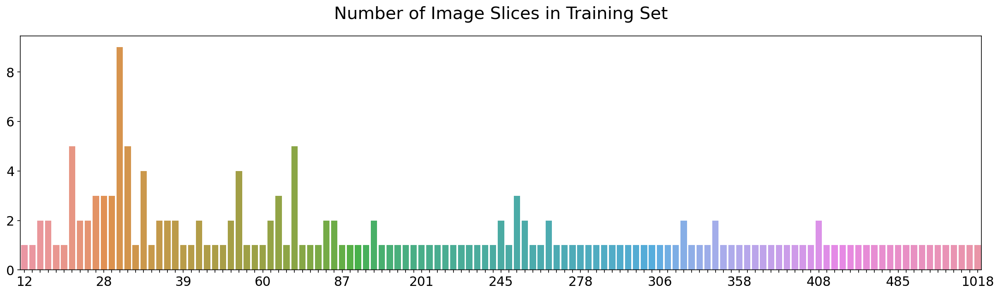

In [17]:
slice_counts = np.array([len(os.listdir(f'../input/osic-pulmonary-fibrosis-progression/train/{directory}')) for directory in os.listdir('../input/osic-pulmonary-fibrosis-progression/train')])

print(f'Number of Image Slices in Training Set\n{"-" * 38}')
print(f'Mean Slice Count: {slice_counts.mean():.6}  -  Median Slice Count: {int(np.median(slice_counts))} - Total Slice Count: {slice_counts.sum()}')
print(f'Min Slice Count: {slice_counts.min()} -  Max Slice Count: {slice_counts.max()}')

fig = plt.figure(figsize=(20, 5), dpi=150)
ax = sns.countplot(slice_counts)

for idx, label in enumerate(ax.get_xticklabels()):
    if idx % 10 == 0:
        label.set_visible(True)
    else:
        label.set_visible(False)

plt.ylabel('')
plt.tick_params(axis='x', labelsize=15)
plt.tick_params(axis='y', labelsize=15)
plt.title('Number of Image Slices in Training Set', size=20, pad=20)

plt.show()

DICOM files can be read and processed easily with `pydicom` package. DICOM files allow to store metadata along with pixel data inside them. The first patient's (`ID00228637202259965313869`) first slice (`1.dcm`) is read with `dcmread` method in the cell below.

Reading the file creates a `pydicom.dataset.FileDataset` object. Dataset can be displayed by simply printing its string (`str()` or `repr()`) value. `FileDataset` object wraps `dict` and contains `DataElement` instances. The value of each element can be one of a regular numeric, string or text value, a `list` of regular values or a `Sequence` instance, where `Sequence` is a `list` of `Dataset` instances.

In [18]:
file_path = '../input/osic-pulmonary-fibrosis-progression/train/ID00228637202259965313869/1.dcm'
dicom_file = pydicom.dcmread(file_path)

print(f'Patient: ID00228637202259965313869 Image: 1.dcm Dataset\n{"-" * 55}\n\n{dicom_file}')

Patient: ID00228637202259965313869 Image: 1.dcm Dataset
-------------------------------------------------------

Dataset.file_meta -------------------------------
(0002, 0000) File Meta Information Group Length  UL: 200
(0002, 0001) File Meta Information Version       OB: b'\x00\x01'
(0002, 0002) Media Storage SOP Class UID         UI: CT Image Storage
(0002, 0003) Media Storage SOP Instance UID      UI: 2.25.151657010963110181497791974693385217479
(0002, 0010) Transfer Syntax UID                 UI: Explicit VR Little Endian
(0002, 0012) Implementation Class UID            UI: 1.2.276.0.7230010.3.0.3.6.1
(0002, 0013) Implementation Version Name         SH: 'OSIRIX_361'
(0002, 0016) Source Application Entity Title     AE: 'ANONYMOUS'
-------------------------------------------------
(0008, 0005) Specific Character Set              CS: 'ISO_IR 100'
(0008, 0008) Image Type                          CS: ['ORIGINAL', 'PRIMARY', 'AXIAL', 'CT_SOM5 SPI']
(0008, 0018) SOP Instance UID          

`pydicom` uses dictionary interface so data inside the files can be accessed with `keys()` and `values()` methods. `.keys()` method shows that keys are tuple pairs and they are called tag numbers. Specific elements can be accessed by their DICOM keywords or tag numbers, but using DICOM keywords is the recommended way. If data is accessed with the tag number, `.value` should be added to end of square brackets.

In [19]:
print(f'Accessing Patient Name with DICOM Keyword (PatientName): {dicom_file.PatientName}')
print(f'Accessing Patient Name with Tag Number ((0x10, 0x10)): {dicom_file[(0x10, 0x10)].value}')

Accessing Patient Name with DICOM Keyword (PatientName): ID00228637202259965313869
Accessing Patient Name with Tag Number ((0x10, 0x10)): ID00228637202259965313869


If you don't remember the exact keywords, `Dataset.dir()` can be used to return all non-private element keywords in the dataset. All of the data associated with the keywords below, can be accessed by `Dataset.Keyword`.

In [20]:
dicom_file.dir()

['BitsAllocated',
 'BitsStored',
 'BodyPartExamined',
 'Columns',
 'ConvolutionKernel',
 'DeidentificationMethod',
 'DistanceSourceToDetector',
 'DistanceSourceToPatient',
 'FocalSpots',
 'FrameOfReferenceUID',
 'GantryDetectorTilt',
 'GeneratorPower',
 'HighBit',
 'ImageOrientationPatient',
 'ImagePositionPatient',
 'ImageType',
 'InstanceNumber',
 'KVP',
 'LargestImagePixelValue',
 'Manufacturer',
 'ManufacturerModelName',
 'Modality',
 'PatientID',
 'PatientName',
 'PatientPosition',
 'PatientSex',
 'PhotometricInterpretation',
 'PixelData',
 'PixelRepresentation',
 'PixelSpacing',
 'PositionReferenceIndicator',
 'RescaleIntercept',
 'RescaleSlope',
 'RescaleType',
 'RotationDirection',
 'Rows',
 'SOPInstanceUID',
 'SamplesPerPixel',
 'SeriesInstanceUID',
 'SingleCollimationWidth',
 'SliceLocation',
 'SliceThickness',
 'SmallestImagePixelValue',
 'SpecificCharacterSet',
 'SpiralPitchFactor',
 'StudyID',
 'StudyInstanceUID',
 'TableFeedPerRotation',
 'TableHeight',
 'TableSpeed',
 'T

`PixelData` keyword contains the raw bytes of the slice. It is much more convenient to use `Dataset.pixel_array` in order to return a `numpy.ndarray`. As seen from below, `ID00228637202259965313869/1.dcm` slice is a 512x512 greyscale image.

Patient: ID00228637202259965313869 Image: 1.dcm Pixel Array (512, 512)
----------------------------------------------------------------------

[[ 74  12  89 ...  26  19  91]
 [ 78  22  38 ...  17  17  39]
 [ 65  32  36 ...  33  15  10]
 ...
 [ 15   7   6 ...  25  54  61]
 [  4  58  65 ... 153 123  21]
 [ 63 141  86 ...  54  44  60]]


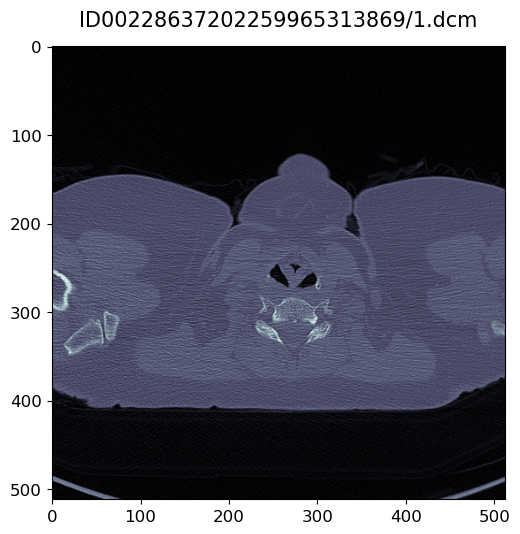

In [21]:
print(f'Patient: ID00228637202259965313869 Image: 1.dcm Pixel Array {dicom_file.pixel_array.shape}\n{"-" * 70}\n\n{dicom_file.pixel_array}')

fig = plt.figure(figsize=(6, 6), dpi=100)

plt.imshow(dicom_file.pixel_array, cmap=plt.cm.bone)

plt.tick_params(axis='x', labelsize=12)
plt.tick_params(axis='y', labelsize=12)
plt.title(f'ID00228637202259965313869/1.dcm', size=15, pad=15)

plt.show()

As the images are acquired at Week 0 in one CT scan, a single slice by itself isn't meaningful. All of the slices make up the 3D volume, so they have to be analyzed together. `load_scan` function loads every slice in the given patient directory and stacks them up. However, slice names may not be correctly ordered so it is safer to sort them by `ImagePositionPatient[2]`, that is defined as z coordinates of the upper left hand corner of the slice. The output is a 3D volume with the shape of `(n_slices, n_rows, n_columns)`.

In [22]:
def load_scan(patient_name):
    
    patient_directory = [pydicom.dcmread(f'../input/osic-pulmonary-fibrosis-progression/train/{patient_name}/{s}') for s in os.listdir(f'../input/osic-pulmonary-fibrosis-progression/train/{patient_name}')]
    patient_directory.sort(key=lambda s: float(s.ImagePositionPatient[2]))
    patient_slices = np.zeros((len(patient_directory), patient_directory[0].Rows, patient_directory[0].Columns))

    for i, s in enumerate(patient_directory):
        patient_slices[i] = s.pixel_array
            
    return patient_slices

patient = 'ID00228637202259965313869'
patient_slices = load_scan(patient)
print(f'Patient {patient} CT scan is loaded - Volume Shape: {patient_slices.shape}')

Patient ID00228637202259965313869 CT scan is loaded - Volume Shape: (347, 512, 512)


This animation shows the slices in an order. The slices are taken from bottom to top or top to bottom while the patients are holding their breath. That is the reason why area of the lungs is changing between different slices. The lung area is small at bottom and top, but it is larger at middle part.

In [23]:
%%capture

fig = plt.figure(figsize=(7, 7))

ims = []
for i in patient_slices:
    im = plt.imshow(i, animated=True, cmap=plt.cm.bone)
    plt.axis('off')
    ims.append([im])

ani = animation.ArtistAnimation(fig, ims, interval=25, blit=False, repeat_delay=1000)

In [24]:
HTML(ani.to_html5_video())

## **6. Image Metadata**

### **6.1. Metadata Extraction**

DICOM files consist of lots of different metadata and some of those fields are very useful.

First group of useful metadata features are `Rows` (X), `Columns` (Y) and `Slices` (Z). They are the three dimensions that make up the 3D volume of a single CT scan. `Rows` and `Columns` can be accessed from DICOM files but `Slices` doesn't exist in them as a field. It is the count of DICOM files in patient's directories.

Second group of useful metadata features are `SpacingBetweenSlices`, `PixelSpacing` and `SliceThickness`. `SpacingBetweenSlices` gives the distance between two adjacent slices in mm. This distance can also be calculated with `ImagePositionPatient Z` difference between slices. The other metadata feature is `PixelSpacing` that gives the distance between pixels for both X and Y axis in mm. `SliceThickness` is the nominal slice thickness in mm and it shouldn't be used for volume calculation.

In [25]:
def get_metadata(patient_name):
    
    patient_directory = [pydicom.dcmread(f'../input/osic-pulmonary-fibrosis-progression/train/{patient_name}/{s}') for s in os.listdir(f'../input/osic-pulmonary-fibrosis-progression/train/{patient_name}')]
    
    try:
        patient_directory.sort(key=lambda s: float(s.ImagePositionPatient[2]))
        slice_positions = np.round([s.ImagePositionPatient[2] for s in patient_directory], 4)
        non_duplicate_idx = np.unique([np.where(slice_position == slice_positions)[0][0] for slice_position in slice_positions])
    except AttributeError:
        patient_directory.sort(key=lambda s: int(s.InstanceNumber))
        instance_numbers = np.array([int(s.InstanceNumber) for s in patient_directory])
        non_duplicate_idx = np.unique([np.where(instance_number == instance_numbers)[0][0] for instance_number in instance_numbers])

    patient_directory = list(np.array(patient_directory)[non_duplicate_idx])   
    
    rows = patient_directory[0].Rows
    columns = patient_directory[0].Columns
    slices = len(patient_directory)
        
    pixel_spacings = np.zeros((len(patient_directory), 2))
    slice_positions = np.zeros((len(patient_directory)))
    slice_thicknesses = []
        
    for i, s in enumerate(patient_directory):
        slice_thicknesses.append(s.SliceThickness)
        try:
            pixel_spacings[i, :] = np.array(s.PixelSpacing)
        except AttributeError:
            pixel_spacings[i, :] = np.nan

        try:
            slice_positions[i] = s.ImagePositionPatient[2]
        except AttributeError:
            pass
                
    df_train.loc[df_train['Patient'] == patient_name, 'Rows'] = rows
    df_train.loc[df_train['Patient'] == patient_name, 'Columns'] = columns
    df_train.loc[df_train['Patient'] == patient_name, 'Slices'] = slices
    df_train.loc[df_train['Patient'] == patient_name, 'PixelSpacingX'] = list(np.round(pixel_spacings.mean(axis=0), 3))[0]
    df_train.loc[df_train['Patient'] == patient_name, 'PixelSpacingY'] = list(np.round(pixel_spacings.mean(axis=0), 3))[1]
    df_train.loc[df_train['Patient'] == patient_name, 'SliceSpacing'] = mode(np.abs(np.diff(np.round(slice_positions, 3))))[0][0]
    df_train.loc[df_train['Patient'] == patient_name, 'SliceThickness'] = mode(slice_thicknesses)[0][0]

        
for patient in tqdm.tqdm(df_train['Patient'].unique()):
    get_metadata(patient)
    
df_train['Rows'] = df_train['Rows'].astype(np.uint16)
df_train['Columns'] = df_train['Columns'].astype(np.uint16)
df_train['Slices'] = df_train['Slices'].astype(np.uint16)
df_train['SliceShape'] = df_train['Rows'].astype(str) + 'x' + df_train['Columns'].astype(str)
df_train['SliceThickness'] = df_train['SliceThickness'].astype(np.float32)
df_train['SliceSpacing'] = df_train['SliceSpacing'].astype(np.float32)

100%|██████████| 176/176 [02:19<00:00,  1.26it/s]


Two of the patients (`ID00132637202222178761324` and `ID00128637202219474716089`) don't have `SpacingBetweenSlices` and `ImagePositionPatient` fields in their DICOM files, so there is no way to retrieve their `SliceSpacing` feature. However, those missing values can be filled with a value from a similar CT scan. The similarity is mainly based on slice count and other metadata features.

Patient `ID00132637202222178761324` have 407 slices and most of the CT scans in that slice count range have `0.7` mm `SliceSpacing` so it is filled with `0.7`. The other patient is `ID00128637202219474716089` and it is harder to fill because `SliceSpacing` values are very diverse in that slice count range. `5.0` is used for filling the missing `SliceSpacing` in this case because it looks like it is the median value of the range.

In [26]:
print(f'Slice Counts between 400 and 410\n{"-" * 32}\n\n', df_train.groupby('Patient').first().query('400 < Slices < 410')[['Rows', 'Columns', 'Slices', 'PixelSpacingX', 'PixelSpacingY', 'SliceSpacing', 'SliceThickness']], '\n')
df_train.loc[df_train['Patient'] == 'ID00132637202222178761324', 'SliceSpacing'] = 0.7
print(f'Slice Counts between 45 and 55\n{"-" * 30}\n\n', df_train.groupby('Patient').first().query('45 < Slices < 55')[['Rows', 'Columns', 'Slices', 'PixelSpacingX', 'PixelSpacingY', 'SliceSpacing', 'SliceThickness']])
df_train.loc[df_train['Patient'] == 'ID00128637202219474716089', 'SliceSpacing'] = 5.0

Slice Counts between 400 and 410
--------------------------------

                            Rows  Columns  Slices  PixelSpacingX  PixelSpacingY  SliceSpacing  SliceThickness
Patient                                                                                                     
ID00132637202222178761324   768      768     407          0.457          0.457         0.000           1.000
ID00136637202224951350618   512      512     404          0.742          0.742         0.700           0.750
ID00186637202242472088675   512      512     408          0.654          0.654         0.700           0.750
ID00233637202260580149633   512      512     405          0.770          0.770         0.700           1.000
ID00312637202282607344793   512      512     409          0.664          0.664         0.625           0.625
ID00426637202313170790466   512      512     408          0.719          0.719         0.700           1.000 

Slice Counts between 45 and 55
---------------------------

### **6.2. Slice Shapes**

Patients have different slice shapes but shapes are consistent in patients' directories. A patient can only have one unique slice shape. There are **10** unique 2D slice shapes in training set and the most common shapes are `(512, 512)` and `(768, 768)`. There are some unusual slice shapes which are very rare. Those unusual slice shapes belong to 1 or 2 different patients.

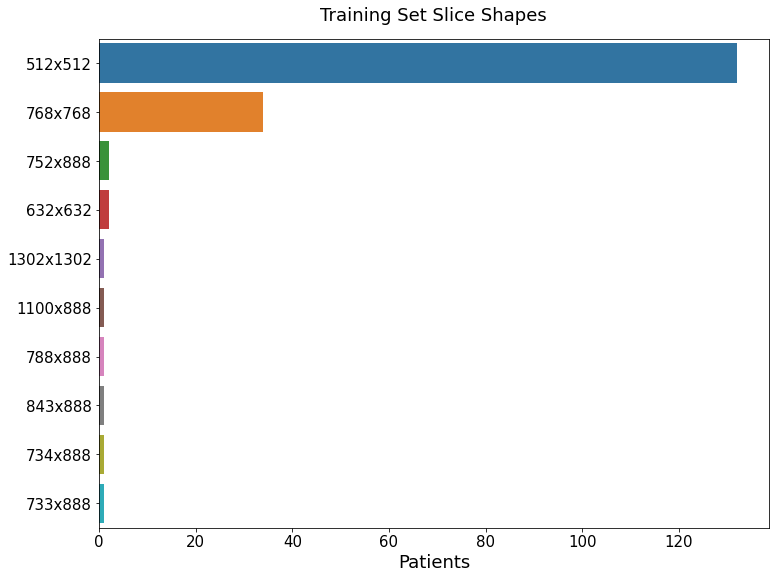

In [27]:
fig = plt.figure(figsize=(12, 9))
sns.barplot(x=df_train.groupby('Patient')['SliceShape'].first().value_counts().values, y=df_train.groupby('Patient')['SliceShape'].first().value_counts().index)

plt.xlabel('Patients', size=18)
plt.ylabel('')
plt.tick_params(axis='x', labelsize=15)
plt.tick_params(axis='y', labelsize=15)
plt.title(f'Training Set Slice Shapes', size=18, pad=18)

plt.show()

A random slice from every unique shape is drawn below. It looks like some of the shapes have a frame around the lungs. Those frames exist in only slices in which X is not equal to Y (`1100x888`, `733x888`, `734x888`, `752x888`, `788x888` and `843x888`), and it is related to LightSpeed VCT and LightSpeed Pro 16 CT scanner models. Other shapes (`512x512`, `632x632`, `768x768` and `1302x1302`) don't have those frames.

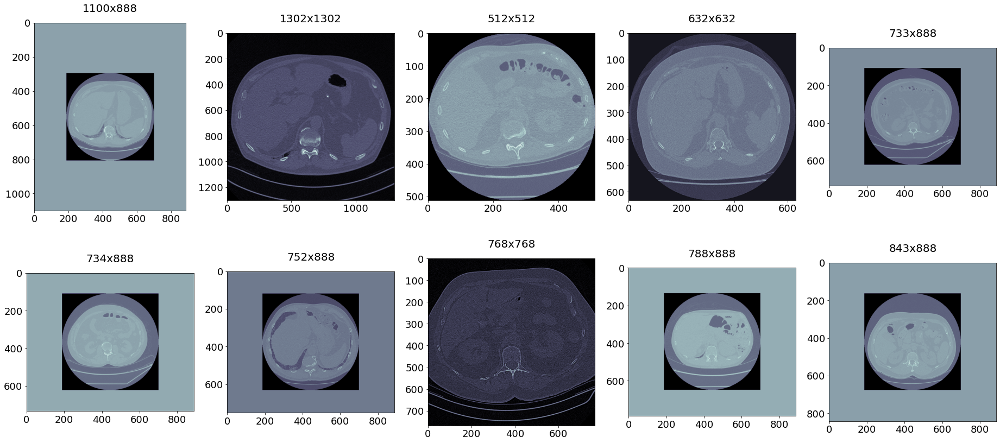

In [28]:
fig, axes = plt.subplots(figsize=(32, 14), nrows=2, ncols=5)

for i, patient_name in enumerate(df_train.groupby('SliceShape')['Patient'].first()):   
    
    patient_directory = [pydicom.dcmread(f'../input/osic-pulmonary-fibrosis-progression/train/{patient_name}/{s}') for s in os.listdir(f'../input/osic-pulmonary-fibrosis-progression/train/{patient_name}')]
    patient_directory.sort(key=lambda s: float(s.ImagePositionPatient[2]))
    first_slice = patient_directory[0].pixel_array
    aspect_ratio = df_train.groupby("SliceShape")["Patient"].first().index[i]
    
    if i > 4:
        i -= 5
        j = 1
    else:
        j = 0
        
    axes[j][i].imshow(first_slice, cmap=plt.cm.bone)

    axes[j][i].tick_params(axis='x', labelsize=18)
    axes[j][i].tick_params(axis='y', labelsize=18)
    axes[j][i].set_title(f'{aspect_ratio}', size=20, pad=20)

plt.show()

In [29]:
def crop_slice(s):

    """
    Crop frames from slices

    Parameters
    ----------
    s : numpy array, shape = (Rows, Columns)
    numpy array of slices with frame

    Returns
    -------
    s_cropped : numpy array, shape = (Rows - All Zero Rows, Columns - All Zero Columns)
    numpy array after the all zero rows and columns are dropped
    """

    s_cropped = s[~np.all(s == 0, axis=1)]
    s_cropped = s_cropped[:, ~np.all(s_cropped == 0, axis=0)]
    return s_cropped

The function `crop_slice` is used for cropping the frames. It drops all zero rows and columns in the given numpy array. After the cropping operation, all of the slices with unusual shapes are changed to `512x512`. The other shapes aren't changed because they don't any all zero rows or columns. This function can be used safely on the private test set.

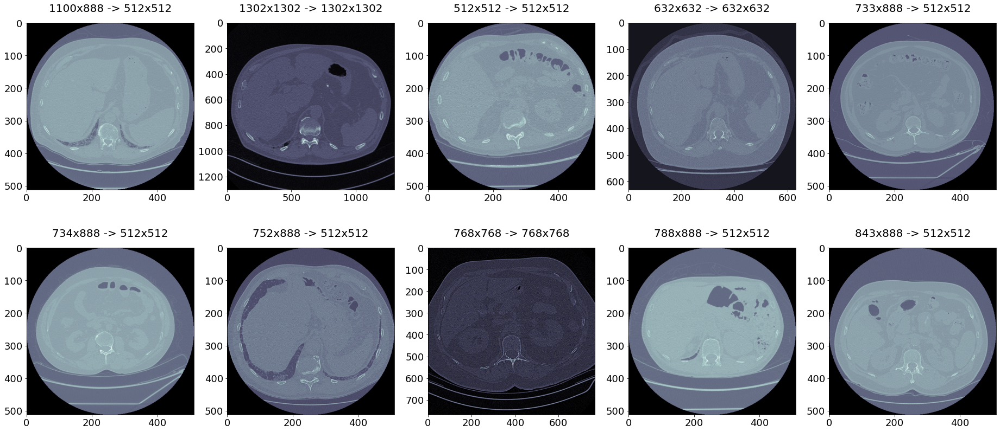

In [30]:
fig, axes = plt.subplots(figsize=(32, 14), nrows=2, ncols=5)

for i, patient_name in enumerate(df_train.groupby('SliceShape')['Patient'].first()):   
    
    patient_directory = [pydicom.dcmread(f'../input/osic-pulmonary-fibrosis-progression/train/{patient_name}/{s}') for s in os.listdir(f'../input/osic-pulmonary-fibrosis-progression/train/{patient_name}')]
    patient_directory.sort(key=lambda s: float(s.ImagePositionPatient[2]))
    first_slice_cropped = crop_slice(patient_directory[0].pixel_array)
    old_aspect_ratio = df_train.groupby("SliceShape")["Patient"].first().index[i]
    new_aspect_ratio = f'{first_slice_cropped.shape[0]}x{first_slice_cropped.shape[1]}'
    
    if i > 4:
        i -= 5
        j = 1
    else:
        j = 0
        
    axes[j][i].imshow(first_slice_cropped, cmap=plt.cm.bone)

    axes[j][i].tick_params(axis='x', labelsize=18)
    axes[j][i].tick_params(axis='y', labelsize=18)
    axes[j][i].set_title(f'{old_aspect_ratio} -> {new_aspect_ratio}', size=20, pad=20)

plt.show()

After the cropping operation, there are only 4 unique slice shapes left and they are `512x512`, `632x632`, `768x768` and `1302x1302`. Those shapes are resized to `512x512` because it is the most common shape in dataset. This process is done with `cv2.resize` and nearest neighbor interpolation is used for preserving the pixel values.

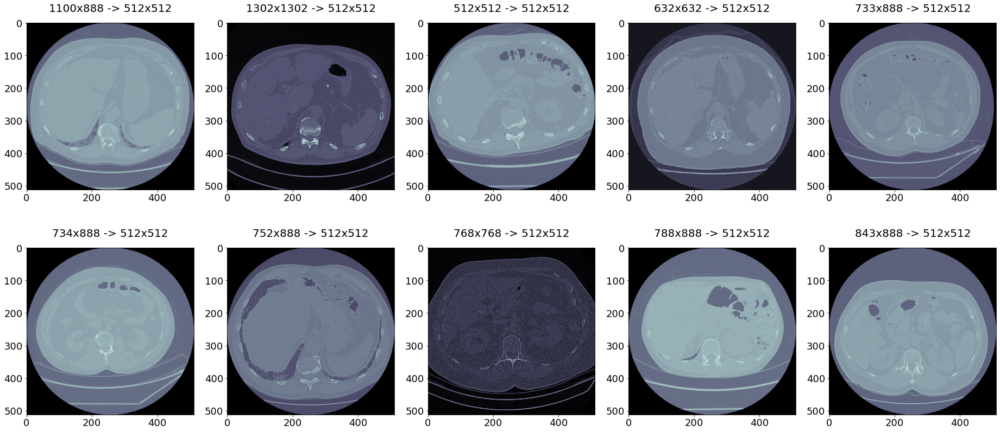

In [31]:
fig, axes = plt.subplots(figsize=(32, 14), nrows=2, ncols=5)

for i, patient_name in enumerate(df_train.groupby('SliceShape')['Patient'].first()):   
    
    patient_directory = [pydicom.dcmread(f'../input/osic-pulmonary-fibrosis-progression/train/{patient_name}/{s}') for s in os.listdir(f'../input/osic-pulmonary-fibrosis-progression/train/{patient_name}')]
    patient_directory.sort(key=lambda s: float(s.ImagePositionPatient[2]))
    first_slice_cropped = crop_slice(patient_directory[0].pixel_array)
    if first_slice_cropped.shape[0] != 512 and first_slice_cropped.shape[1] != 512:
        first_slice_cropped_resized = cv2.resize(first_slice_cropped, (512, 512), interpolation=cv2.INTER_NEAREST)
    else:
        first_slice_cropped_resized = first_slice_cropped
    old_aspect_ratio = df_train.groupby("SliceShape")["Patient"].first().index[i]
    new_aspect_ratio = f'{first_slice_cropped_resized.shape[0]}x{first_slice_cropped_resized.shape[1]}'
    
    if i > 4:
        i -= 5
        j = 1
    else:
        j = 0
        
    axes[j][i].imshow(first_slice_cropped_resized, cmap=plt.cm.bone)

    axes[j][i].tick_params(axis='x', labelsize=18)
    axes[j][i].tick_params(axis='y', labelsize=18)
    axes[j][i].set_title(f'{old_aspect_ratio} -> {new_aspect_ratio}', size=20, pad=20)

plt.show()

### **6.3. Volume Shapes**

`SliceThickness` is the nominal slice thickness in millimeters. There are 15 unique `SliceThickness` values in training set. There are two unusual values which are `0.80000001` and `0.8999999` because all of the other values are multipliers of `0.125`. Those unusual values are rounded to `0.8` and `0.9`. The most common `SliceThickness` values are `1.0` and `1.25`.

`SliceSpacing` is the distance between slices in millimeters. It has more unique values and less unusual values than `SliceThickness`. It should be used for the volume calculation and it shouldn't be mistaken with `SliceThickness`.

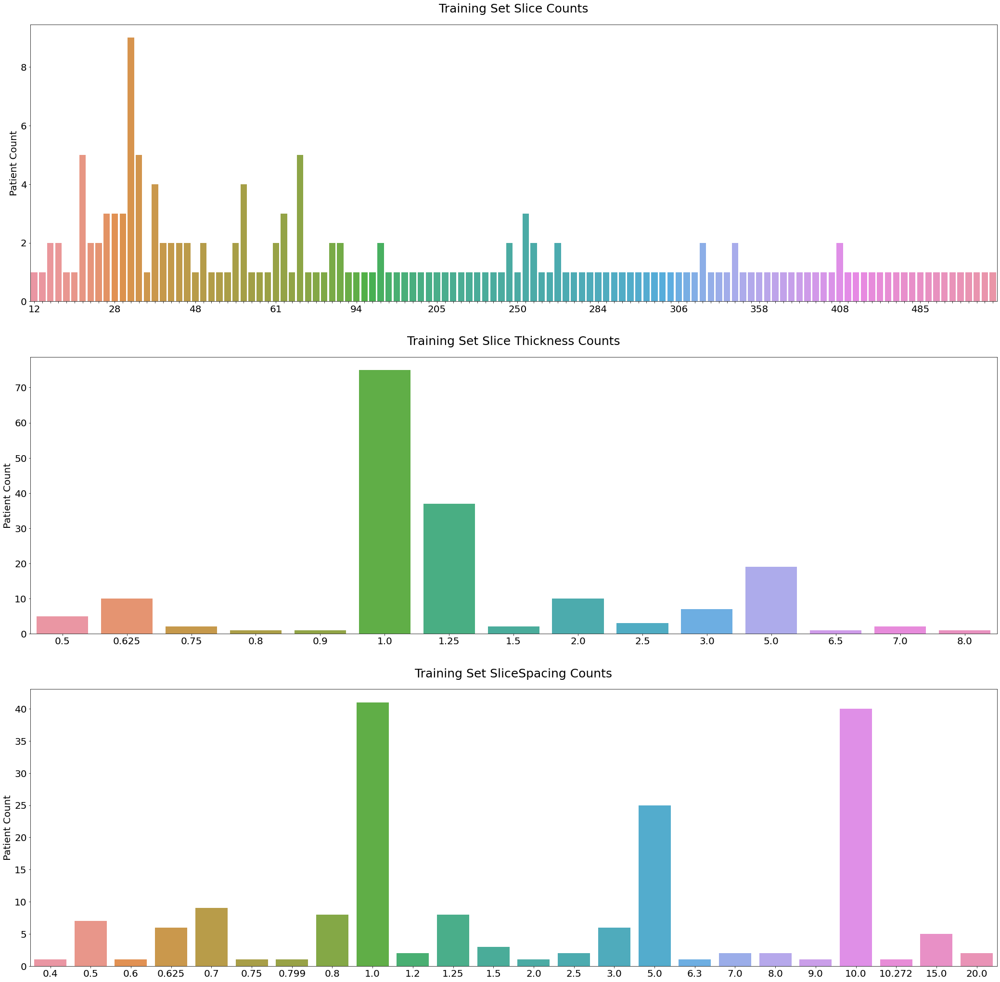

In [32]:
fig, axes = plt.subplots(figsize=(36, 36), nrows=3)

sns.countplot(df_train.groupby('Patient')['Slices'].first(), ax=axes[0])
sns.barplot(y=df_train.groupby('Patient')['SliceThickness'].first().value_counts().values, x=np.round(df_train.groupby('Patient')['SliceThickness'].first().value_counts().index, 4), ax=axes[1])
sns.countplot(df_train.groupby('Patient')['SliceSpacing'].first(), ax=axes[2])

for idx, label in enumerate(axes[0].get_xticklabels()):
    if idx % 10 == 0:
        label.set_visible(True)
    else:
        label.set_visible(False)

for i in range(3):
    axes[i].set_xlabel('')
    axes[i].set_ylabel('Patient Count', size=20)
    if i == 0:
        axes[i].tick_params(axis='x', labelsize=20)
    else:
        axes[i].tick_params(axis='x', labelsize=20)
    
    axes[i].tick_params(axis='y', labelsize=20)
    
axes[0].set_title(f'Training Set Slice Counts', size=25, pad=25)
axes[1].set_title(f'Training Set Slice Thickness Counts', size=25, pad=25)
axes[2].set_title(f'Training Set SliceSpacing Counts', size=25, pad=25)

plt.show()

### **6.4. Volume Calculation**

After the metadata are extracted, volume of the CT scans can be calculated. Features created with segmentation should always be implemented in a normalized unit because shapes of CT scans are different, that's the reason why volume (mm^3) is required.

Volume of a single voxel is calculated with `PixelSpacing X * PixelSpacing Y * SliceSpacing` and voxel count is calculated with `Rows * Columns * Slices`. These two features are enough to calculate volume of selected areas.

In [33]:
df_train['VoxelVolume'] = df_train['PixelSpacingX'] * df_train['PixelSpacingY'] * df_train['SliceSpacing']
df_train['VoxelCount'] = df_train['Rows'].astype(int) * df_train['Columns'].astype(int) * df_train['Slices'].astype(int)

df_train.drop(columns=['SliceShape', 'PixelSpacingX', 'PixelSpacingY', 'SliceSpacing', 'Rows', 'Columns', 'Slices', 'SliceThickness'], inplace=True)

df_train.groupby('Patient').first()[['VoxelVolume', 'VoxelCount']].head(10)

,VoxelVolume,VoxelCount
Patient,,
ID00007637202177411956430,4.251040,7864320
ID00009637202177434476278,0.189735,232390656
ID00010637202177584971671,1.283148,27787264
ID00011637202177653955184,3.364000,8126464
ID00012637202177665765362,2.734375,12845056
ID00014637202177757139317,6.384010,23206104
ID00015637202177877247924,0.217987,173998080
ID00019637202178323708467,3.981610,7602176
ID00020637202178344345685,0.195312,129236992
